# This notebook plots the mean precipitation global map comparisons for multiple trackers
## The data is produced by:
- /src/calc_tbpf_mcs_rainmap_mcsmip.py

In [1]:
import numpy as np
import xarray as xr
import pandas as pd
import glob, os
import matplotlib as mpl
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.gridspec as gridspec
from matplotlib.patches import Polygon
from itertools import chain
import colorcet as cc
import colormath, colormath.color_objects, colormath.color_conversions
from colormath.color_objects import sRGBColor
import urllib
import re
import copy
import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
%matplotlib inline

In [2]:
PHASE = 'Summer'
# PHASE = 'Winter'

rootdir = f'/pscratch/sd/f/feng045/DYAMOND/mcs_stats/{PHASE}/'
dir_PyFLEXTRKR = f'{rootdir}PyFLEXTRKR/'
dir_MOAAP = f'{rootdir}MOAAP/'
dir_TOOCAN = f'{rootdir}TOOCAN/'
dir_tobac = f'{rootdir}tobac/'
dir_TAMS = f'{rootdir}TAMS/'
dir_simpleTrack = f'{rootdir}simpleTrack/'

if PHASE == 'Summer':
    name_map = {
        'obs': 'OBS',
        'm1': 'ARPEGE',
        'm2': 'IFS',
        'm3': 'MPAS',
        'm4': 'NICAM',
        'm5': 'SAM',
        'm6': 'UM',
        'm7': 'FV3',
        'm12': 'SCREAMv1',
    }
if PHASE == 'Winter':
    name_map = {
        'obs': 'OBS',
        'm1': 'ARPEGE',
        'm2': 'IFS',
        'm3': 'MPAS',
        # 'm4': 'NICAM',
        'm5': 'SAM',
        'm6': 'UM',
        'm7': 'GRIST',
        'm8': 'SCREAM',
        'm9': 'XSHiELD',
        'm10': 'GEOS',
        'm11': 'ICON',
        'm12': 'SCREAMv1',
    }
    
# Input filenames
filenames_PyFLEXTRKR = {key:f'{dir_PyFLEXTRKR}mcs_rainmap_{PHASE}_{value}.nc' for key,value in name_map.items()}
filenames_MOAAP = {key:f'{dir_MOAAP}mcs_rainmap_{PHASE}_{value}.nc' for key,value in name_map.items()}
filenames_TOOCAN = {key:f'{dir_TOOCAN}mcs_rainmap_{PHASE}_{value}.nc' for key,value in name_map.items()}
filenames_tobac = {key:f'{dir_tobac}mcs_rainmap_{PHASE}_{value}.nc' for key,value in name_map.items()}
filenames_TAMS = {key:f'{dir_TAMS}mcs_rainmap_{PHASE}_{value}.nc' for key,value in name_map.items()}
filenames_simpleTrack = {key:f'{dir_simpleTrack}mcs_rainmap_{PHASE}_{value}.nc' for key,value in name_map.items()}

topfile = '/global/cfs/cdirs/m1867/zfeng/gpm/map_data/era5_orography.nc'
landmaskfile = '/pscratch/sd/f/feng045/DYAMOND/maps/IMERG_landmask_180W-180E_60S-60N.nc'

figdir = f'/global/cfs/cdirs/m1867/zfeng/MCSMIP/DYAMOND/{PHASE}/figures/MCSMIP/'
os.makedirs(figdir, exist_ok=True)
print(figdir)

/global/cfs/cdirs/m1867/zfeng/MCSMIP/DYAMOND/Summer/figures/MCSMIP/


## Check if input files exist

In [3]:
for key, value in filenames_MOAAP.items():
    print(f'{value}: {os.path.isfile(value)}')

/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/MOAAP/mcs_rainmap_Summer_OBS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/MOAAP/mcs_rainmap_Summer_ARPEGE.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/MOAAP/mcs_rainmap_Summer_IFS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/MOAAP/mcs_rainmap_Summer_MPAS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/MOAAP/mcs_rainmap_Summer_NICAM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/MOAAP/mcs_rainmap_Summer_SAM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/MOAAP/mcs_rainmap_Summer_UM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/MOAAP/mcs_rainmap_Summer_FV3.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/MOAAP/mcs_rainmap_Summer_SCREAMv1.nc: True


In [4]:
for key, value in filenames_PyFLEXTRKR.items():
    print(f'{value}: {os.path.isfile(value)}')

/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/PyFLEXTRKR/mcs_rainmap_Summer_OBS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/PyFLEXTRKR/mcs_rainmap_Summer_ARPEGE.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/PyFLEXTRKR/mcs_rainmap_Summer_IFS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/PyFLEXTRKR/mcs_rainmap_Summer_MPAS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/PyFLEXTRKR/mcs_rainmap_Summer_NICAM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/PyFLEXTRKR/mcs_rainmap_Summer_SAM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/PyFLEXTRKR/mcs_rainmap_Summer_UM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/PyFLEXTRKR/mcs_rainmap_Summer_FV3.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/PyFLEXTRKR/mcs_rainmap_Summer_SCREAMv1.nc: True


In [5]:
for key, value in filenames_TOOCAN.items():
    print(f'{value}: {os.path.isfile(value)}')

/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TOOCAN/mcs_rainmap_Summer_OBS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TOOCAN/mcs_rainmap_Summer_ARPEGE.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TOOCAN/mcs_rainmap_Summer_IFS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TOOCAN/mcs_rainmap_Summer_MPAS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TOOCAN/mcs_rainmap_Summer_NICAM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TOOCAN/mcs_rainmap_Summer_SAM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TOOCAN/mcs_rainmap_Summer_UM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TOOCAN/mcs_rainmap_Summer_FV3.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TOOCAN/mcs_rainmap_Summer_SCREAMv1.nc: True


In [6]:
for key, value in filenames_tobac.items():
    print(f'{value}: {os.path.isfile(value)}')

/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/tobac/mcs_rainmap_Summer_OBS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/tobac/mcs_rainmap_Summer_ARPEGE.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/tobac/mcs_rainmap_Summer_IFS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/tobac/mcs_rainmap_Summer_MPAS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/tobac/mcs_rainmap_Summer_NICAM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/tobac/mcs_rainmap_Summer_SAM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/tobac/mcs_rainmap_Summer_UM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/tobac/mcs_rainmap_Summer_FV3.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/tobac/mcs_rainmap_Summer_SCREAMv1.nc: True


In [7]:
for key, value in filenames_TAMS.items():
    print(f'{value}: {os.path.isfile(value)}')

/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TAMS/mcs_rainmap_Summer_OBS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TAMS/mcs_rainmap_Summer_ARPEGE.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TAMS/mcs_rainmap_Summer_IFS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TAMS/mcs_rainmap_Summer_MPAS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TAMS/mcs_rainmap_Summer_NICAM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TAMS/mcs_rainmap_Summer_SAM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TAMS/mcs_rainmap_Summer_UM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TAMS/mcs_rainmap_Summer_FV3.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/TAMS/mcs_rainmap_Summer_SCREAMv1.nc: True


In [8]:
for key, value in filenames_simpleTrack.items():
    print(f'{value}: {os.path.isfile(value)}')

/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/simpleTrack/mcs_rainmap_Summer_OBS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/simpleTrack/mcs_rainmap_Summer_ARPEGE.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/simpleTrack/mcs_rainmap_Summer_IFS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/simpleTrack/mcs_rainmap_Summer_MPAS.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/simpleTrack/mcs_rainmap_Summer_NICAM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/simpleTrack/mcs_rainmap_Summer_SAM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/simpleTrack/mcs_rainmap_Summer_UM.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/simpleTrack/mcs_rainmap_Summer_FV3.nc: True
/pscratch/sd/f/feng045/DYAMOND/mcs_stats/Summer/simpleTrack/mcs_rainmap_Summer_SCREAMv1.nc: True


# These customed functions enables use of [NCL colormaps](https://www.ncl.ucar.edu/Document/Graphics/color_table_gallery.shtml)

In [9]:
color_obj_dict = {'sRGB':colormath.color_objects.sRGBColor,
                  'HSV':colormath.color_objects.HSVColor,
                  'Lab':colormath.color_objects.LabColor,
                  'LCHuv':colormath.color_objects.LCHuvColor,
                  'LCHab':colormath.color_objects.LCHabColor,
                  'XYZ':colormath.color_objects.XYZColor}

def __rgb_to_array(rgb_color):
    r = np.minimum(1, round(rgb_color.rgb_r*10000)/10000)
    g = np.minimum(1, round(rgb_color.rgb_g*10000)/10000)
    b = np.minimum(1, round(rgb_color.rgb_b*10000)/10000)
    return r,g,b


def create_palette(start_rgb, end_rgb, n, colorspace):
    # convert start and end to a point in the given colorspace
    start = colormath.color_conversions.convert_color(start_rgb, colorspace).get_value_tuple()
    end = colormath.color_conversions.convert_color(end_rgb, colorspace).get_value_tuple()

    # create a set of n points along start to end
    points = list(zip(*[np.linspace(start[i], end[i], n) for i in range(3)]))

    # create a color for each point and convert back to rgb
    rgb_colors = [colormath.color_conversions.convert_color(colorspace(*point), sRGBColor) for point in points]

    # finally convert rgb colors back to hex
    return [__rgb_to_array(color) for color in  rgb_colors]


def __retrive_NCL_webcontent(cmapname):
    target_url = 'https://www.ncl.ucar.edu/Document/Graphics/ColorTables/Files/%s.rgb' % cmapname
    request = urllib.request.urlopen(target_url)
    return request


def __collect_discrete_NCL_cmap(cmapname):
    rawdata = __retrive_NCL_webcontent(cmapname)
    
    cmap_color_list = list()
    
    color_section_sig = 0
    
    for line in rawdata:
        
        line_decode = line.decode('utf-8')
        info = re.split('\s+', line_decode.replace('\n','').replace('^\s+',''))

        if color_section_sig==1:
            if info[0]=='' and len(info)>=3:
                if np.maximum(np.maximum(float(info[1]), float(info[2])), float(info[3]))>1:
                    cmap_color_list.append((float(info[1])/255, float(info[2])/255, float(info[3])/255))
                else:
                    cmap_color_list.append((float(info[1]), float(info[2]), float(info[3])))
            if len(info)==3:
                if ';' in info[0] or '#' in info[0]:
                    whatisthis = 's'
                else:
                    if np.maximum(np.maximum(float(info[0]), float(info[1])), float(info[2]))>1:
                        cmap_color_list.append((float(info[0])/255, float(info[1])/255, float(info[2])/255))
                    else:
                        cmap_color_list.append((float(info[0]), float(info[1]), float(info[2])))
        
        if 'ncolors' in str(info[0]):
            color_section_sig = 1  # meaning now we are at color lines (or "r g b" line)

    return cmap_color_list


def __cmap_refinement(raw_cmap_rgb, n_interpolate=10, workspace=color_obj_dict['sRGB']):
    # workspace:  choose which color space the refinement is conducted.
    #             refer to https://stackoverflow.com/questions/55032648/given-a-start-color-and-a-middle-color-how-to-get-the-remaining-colors-python

    n_in = len(raw_cmap_rgb)

    new_array = list()

    for i in np.arange(n_in-1):
        out_colors = create_palette(sRGBColor(*raw_cmap_rgb[i], is_upscaled=False), sRGBColor(*raw_cmap_rgb[i+1], is_upscaled=False), n_interpolate+1, workspace)
        for j in np.arange(len(out_colors)-1):
            new_array.append(out_colors[j])

    return new_array


def generate_NCL_cmap(cmapname, cont_opt=False, cont_param_n=10, cont_param_ws='sRGB',
                      white_first=False, white_ext=False, reverse_cmap=False):
    # description:
    #     cmapname:      taken as shown on the NCL website
    #     cont_opt:      to convert the discreate colormap to continuous colormap
    #     cont_param_n:  how many "intermediate" colors to be inserted to the nearby discreate colors
    #     cont_param_ws: color space to conduct interploation. Default to "sRGB", which should work for most cases
    #     white_first:   whether to set the first color as white. May be useful if the minimum does not mean anything
    #     white_ext:     whether to add this above white as an extended color (when set to True), or just replace the first color (when set to False).
    #     reverse_cmap:  similar to "_r" in colormap.
    # note:  reverse_cmap is applied first, then white_first option.

    cmap_discrete_raw = __collect_discrete_NCL_cmap(cmapname)

    if reverse_cmap==True:
        cmap_discrete_raw.reverse()

    if white_first==True:
        if white_ext==True:
            cmap_discrete = list()
            cmap_discrete.append((1,1,1))
            for i in np.arange(len(cmap_discrete_raw)):
                cmap_discrete.append(cmap_discrete_raw[int(i)])
        else:
            cmap_discrete = cmap_discrete_raw.copy()
        cmap_discrete[0] = (1,1,1)
    else:
        cmap_discrete = cmap_discrete_raw

    if cont_opt==False:
        out_cmap = cmap_discrete

    if cont_opt==True:
        out_cmap = __cmap_refinement(cmap_discrete, n_interpolate=cont_param_n, workspace=color_obj_dict[cont_param_ws])

    return mpl.colors.ListedColormap(out_cmap)

def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=256):
    """ Truncate colormap.
    """
    new_cmap = mpl.colors.LinearSegmentedColormap.from_list(
        'trunc({n},{a:.2f},{b:.2f})'.format(n=cmap.name, a=minval, b=maxval),
        cmap(np.linspace(minval, maxval, n)))
    return new_cmap

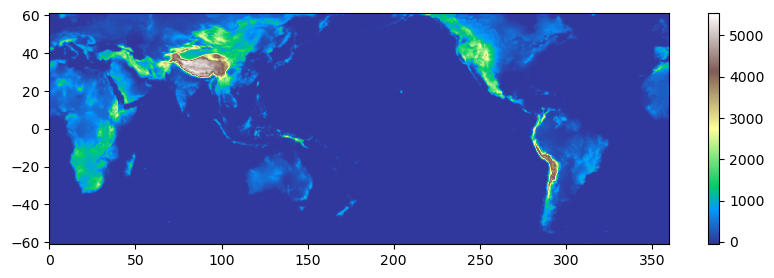

In [10]:
# Read topography data
dstop = xr.open_dataset(topfile)
# Convert surface geopotential to height in meters
ter = dstop.z.sel(latitude=slice(61,-61)).squeeze() / 9.80665
ter_s = gaussian_filter(ter, 1)
lon_ter = dstop.longitude
lat_ter = dstop.latitude.sel(latitude=slice(61,-61))

fig = plt.figure(figsize=[10,3], dpi=100)
plt.pcolormesh(lon_ter, lat_ter, ter_s, cmap='terrain')
plt.colorbar()

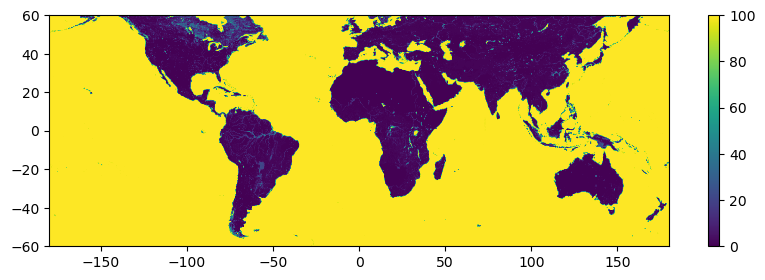

In [11]:
# Read landmask data
dslm = xr.open_dataset(landmaskfile)
lon_lm = dslm['lon']
lat_lm = dslm['lat']
# dslm = dslm.assign_coords(lon=lon_obs)
# dslm = dslm.assign_coords(lat=lat_obs)
# if PHASE == 'Winter':
#     dslm = dslm.roll(lon=1800, roll_coords=True)
#     dslm = dslm.assign_coords(lon=lon_obs)
#     dslm = dslm.assign_coords(lat=lat_obs)
    
landmask = dslm.landseamask
fig = plt.figure(figsize=[10,3], dpi=100)
plt.pcolormesh(lon_lm, lat_lm, landmask)
plt.colorbar()

## Read and combine all sources to a single DataSet

In [12]:
drop_vars = ['latitude', 'longitude', 'lat', 'lon']
# Read all files and combine them with a new dimension 'source'
ds_pyflex = xr.open_mfdataset(list(filenames_PyFLEXTRKR.values()), combine='nested', concat_dim='source', drop_variables=drop_vars).squeeze()
# Assign new coordinate 'source' using name_map dictionary keys
ds_pyflex['source'] = list(name_map.keys())
# Assign lat/lon coordinate from landmask
ds_pyflex = ds_pyflex.assign_coords({'lon': lon_lm, 'lat': lat_lm})
ds_pyflex

<xarray.Dataset>
Dimensions:                  (source: 9, lat: 1200, lon: 3600)
Coordinates:
    time                     datetime64[ns] 2016-08-10
  * source                   (source) <U3 'obs' 'm1' 'm2' ... 'm6' 'm7' 'm12'
  * lon                      (lon) float64 -179.9 -179.8 -179.8 ... 179.8 179.9
  * lat                      (lat) float64 -59.95 -59.85 -59.75 ... 59.85 59.95
Data variables:
    precipitation            (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_precipitation        (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_precipitation_count  (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_cloud_count          (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    ntimes                   (source) float32 dask.array<chunksize=(1,), meta=np.ndarray>
Attributes:
    Title:       MCS precipitation accumulation
    phase:       Summer
    tracker:     PyFLEXTRKR
    contact:     Zhe Feng, zhe.feng@pnnl.gov
    start_date:  2016-08-10T00
    end_date:    2016-09-10T00
    created_on:  Mon Nov  6 13:46:23 2023

In [13]:
# Read all files and combine them with a new dimension 'source'
ds_moaap = xr.open_mfdataset(list(filenames_MOAAP.values()), combine='nested', concat_dim='source', drop_variables=drop_vars).squeeze()
# Assign new coordinate 'source' using name_map dictionary keys
ds_moaap['source'] = list(name_map.keys())
# Assign lat/lon coordinate from landmask
ds_moaap = ds_moaap.assign_coords({'lon': lon_lm, 'lat': lat_lm})
ds_moaap

<xarray.Dataset>
Dimensions:                  (source: 9, lat: 1200, lon: 3600)
Coordinates:
    time                     datetime64[ns] 2016-08-10
  * source                   (source) <U3 'obs' 'm1' 'm2' ... 'm6' 'm7' 'm12'
  * lon                      (lon) float64 -179.9 -179.8 -179.8 ... 179.8 179.9
  * lat                      (lat) float64 -59.95 -59.85 -59.75 ... 59.85 59.95
Data variables:
    precipitation            (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_precipitation        (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_precipitation_count  (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_cloud_count          (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    ntimes                   (source) float32 dask.array<chunksize=(1,), meta=np.ndarray>
Attributes:
    Title:       MCS precipitation accumulation
    phase:       Summer
    tracker:     MOAAP
    contact:     Zhe Feng, zhe.feng@pnnl.gov
    start_date:  2016-08-10T00
    end_date:    2016-09-10T00
    created_on:  Tue Apr 23 17:12:23 2024

In [14]:
# Read all files and combine them with a new dimension 'source'
ds_toocan = xr.open_mfdataset(list(filenames_TOOCAN.values()), combine='nested', concat_dim='source', drop_variables=drop_vars).squeeze()
# Assign new coordinate 'source' using name_map dictionary keys
ds_toocan['source'] = list(name_map.keys())
# Assign lat/lon coordinate from landmask
ds_toocan = ds_toocan.assign_coords({'lon': lon_lm, 'lat': lat_lm})
ds_toocan

<xarray.Dataset>
Dimensions:                  (source: 9, lat: 1200, lon: 3600)
Coordinates:
    time                     datetime64[ns] 2016-08-10
  * source                   (source) <U3 'obs' 'm1' 'm2' ... 'm6' 'm7' 'm12'
  * lon                      (lon) float64 -179.9 -179.8 -179.8 ... 179.8 179.9
  * lat                      (lat) float64 -59.95 -59.85 -59.75 ... 59.85 59.95
Data variables:
    precipitation            (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_precipitation        (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_precipitation_count  (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_cloud_count          (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    ntimes                   (source) float32 dask.array<chunksize=(1,), meta=np.ndarray>
Attributes:
    title:       MCS precipitation accumulation from TOOCAN
    contact:     Zhe Feng, zhe.feng@pnnl.gov
    start_date:  20160810
    end_date:    20160910
    created_on:  Thu Nov  2 18:34:31 2023

In [15]:
# Read all files and combine them with a new dimension 'source'
ds_tobac = xr.open_mfdataset(list(filenames_tobac.values()), combine='nested', concat_dim='source', drop_variables=drop_vars).squeeze()
# Assign new coordinate 'source' using name_map dictionary keys
ds_tobac['source'] = list(name_map.keys())
# Assign lat/lon coordinate from landmask
ds_tobac = ds_tobac.assign_coords({'lon': lon_lm, 'lat': lat_lm})
ds_tobac

<xarray.Dataset>
Dimensions:                  (source: 9, lat: 1200, lon: 3600)
Coordinates:
    time                     datetime64[ns] 2016-08-10
  * source                   (source) <U3 'obs' 'm1' 'm2' ... 'm6' 'm7' 'm12'
  * lon                      (lon) float64 -179.9 -179.8 -179.8 ... 179.8 179.9
  * lat                      (lat) float64 -59.95 -59.85 -59.75 ... 59.85 59.95
Data variables:
    precipitation            (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_precipitation        (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_precipitation_count  (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_cloud_count          (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    ntimes                   (source) float32 dask.array<chunksize=(1,), meta=np.ndarray>
Attributes:
    Title:       MCS precipitation accumulation
    phase:       Summer
    tracker:     tobac
    contact:     Zhe Feng, zhe.feng@pnnl.gov
    start_date:  2016-08-10T00
    end_date:    2016-09-10T00
    created_on:  Fri May  3 19:56:41 2024

In [16]:
# Read all files and combine them with a new dimension 'source'
ds_tams = xr.open_mfdataset(list(filenames_TAMS.values()), combine='nested', concat_dim='source', drop_variables=drop_vars).squeeze()
# Assign new coordinate 'source' using name_map dictionary keys
ds_tams['source'] = list(name_map.keys())
# Assign lat/lon coordinate from landmask
ds_tams = ds_tams.assign_coords({'lon': lon_lm, 'lat': lat_lm})
ds_tams

<xarray.Dataset>
Dimensions:                  (source: 9, lat: 1200, lon: 3600)
Coordinates:
    time                     datetime64[ns] 2016-08-10
  * source                   (source) <U3 'obs' 'm1' 'm2' ... 'm6' 'm7' 'm12'
  * lon                      (lon) float64 -179.9 -179.8 -179.8 ... 179.8 179.9
  * lat                      (lat) float64 -59.95 -59.85 -59.75 ... 59.85 59.95
Data variables:
    precipitation            (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_precipitation        (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_precipitation_count  (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_cloud_count          (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    ntimes                   (source) float32 dask.array<chunksize=(1,), meta=np.ndarray>
Attributes:
    Title:       MCS precipitation accumulation
    phase:       Summer
    tracker:     TAMS
    contact:     Zhe Feng, zhe.feng@pnnl.gov
    start_date:  2016-08-10T00
    end_date:    2016-09-10T00
    created_on:  Tue Dec 26 16:13:03 2023

In [17]:
# Read all files and combine them with a new dimension 'source'
ds_simtrack = xr.open_mfdataset(list(filenames_simpleTrack.values()), combine='nested', concat_dim='source', drop_variables=drop_vars).squeeze()
# Assign new coordinate 'source' using name_map dictionary keys
ds_simtrack['source'] = list(name_map.keys())
# Assign lat/lon coordinate from landmask
ds_simtrack = ds_simtrack.assign_coords({'lon': lon_lm, 'lat': lat_lm})
ds_simtrack

<xarray.Dataset>
Dimensions:                  (source: 9, lat: 1200, lon: 3600)
Coordinates:
    time                     datetime64[ns] 2016-08-10
  * source                   (source) <U3 'obs' 'm1' 'm2' ... 'm6' 'm7' 'm12'
  * lon                      (lon) float64 -179.9 -179.8 -179.8 ... 179.8 179.9
  * lat                      (lat) float64 -59.95 -59.85 -59.75 ... 59.85 59.95
Data variables:
    precipitation            (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_precipitation        (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_precipitation_count  (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    mcs_cloud_count          (source, lat, lon) float32 dask.array<chunksize=(1, 1200, 3600), meta=np.ndarray>
    ntimes                   (source) float32 dask.array<chunksize=(1,), meta=np.ndarray>
Attributes:
    Title:       MCS precipitation accumulation
    phase:       Summer
    tracker:     simpleTrack
    contact:     Zhe Feng, zhe.feng@pnnl.gov
    start_date:  2016-08-10T00
    end_date:    2016-09-10T00
    created_on:  Wed Jan  3 22:35:41 2024

## Calculate statistics

In [18]:
# Total number of hours
nhours_pyflex = ds_pyflex.ntimes
# nhours_pyflex.values
print(f'Number of total hours (PyFLEXTRKR)')
for key in name_map.keys():
    print(f'{name_map[key]}: {int(nhours_pyflex.sel(source=key).values.item())}')
# Precipitation amount [mm], divided by total number of hours to get [mm/h]
# then x24 to get [mm/day]
totpcp_pyflex = 24. * ds_pyflex.precipitation / nhours_pyflex
mcspcp_pyflex = 24. * ds_pyflex.mcs_precipitation / nhours_pyflex
nonmcspcp_pyflex = totpcp_pyflex - mcspcp_pyflex
# MCS precipitation fraction
mcspcpfrac_pyflex = 100 * mcspcp_pyflex / totpcp_pyflex

# Number of hours with MCS precipitation/cloud
mcspcphours_pyflex = ds_pyflex.mcs_precipitation_count
mcscloudhours_pyflex = ds_pyflex.mcs_cloud_count
# MCS precipitation mean intensity (conditional mean)
mcspcpmeanintensity_pyflex = ds_pyflex.mcs_precipitation / mcspcphours_pyflex

# MCS precipitation frequency
mcspcpfreq_pyflex = 100 * (mcspcphours_pyflex / nhours_pyflex)
mcscloudfreq_pyflex = 100 * (mcscloudhours_pyflex / nhours_pyflex)

Number of total hours (PyFLEXTRKR)
OBS: 744
ARPEGE: 744
IFS: 744
MPAS: 745
NICAM: 744
SAM: 744
UM: 744
FV3: 744
SCREAMv1: 744


In [19]:
# Total number of hours
nhours_moaap = ds_moaap.ntimes
# nhours_moaap.values
print(f'Number of total hours (MOAAP)')
for key in name_map.keys():
    print(f'{name_map[key]}: {int(nhours_moaap.sel(source=key).values.item())}')
# Precipitation amount [mm], divided by total number of hours to get [mm/h]
# then x24 to get [mm/day]
totpcp_moaap = 24. * ds_moaap.precipitation / nhours_moaap
mcspcp_moaap = 24. * ds_moaap.mcs_precipitation / nhours_moaap
nonmcspcp_moaap = totpcp_moaap - mcspcp_moaap
# MCS precipitation fraction
mcspcpfrac_moaap = 100 * mcspcp_moaap / totpcp_moaap

# Number of hours with MCS precipitation/cloud
mcspcphours_moaap = ds_moaap.mcs_precipitation_count
mcscloudhours_moaap = ds_moaap.mcs_cloud_count
# MCS precipitation mean intensity (conditional mean)
mcspcpmeanintensity_moaap = ds_moaap.mcs_precipitation / mcspcphours_moaap

# MCS precipitation frequency
mcspcpfreq_moaap = 100 * (mcspcphours_moaap / nhours_moaap)
mcscloudfreq_moaap = 100 * (mcscloudhours_moaap / nhours_moaap)

Number of total hours (MOAAP)
OBS: 744
ARPEGE: 744
IFS: 744
MPAS: 745
NICAM: 744
SAM: 744
UM: 744
FV3: 744
SCREAMv1: 744


In [20]:
# Total number of hours
nhours_toocan = ds_toocan.ntimes
# nhours_toocan.values
print(f'Number of total hours (TOOCAN)')
for key in name_map.keys():
    print(f'{name_map[key]}: {int(nhours_toocan.sel(source=key).values.item())}')
# Precipitation amount [mm], divided by total number of hours to get [mm/h]
# then x24 to get [mm/day]
totpcp_toocan = 24. * ds_toocan.precipitation / nhours_toocan
mcspcp_toocan = 24. * ds_toocan.mcs_precipitation / nhours_toocan
nonmcspcp_toocan = totpcp_toocan - mcspcp_toocan
# MCS precipitation fraction
mcspcpfrac_toocan = 100 * mcspcp_toocan / totpcp_toocan

# Number of hours with MCS precipitation/cloud
mcspcphours_toocan = ds_toocan.mcs_precipitation_count
mcscloudhours_toocan = ds_toocan.mcs_cloud_count
# MCS precipitation mean intensity (conditional mean)
mcspcpmeanintensity_toocan = ds_toocan.mcs_precipitation / mcspcphours_toocan

# MCS precipitation frequency
mcspcpfreq_toocan = 100 * (mcspcphours_toocan / nhours_toocan)
mcscloudfreq_toocan = 100 * (mcscloudhours_toocan / nhours_toocan)

Number of total hours (TOOCAN)
OBS: 743
ARPEGE: 744
IFS: 744
MPAS: 745
NICAM: 744
SAM: 744
UM: 744
FV3: 744
SCREAMv1: 744


In [21]:
# Total number of hours
nhours_tobac = ds_tobac.ntimes
# nhours_tobac.values
print(f'Number of total hours (tobac)')
for key in name_map.keys():
    print(f'{name_map[key]}: {int(nhours_tobac.sel(source=key).values.item())}')
# Precipitation amount [mm], divided by total number of hours to get [mm/h]
# then x24 to get [mm/day]
totpcp_tobac = 24. * ds_tobac.precipitation / nhours_tobac
mcspcp_tobac = 24. * ds_tobac.mcs_precipitation / nhours_tobac
nonmcspcp_tobac = totpcp_tobac - mcspcp_tobac
# MCS precipitation fraction
mcspcpfrac_tobac = 100 * mcspcp_tobac / totpcp_tobac

# Number of hours with MCS precipitation/cloud
mcspcphours_tobac = ds_tobac.mcs_precipitation_count
mcscloudhours_tobac = ds_tobac.mcs_cloud_count
# MCS precipitation mean intensity (conditional mean)
mcspcpmeanintensity_tobac = ds_tobac.mcs_precipitation / mcspcphours_tobac

# MCS precipitation frequency
mcspcpfreq_tobac = 100 * (mcspcphours_tobac / nhours_tobac)
mcscloudfreq_tobac = 100 * (mcscloudhours_tobac / nhours_tobac)

Number of total hours (tobac)
OBS: 744
ARPEGE: 744
IFS: 744
MPAS: 745
NICAM: 744
SAM: 744
UM: 744
FV3: 744
SCREAMv1: 744


In [22]:
# Total number of hours
nhours_tams = ds_tams.ntimes
# nhours_tams.values
print(f'Number of total hours (TAMS)')
for key in name_map.keys():
    print(f'{name_map[key]}: {int(nhours_tams.sel(source=key).values.item())}')
# Precipitation amount [mm], divided by total number of hours to get [mm/h]
# then x24 to get [mm/day]
totpcp_tams = 24. * ds_tams.precipitation / nhours_tams
mcspcp_tams = 24. * ds_tams.mcs_precipitation / nhours_tams
nonmcspcp_tams = totpcp_tams - mcspcp_tams
# MCS precipitation fraction
mcspcpfrac_tams = 100 * mcspcp_tams / totpcp_tams

# Number of hours with MCS precipitation/cloud
mcspcphours_tams = ds_tams.mcs_precipitation_count
mcscloudhours_tams = ds_tams.mcs_cloud_count
# MCS precipitation mean intensity (conditional mean)
mcspcpmeanintensity_tams = ds_tams.mcs_precipitation / mcspcphours_tams

# MCS precipitation frequency
mcspcpfreq_tams = 100 * (mcspcphours_tams / nhours_tams)
mcscloudfreq_tams = 100 * (mcscloudhours_tams / nhours_tams)

Number of total hours (TAMS)
OBS: 744
ARPEGE: 744
IFS: 744
MPAS: 745
NICAM: 744
SAM: 744
UM: 744
FV3: 744
SCREAMv1: 744


In [23]:
# Total number of hours
nhours_simtrack = ds_simtrack.ntimes
# nhours_simtrack.values
print(f'Number of total hours (simpleTrack)')
for key in name_map.keys():
    print(f'{name_map[key]}: {int(nhours_simtrack.sel(source=key).values.item())}')
# Precipitation amount [mm], divided by total number of hours to get [mm/h]
# then x24 to get [mm/day]
totpcp_simtrack = 24. * ds_simtrack.precipitation / nhours_simtrack
mcspcp_simtrack = 24. * ds_simtrack.mcs_precipitation / nhours_simtrack
nonmcspcp_simtrack = totpcp_simtrack - mcspcp_simtrack
# MCS precipitation fraction
mcspcpfrac_simtrack = 100 * mcspcp_simtrack / totpcp_simtrack

# Number of hours with MCS precipitation/cloud
mcspcphours_simtrack = ds_simtrack.mcs_precipitation_count
mcscloudhours_simtrack = ds_simtrack.mcs_cloud_count
# MCS precipitation mean intensity (conditional mean)
mcspcpmeanintensity_simtrack = ds_simtrack.mcs_precipitation / mcspcphours_simtrack

# MCS precipitation frequency
mcspcpfreq_simtrack = 100 * (mcspcphours_simtrack / nhours_simtrack)
mcscloudfreq_simtrack = 100 * (mcscloudhours_simtrack / nhours_simtrack)

Number of total hours (simpleTrack)
OBS: 744
ARPEGE: 744
IFS: 744
MPAS: 745
NICAM: 744
SAM: 744
UM: 744
FV3: 744
SCREAMv1: 744


In [24]:
def get_obs_model_diff(da):
    """
    Get obs, models & calculate their differences
    
    Args:
        da: DataArray
            DataArray containing multiple sources (including 'obs' & models)
            
    Returns:
        da_obs: DataArray
            DataArray containing observation
        da_mod: DataArray
            DataArray containing models
        da_diff: DataArray
            DataArray containing differences    
    """
    # Select non-obs sources (models) & obs
    da_mod = da.isel(source=da['source'] != 'obs').squeeze()
    da_obs = da.sel(source='obs').squeeze()
    # Compute the difference (model - obs)
    da_diff = da_mod - da_obs
    return (da_obs, da_mod, da_diff)

## Calculate model vs. obs differences

In [25]:
# Get obs, models, & differences
totpcp_obs_pyflex, totpcp_mod_pyflex, totpcp_diff_pyflex = get_obs_model_diff(totpcp_pyflex)
mcspcp_obs_pyflex, mcspcp_mod_pyflex, mcspcp_diff_pyflex = get_obs_model_diff(mcspcp_pyflex)
mcspcpmeanintensity_obs_pyflex, mcspcpmeanintensity_mod_pyflex, mcspcpmeanintensity_diff_pyflex = get_obs_model_diff(mcspcpmeanintensity_pyflex)
mcspcpfrac_obs_pyflex, mcspcpfrac_mod_pyflex, mcspcpfrac_diff_pyflex = get_obs_model_diff(mcspcpfrac_pyflex)

# MCS precipitation / cloud frequency
mcspcpfreq_obs_pyflex, mcspcpfreq_mod_pyflex, mcspcpfreq_diff_pyflex = get_obs_model_diff(mcspcpfreq_pyflex)
mcscloudfreq_obs_pyflex, mcscloudfreq_mod_pyflex, mcscloudfreq_diff_pyflex = get_obs_model_diff(mcscloudfreq_pyflex)

# MCS precipitation / cloud hours
mcspcphours_obs_pyflex, mcspcphours_mod_pyflex, mcspcphours_diff_pyflex = get_obs_model_diff(mcspcphours_pyflex)
mcscloudhours_obs_pyflex, mcscloudhours_mod_pyflex, mcscloudhours_diff_pyflex = get_obs_model_diff(mcscloudhours_pyflex)

In [26]:
# Get obs, models, & differences
totpcp_obs_moaap, totpcp_mod_moaap, totpcp_diff_moaap = get_obs_model_diff(totpcp_moaap)
mcspcp_obs_moaap, mcspcp_mod_moaap, mcspcp_diff_moaap = get_obs_model_diff(mcspcp_moaap)
mcspcpmeanintensity_obs_moaap, mcspcpmeanintensity_mod_moaap, mcspcpmeanintensity_diff_moaap = get_obs_model_diff(mcspcpmeanintensity_moaap)
mcspcpfrac_obs_moaap, mcspcpfrac_mod_moaap, mcspcpfrac_diff_moaap = get_obs_model_diff(mcspcpfrac_moaap)

# MCS precipitation / cloud frequency
mcspcpfreq_obs_moaap, mcspcpfreq_mod_moaap, mcspcpfreq_diff_moaap = get_obs_model_diff(mcspcpfreq_moaap)
mcscloudfreq_obs_moaap, mcscloudfreq_mod_moaap, mcscloudfreq_diff_moaap = get_obs_model_diff(mcscloudfreq_moaap)

# MCS precipitation / cloud hours
mcspcphours_obs_moaap, mcspcphours_mod_moaap, mcspcphours_diff_moaap = get_obs_model_diff(mcspcphours_moaap)
mcscloudhours_obs_moaap, mcscloudhours_mod_moaap, mcscloudhours_diff_moaap = get_obs_model_diff(mcscloudhours_moaap)

In [27]:
# Get obs, models, & differences
totpcp_obs_toocan, totpcp_mod_toocan, totpcp_diff_toocan = get_obs_model_diff(totpcp_toocan)
mcspcp_obs_toocan, mcspcp_mod_toocan, mcspcp_diff_toocan = get_obs_model_diff(mcspcp_toocan)
mcspcpmeanintensity_obs_toocan, mcspcpmeanintensity_mod_toocan, mcspcpmeanintensity_diff_toocan = get_obs_model_diff(mcspcpmeanintensity_toocan)
mcspcpfrac_obs_toocan, mcspcpfrac_mod_toocan, mcspcpfrac_diff_toocan = get_obs_model_diff(mcspcpfrac_toocan)

# MCS precipitation / cloud frequency
mcspcpfreq_obs_toocan, mcspcpfreq_mod_toocan, mcspcpfreq_diff_toocan = get_obs_model_diff(mcspcpfreq_toocan)
mcscloudfreq_obs_toocan, mcscloudfreq_mod_toocan, mcscloudfreq_diff_toocan = get_obs_model_diff(mcscloudfreq_toocan)

# MCS precipitation / cloud hours
mcspcphours_obs_toocan, mcspcphours_mod_toocan, mcspcphours_diff_toocan = get_obs_model_diff(mcspcphours_toocan)
mcscloudhours_obs_toocan, mcscloudhours_mod_toocan, mcscloudhours_diff_toocan = get_obs_model_diff(mcscloudhours_toocan)

In [28]:
# Get obs, models, & differences
totpcp_obs_tobac, totpcp_mod_tobac, totpcp_diff_tobac = get_obs_model_diff(totpcp_tobac)
mcspcp_obs_tobac, mcspcp_mod_tobac, mcspcp_diff_tobac = get_obs_model_diff(mcspcp_tobac)
mcspcpmeanintensity_obs_tobac, mcspcpmeanintensity_mod_tobac, mcspcpmeanintensity_diff_tobac = get_obs_model_diff(mcspcpmeanintensity_tobac)
mcspcpfrac_obs_tobac, mcspcpfrac_mod_tobac, mcspcpfrac_diff_tobac = get_obs_model_diff(mcspcpfrac_tobac)

# MCS precipitation / cloud frequency
mcspcpfreq_obs_tobac, mcspcpfreq_mod_tobac, mcspcpfreq_diff_tobac = get_obs_model_diff(mcspcpfreq_tobac)
mcscloudfreq_obs_tobac, mcscloudfreq_mod_tobac, mcscloudfreq_diff_tobac = get_obs_model_diff(mcscloudfreq_tobac)

# MCS precipitation / cloud hours
mcspcphours_obs_tobac, mcspcphours_mod_tobac, mcspcphours_diff_tobac = get_obs_model_diff(mcspcphours_tobac)
mcscloudhours_obs_tobac, mcscloudhours_mod_tobac, mcscloudhours_diff_tobac = get_obs_model_diff(mcscloudhours_tobac)

In [29]:
# Get obs, models, & differences
totpcp_obs_tams, totpcp_mod_tams, totpcp_diff_tams = get_obs_model_diff(totpcp_tams)
mcspcp_obs_tams, mcspcp_mod_tams, mcspcp_diff_tams = get_obs_model_diff(mcspcp_tams)
mcspcpmeanintensity_obs_tams, mcspcpmeanintensity_mod_tams, mcspcpmeanintensity_diff_tams = get_obs_model_diff(mcspcpmeanintensity_tams)
mcspcpfrac_obs_tams, mcspcpfrac_mod_tams, mcspcpfrac_diff_tams = get_obs_model_diff(mcspcpfrac_tams)

# MCS precipitation / cloud frequency
mcspcpfreq_obs_tams, mcspcpfreq_mod_tams, mcspcpfreq_diff_tams = get_obs_model_diff(mcspcpfreq_tams)
mcscloudfreq_obs_tams, mcscloudfreq_mod_tams, mcscloudfreq_diff_tams = get_obs_model_diff(mcscloudfreq_tams)

# MCS precipitation / cloud hours
mcspcphours_obs_tams, mcspcphours_mod_tams, mcspcphours_diff_tams = get_obs_model_diff(mcspcphours_tams)
mcscloudhours_obs_tams, mcscloudhours_mod_tams, mcscloudhours_diff_tams = get_obs_model_diff(mcscloudhours_tams)

In [30]:
# Get obs, models, & differences
totpcp_obs_simtrack, totpcp_mod_simtrack, totpcp_diff_simtrack = get_obs_model_diff(totpcp_simtrack)
mcspcp_obs_simtrack, mcspcp_mod_simtrack, mcspcp_diff_simtrack = get_obs_model_diff(mcspcp_simtrack)
mcspcpmeanintensity_obs_simtrack, mcspcpmeanintensity_mod_simtrack, mcspcpmeanintensity_diff_simtrack = get_obs_model_diff(mcspcpmeanintensity_simtrack)
mcspcpfrac_obs_simtrack, mcspcpfrac_mod_simtrack, mcspcpfrac_diff_simtrack = get_obs_model_diff(mcspcpfrac_simtrack)

# MCS precipitation / cloud frequency
mcspcpfreq_obs_simtrack, mcspcpfreq_mod_simtrack, mcspcpfreq_diff_simtrack = get_obs_model_diff(mcspcpfreq_simtrack)
mcscloudfreq_obs_simtrack, mcscloudfreq_mod_simtrack, mcscloudfreq_diff_simtrack = get_obs_model_diff(mcscloudfreq_simtrack)

# MCS precipitation / cloud hours
mcspcphours_obs_simtrack, mcspcphours_mod_simtrack, mcspcphours_diff_simtrack = get_obs_model_diff(mcspcphours_simtrack)
mcscloudhours_obs_simtrack, mcscloudhours_mod_simtrack, mcscloudhours_diff_simtrack = get_obs_model_diff(mcscloudhours_simtrack)

## Separate ocean vs. land

### PyFLEXTRKR

In [31]:
# Ocean vs. Land threshold (%)
ocean_thresh = 99
land_thresh = 20

# Get obs, models, & differences
totpcp_o_obs_pyflex, totpcp_o_mod_pyflex, totpcp_o_diff_pyflex = get_obs_model_diff(totpcp_pyflex.where(landmask >= ocean_thresh))
mcspcp_o_obs_pyflex, mcspcp_o_mod_pyflex, mcspcp_o_diff_pyflex = get_obs_model_diff(mcspcp_pyflex.where(landmask >= ocean_thresh))
mcspcpmeanintensity_o_obs_pyflex, mcspcpmeanintensity_o_mod_pyflex, mcspcpmeanintensity_o_diff_pyflex = get_obs_model_diff(mcspcpmeanintensity_pyflex.where(landmask >= ocean_thresh))
mcspcpfrac_o_obs_pyflex, mcspcpfrac_o_mod_pyflex, mcspcpfrac_o_diff_pyflex = get_obs_model_diff(mcspcpfrac_pyflex.where(landmask >= ocean_thresh))

# MCS precipitation / cloud frequency
mcspcpfreq_o_obs_pyflex, mcspcpfreq_o_mod_pyflex, mcspcpfreq_o_diff_pyflex = get_obs_model_diff(mcspcpfreq_pyflex.where(landmask >= ocean_thresh))
mcscloudfreq_o_obs_pyflex, mcscloudfreq_o_mod_pyflex, mcscloudfreq_o_diff_pyflex = get_obs_model_diff(mcscloudfreq_pyflex.where(landmask >= ocean_thresh))

# MCS precipitation / cloud hours
mcspcphours_o_obs_pyflex, mcspcphours_o_mod_pyflex, mcspcphours_o_diff_pyflex = get_obs_model_diff(mcspcphours_pyflex.where(landmask >= ocean_thresh))
mcscloudhours_o_obs_pyflex, mcscloudhours_o_mod_pyflex, mcscloudhours_o_diff_pyflex = get_obs_model_diff(mcscloudhours_pyflex.where(landmask >= ocean_thresh))

# Get obs, models, & differences
totpcp_l_obs_pyflex, totpcp_l_mod_pyflex, totpcp_l_diff_pyflex = get_obs_model_diff(totpcp_pyflex.where(landmask <= land_thresh))
mcspcp_l_obs_pyflex, mcspcp_l_mod_pyflex, mcspcp_l_diff_pyflex = get_obs_model_diff(mcspcp_pyflex.where(landmask <= land_thresh))
mcspcpmeanintensity_l_obs_pyflex, mcspcpmeanintensity_l_mod_pyflex, mcspcpmeanintensity_l_diff_pyflex = get_obs_model_diff(mcspcpmeanintensity_pyflex.where(landmask <= land_thresh))
mcspcpfrac_l_obs_pyflex, mcspcpfrac_l_mod_pyflex, mcspcpfrac_l_diff_pyflex = get_obs_model_diff(mcspcpfrac_pyflex.where(landmask <= land_thresh))

# MCS precipitation / cloud frequency
mcspcpfreq_l_obs_pyflex, mcspcpfreq_l_mod_pyflex, mcspcpfreq_l_diff_pyflex = get_obs_model_diff(mcspcpfreq_pyflex.where(landmask <= land_thresh))
mcscloudfreq_l_obs_pyflex, mcscloudfreq_l_mod_pyflex, mcscloudfreq_l_diff_pyflex = get_obs_model_diff(mcscloudfreq_pyflex.where(landmask <= land_thresh))

# MCS precipitation / cloud hours
mcspcphours_l_obs_pyflex, mcspcphours_l_mod_pyflex, mcspcphours_l_diff_pyflex = get_obs_model_diff(mcspcphours_pyflex.where(landmask <= land_thresh))
mcscloudhours_l_obs_pyflex, mcscloudhours_l_mod_pyflex, mcscloudhours_l_diff_pyflex = get_obs_model_diff(mcscloudhours_pyflex.where(landmask <= land_thresh))

### MOAAP

In [32]:
# Get obs, models, & differences
totpcp_o_obs_moaap, totpcp_o_mod_moaap, totpcp_o_diff_moaap = get_obs_model_diff(totpcp_moaap.where(landmask >= ocean_thresh))
mcspcp_o_obs_moaap, mcspcp_o_mod_moaap, mcspcp_o_diff_moaap = get_obs_model_diff(mcspcp_moaap.where(landmask >= ocean_thresh))
mcspcpmeanintensity_o_obs_moaap, mcspcpmeanintensity_o_mod_moaap, mcspcpmeanintensity_o_diff_moaap = get_obs_model_diff(mcspcpmeanintensity_moaap.where(landmask >= ocean_thresh))
mcspcpfrac_o_obs_moaap, mcspcpfrac_o_mod_moaap, mcspcpfrac_o_diff_moaap = get_obs_model_diff(mcspcpfrac_moaap.where(landmask >= ocean_thresh))

# MCS precipitation / cloud frequency
mcspcpfreq_o_obs_moaap, mcspcpfreq_o_mod_moaap, mcspcpfreq_o_diff_moaap = get_obs_model_diff(mcspcpfreq_moaap.where(landmask >= ocean_thresh))
mcscloudfreq_o_obs_moaap, mcscloudfreq_o_mod_moaap, mcscloudfreq_o_diff_moaap = get_obs_model_diff(mcscloudfreq_moaap.where(landmask >= ocean_thresh))

# MCS precipitation / cloud hours
mcspcphours_o_obs_moaap, mcspcphours_o_mod_moaap, mcspcphours_o_diff_moaap = get_obs_model_diff(mcspcphours_moaap.where(landmask >= ocean_thresh))
mcscloudhours_o_obs_moaap, mcscloudhours_o_mod_moaap, mcscloudhours_o_diff_moaap = get_obs_model_diff(mcscloudhours_moaap.where(landmask >= ocean_thresh))

# Get obs, models, & differences
totpcp_l_obs_moaap, totpcp_l_mod_moaap, totpcp_l_diff_moaap = get_obs_model_diff(totpcp_moaap.where(landmask <= land_thresh))
mcspcp_l_obs_moaap, mcspcp_l_mod_moaap, mcspcp_l_diff_moaap = get_obs_model_diff(mcspcp_moaap.where(landmask <= land_thresh))
mcspcpmeanintensity_l_obs_moaap, mcspcpmeanintensity_l_mod_moaap, mcspcpmeanintensity_l_diff_moaap = get_obs_model_diff(mcspcpmeanintensity_moaap.where(landmask <= land_thresh))
mcspcpfrac_l_obs_moaap, mcspcpfrac_l_mod_moaap, mcspcpfrac_l_diff_moaap = get_obs_model_diff(mcspcpfrac_moaap.where(landmask <= land_thresh))

# MCS precipitation / cloud frequency
mcspcpfreq_l_obs_moaap, mcspcpfreq_l_mod_moaap, mcspcpfreq_l_diff_moaap = get_obs_model_diff(mcspcpfreq_moaap.where(landmask <= land_thresh))
mcscloudfreq_l_obs_moaap, mcscloudfreq_l_mod_moaap, mcscloudfreq_l_diff_moaap = get_obs_model_diff(mcscloudfreq_moaap.where(landmask <= land_thresh))

# MCS precipitation / cloud hours
mcspcphours_l_obs_moaap, mcspcphours_l_mod_moaap, mcspcphours_l_diff_moaap = get_obs_model_diff(mcspcphours_moaap.where(landmask <= land_thresh))
mcscloudhours_l_obs_moaap, mcscloudhours_l_mod_moaap, mcscloudhours_l_diff_moaap = get_obs_model_diff(mcscloudhours_moaap.where(landmask <= land_thresh))

### TOOCAN

In [33]:
# Get obs, models, & differences
totpcp_o_obs_toocan, totpcp_o_mod_toocan, totpcp_o_diff_toocan = get_obs_model_diff(totpcp_toocan.where(landmask >= ocean_thresh))
mcspcp_o_obs_toocan, mcspcp_o_mod_toocan, mcspcp_o_diff_toocan = get_obs_model_diff(mcspcp_toocan.where(landmask >= ocean_thresh))
mcspcpmeanintensity_o_obs_toocan, mcspcpmeanintensity_o_mod_toocan, mcspcpmeanintensity_o_diff_toocan = get_obs_model_diff(mcspcpmeanintensity_toocan.where(landmask >= ocean_thresh))
mcspcpfrac_o_obs_toocan, mcspcpfrac_o_mod_toocan, mcspcpfrac_o_diff_toocan = get_obs_model_diff(mcspcpfrac_toocan.where(landmask >= ocean_thresh))

# MCS precipitation / cloud frequency
mcspcpfreq_o_obs_toocan, mcspcpfreq_o_mod_toocan, mcspcpfreq_o_diff_toocan = get_obs_model_diff(mcspcpfreq_toocan.where(landmask >= ocean_thresh))
mcscloudfreq_o_obs_toocan, mcscloudfreq_o_mod_toocan, mcscloudfreq_o_diff_toocan = get_obs_model_diff(mcscloudfreq_toocan.where(landmask >= ocean_thresh))

# MCS precipitation / cloud hours
mcspcphours_o_obs_toocan, mcspcphours_o_mod_toocan, mcspcphours_o_diff_toocan = get_obs_model_diff(mcspcphours_toocan.where(landmask >= ocean_thresh))
mcscloudhours_o_obs_toocan, mcscloudhours_o_mod_toocan, mcscloudhours_o_diff_toocan = get_obs_model_diff(mcscloudhours_toocan.where(landmask >= ocean_thresh))

# Get obs, models, & differences
totpcp_l_obs_toocan, totpcp_l_mod_toocan, totpcp_l_diff_toocan = get_obs_model_diff(totpcp_toocan.where(landmask <= land_thresh))
mcspcp_l_obs_toocan, mcspcp_l_mod_toocan, mcspcp_l_diff_toocan = get_obs_model_diff(mcspcp_toocan.where(landmask <= land_thresh))
mcspcpmeanintensity_l_obs_toocan, mcspcpmeanintensity_l_mod_toocan, mcspcpmeanintensity_l_diff_toocan = get_obs_model_diff(mcspcpmeanintensity_toocan.where(landmask <= land_thresh))
mcspcpfrac_l_obs_toocan, mcspcpfrac_l_mod_toocan, mcspcpfrac_l_diff_toocan = get_obs_model_diff(mcspcpfrac_toocan.where(landmask <= land_thresh))

# MCS precipitation / cloud frequency
mcspcpfreq_l_obs_toocan, mcspcpfreq_l_mod_toocan, mcspcpfreq_l_diff_toocan = get_obs_model_diff(mcspcpfreq_toocan.where(landmask <= land_thresh))
mcscloudfreq_l_obs_toocan, mcscloudfreq_l_mod_toocan, mcscloudfreq_l_diff_toocan = get_obs_model_diff(mcscloudfreq_toocan.where(landmask <= land_thresh))

# MCS precipitation / cloud hours
mcspcphours_l_obs_toocan, mcspcphours_l_mod_toocan, mcspcphours_l_diff_toocan = get_obs_model_diff(mcspcphours_toocan.where(landmask <= land_thresh))
mcscloudhours_l_obs_toocan, mcscloudhours_l_mod_toocan, mcscloudhours_l_diff_toocan = get_obs_model_diff(mcscloudhours_toocan.where(landmask <= land_thresh))

### tobac

In [34]:
# Get obs, models, & differences
totpcp_o_obs_tobac, totpcp_o_mod_tobac, totpcp_o_diff_tobac = get_obs_model_diff(totpcp_tobac.where(landmask >= ocean_thresh))
mcspcp_o_obs_tobac, mcspcp_o_mod_tobac, mcspcp_o_diff_tobac = get_obs_model_diff(mcspcp_tobac.where(landmask >= ocean_thresh))
mcspcpmeanintensity_o_obs_tobac, mcspcpmeanintensity_o_mod_tobac, mcspcpmeanintensity_o_diff_tobac = get_obs_model_diff(mcspcpmeanintensity_tobac.where(landmask >= ocean_thresh))
mcspcpfrac_o_obs_tobac, mcspcpfrac_o_mod_tobac, mcspcpfrac_o_diff_tobac = get_obs_model_diff(mcspcpfrac_tobac.where(landmask >= ocean_thresh))

# MCS precipitation / cloud frequency
mcspcpfreq_o_obs_tobac, mcspcpfreq_o_mod_tobac, mcspcpfreq_o_diff_tobac = get_obs_model_diff(mcspcpfreq_tobac.where(landmask >= ocean_thresh))
mcscloudfreq_o_obs_tobac, mcscloudfreq_o_mod_tobac, mcscloudfreq_o_diff_tobac = get_obs_model_diff(mcscloudfreq_tobac.where(landmask >= ocean_thresh))

# MCS precipitation / cloud hours
mcspcphours_o_obs_tobac, mcspcphours_o_mod_tobac, mcspcphours_o_diff_tobac = get_obs_model_diff(mcspcphours_tobac.where(landmask >= ocean_thresh))
mcscloudhours_o_obs_tobac, mcscloudhours_o_mod_tobac, mcscloudhours_o_diff_tobac = get_obs_model_diff(mcscloudhours_tobac.where(landmask >= ocean_thresh))

# Get obs, models, & differences
totpcp_l_obs_tobac, totpcp_l_mod_tobac, totpcp_l_diff_tobac = get_obs_model_diff(totpcp_tobac.where(landmask <= land_thresh))
mcspcp_l_obs_tobac, mcspcp_l_mod_tobac, mcspcp_l_diff_tobac = get_obs_model_diff(mcspcp_tobac.where(landmask <= land_thresh))
mcspcpmeanintensity_l_obs_tobac, mcspcpmeanintensity_l_mod_tobac, mcspcpmeanintensity_l_diff_tobac = get_obs_model_diff(mcspcpmeanintensity_tobac.where(landmask <= land_thresh))
mcspcpfrac_l_obs_tobac, mcspcpfrac_l_mod_tobac, mcspcpfrac_l_diff_tobac = get_obs_model_diff(mcspcpfrac_tobac.where(landmask <= land_thresh))

# MCS precipitation / cloud frequency
mcspcpfreq_l_obs_tobac, mcspcpfreq_l_mod_tobac, mcspcpfreq_l_diff_tobac = get_obs_model_diff(mcspcpfreq_tobac.where(landmask <= land_thresh))
mcscloudfreq_l_obs_tobac, mcscloudfreq_l_mod_tobac, mcscloudfreq_l_diff_tobac = get_obs_model_diff(mcscloudfreq_tobac.where(landmask <= land_thresh))

# MCS precipitation / cloud hours
mcspcphours_l_obs_tobac, mcspcphours_l_mod_tobac, mcspcphours_l_diff_tobac = get_obs_model_diff(mcspcphours_tobac.where(landmask <= land_thresh))
mcscloudhours_l_obs_tobac, mcscloudhours_l_mod_tobac, mcscloudhours_l_diff_tobac = get_obs_model_diff(mcscloudhours_tobac.where(landmask <= land_thresh))

## TAMS

In [35]:
# Get obs, models, & differences
totpcp_o_obs_tams, totpcp_o_mod_tams, totpcp_o_diff_tams = get_obs_model_diff(totpcp_tams.where(landmask >= ocean_thresh))
mcspcp_o_obs_tams, mcspcp_o_mod_tams, mcspcp_o_diff_tams = get_obs_model_diff(mcspcp_tams.where(landmask >= ocean_thresh))
mcspcpmeanintensity_o_obs_tams, mcspcpmeanintensity_o_mod_tams, mcspcpmeanintensity_o_diff_tams = get_obs_model_diff(mcspcpmeanintensity_tams.where(landmask >= ocean_thresh))
mcspcpfrac_o_obs_tams, mcspcpfrac_o_mod_tams, mcspcpfrac_o_diff_tams = get_obs_model_diff(mcspcpfrac_tams.where(landmask >= ocean_thresh))

# MCS precipitation / cloud frequency
mcspcpfreq_o_obs_tams, mcspcpfreq_o_mod_tams, mcspcpfreq_o_diff_tams = get_obs_model_diff(mcspcpfreq_tams.where(landmask >= ocean_thresh))
mcscloudfreq_o_obs_tams, mcscloudfreq_o_mod_tams, mcscloudfreq_o_diff_tams = get_obs_model_diff(mcscloudfreq_tams.where(landmask >= ocean_thresh))

# MCS precipitation / cloud hours
mcspcphours_o_obs_tams, mcspcphours_o_mod_tams, mcspcphours_o_diff_tams = get_obs_model_diff(mcspcphours_tams.where(landmask >= ocean_thresh))
mcscloudhours_o_obs_tams, mcscloudhours_o_mod_tams, mcscloudhours_o_diff_tams = get_obs_model_diff(mcscloudhours_tams.where(landmask >= ocean_thresh))

# Get obs, models, & differences
totpcp_l_obs_tams, totpcp_l_mod_tams, totpcp_l_diff_tams = get_obs_model_diff(totpcp_tams.where(landmask <= land_thresh))
mcspcp_l_obs_tams, mcspcp_l_mod_tams, mcspcp_l_diff_tams = get_obs_model_diff(mcspcp_tams.where(landmask <= land_thresh))
mcspcpmeanintensity_l_obs_tams, mcspcpmeanintensity_l_mod_tams, mcspcpmeanintensity_l_diff_tams = get_obs_model_diff(mcspcpmeanintensity_tams.where(landmask <= land_thresh))
mcspcpfrac_l_obs_tams, mcspcpfrac_l_mod_tams, mcspcpfrac_l_diff_tams = get_obs_model_diff(mcspcpfrac_tams.where(landmask <= land_thresh))

# MCS precipitation / cloud frequency
mcspcpfreq_l_obs_tams, mcspcpfreq_l_mod_tams, mcspcpfreq_l_diff_tams = get_obs_model_diff(mcspcpfreq_tams.where(landmask <= land_thresh))
mcscloudfreq_l_obs_tams, mcscloudfreq_l_mod_tams, mcscloudfreq_l_diff_tams = get_obs_model_diff(mcscloudfreq_tams.where(landmask <= land_thresh))

# MCS precipitation / cloud hours
mcspcphours_l_obs_tams, mcspcphours_l_mod_tams, mcspcphours_l_diff_tams = get_obs_model_diff(mcspcphours_tams.where(landmask <= land_thresh))
mcscloudhours_l_obs_tams, mcscloudhours_l_mod_tams, mcscloudhours_l_diff_tams = get_obs_model_diff(mcscloudhours_tams.where(landmask <= land_thresh))

## simpleTrack

In [36]:
# Get obs, models, & differences
totpcp_o_obs_simtrack, totpcp_o_mod_simtrack, totpcp_o_diff_simtrack = get_obs_model_diff(totpcp_simtrack.where(landmask >= ocean_thresh))
mcspcp_o_obs_simtrack, mcspcp_o_mod_simtrack, mcspcp_o_diff_simtrack = get_obs_model_diff(mcspcp_simtrack.where(landmask >= ocean_thresh))
mcspcpmeanintensity_o_obs_simtrack, mcspcpmeanintensity_o_mod_simtrack, mcspcpmeanintensity_o_diff_simtrack = get_obs_model_diff(mcspcpmeanintensity_simtrack.where(landmask >= ocean_thresh))
mcspcpfrac_o_obs_simtrack, mcspcpfrac_o_mod_simtrack, mcspcpfrac_o_diff_simtrack = get_obs_model_diff(mcspcpfrac_simtrack.where(landmask >= ocean_thresh))

# MCS precipitation / cloud frequency
mcspcpfreq_o_obs_simtrack, mcspcpfreq_o_mod_simtrack, mcspcpfreq_o_diff_simtrack = get_obs_model_diff(mcspcpfreq_simtrack.where(landmask >= ocean_thresh))
mcscloudfreq_o_obs_simtrack, mcscloudfreq_o_mod_simtrack, mcscloudfreq_o_diff_simtrack = get_obs_model_diff(mcscloudfreq_simtrack.where(landmask >= ocean_thresh))

# MCS precipitation / cloud hours
mcspcphours_o_obs_simtrack, mcspcphours_o_mod_simtrack, mcspcphours_o_diff_simtrack = get_obs_model_diff(mcspcphours_simtrack.where(landmask >= ocean_thresh))
mcscloudhours_o_obs_simtrack, mcscloudhours_o_mod_simtrack, mcscloudhours_o_diff_simtrack = get_obs_model_diff(mcscloudhours_simtrack.where(landmask >= ocean_thresh))

# Get obs, models, & differences
totpcp_l_obs_simtrack, totpcp_l_mod_simtrack, totpcp_l_diff_simtrack = get_obs_model_diff(totpcp_simtrack.where(landmask <= land_thresh))
mcspcp_l_obs_simtrack, mcspcp_l_mod_simtrack, mcspcp_l_diff_simtrack = get_obs_model_diff(mcspcp_simtrack.where(landmask <= land_thresh))
mcspcpmeanintensity_l_obs_simtrack, mcspcpmeanintensity_l_mod_simtrack, mcspcpmeanintensity_l_diff_simtrack = get_obs_model_diff(mcspcpmeanintensity_simtrack.where(landmask <= land_thresh))
mcspcpfrac_l_obs_simtrack, mcspcpfrac_l_mod_simtrack, mcspcpfrac_l_diff_simtrack = get_obs_model_diff(mcspcpfrac_simtrack.where(landmask <= land_thresh))

# MCS precipitation / cloud frequency
mcspcpfreq_l_obs_simtrack, mcspcpfreq_l_mod_simtrack, mcspcpfreq_l_diff_simtrack = get_obs_model_diff(mcspcpfreq_simtrack.where(landmask <= land_thresh))
mcscloudfreq_l_obs_simtrack, mcscloudfreq_l_mod_simtrack, mcscloudfreq_l_diff_simtrack = get_obs_model_diff(mcscloudfreq_simtrack.where(landmask <= land_thresh))

# MCS precipitation / cloud hours
mcspcphours_l_obs_simtrack, mcspcphours_l_mod_simtrack, mcspcphours_l_diff_simtrack = get_obs_model_diff(mcspcphours_simtrack.where(landmask <= land_thresh))
mcscloudhours_l_obs_simtrack, mcscloudhours_l_mod_simtrack, mcscloudhours_l_diff_simtrack = get_obs_model_diff(mcscloudhours_simtrack.where(landmask <= land_thresh))

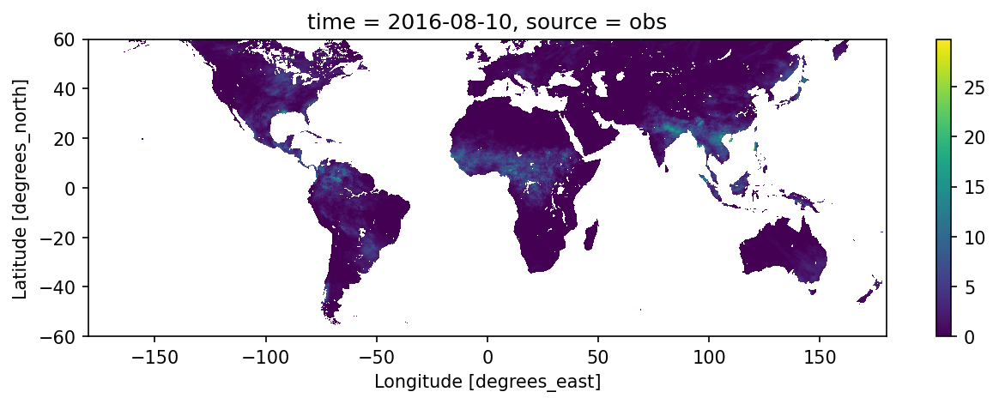

In [37]:
fig = plt.figure(figsize=(10,3),dpi=150)
mcspcp_l_obs_pyflex.plot()

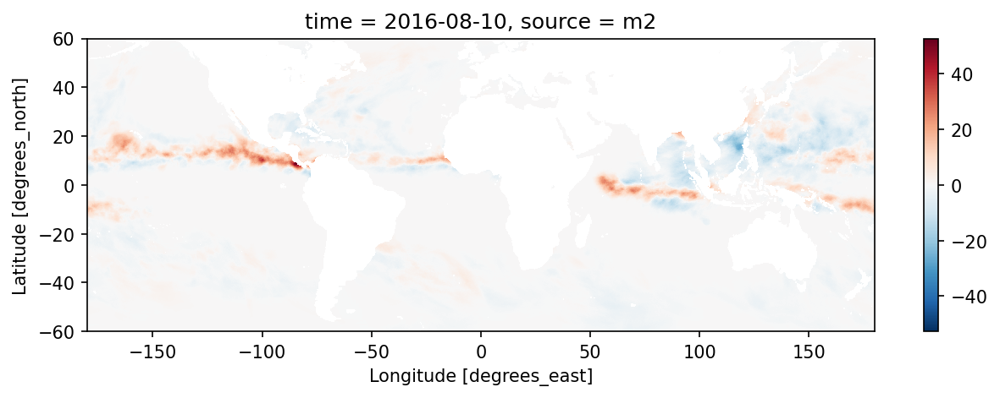

In [38]:
fig = plt.figure(figsize=(10,3),dpi=150)
mcscloudfreq_o_diff_tobac.sel(source='m2').plot()

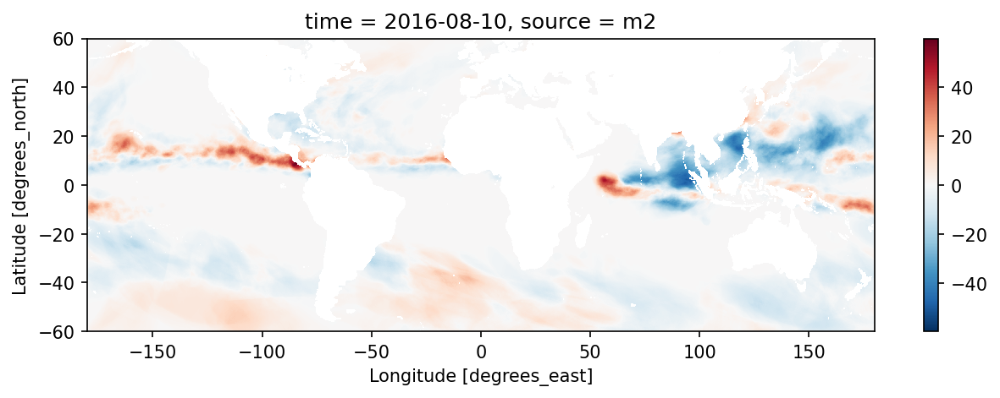

In [39]:
fig = plt.figure(figsize=(10,3),dpi=150)
mcscloudfreq_o_diff_tams.sel(source='m2').plot()

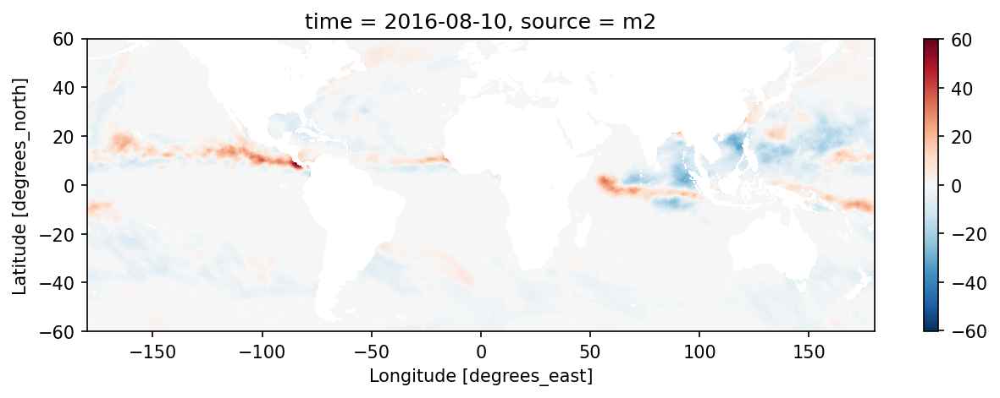

In [40]:
fig = plt.figure(figsize=(10,3),dpi=150)
mcscloudfreq_o_diff_moaap.sel(source='m2').plot()

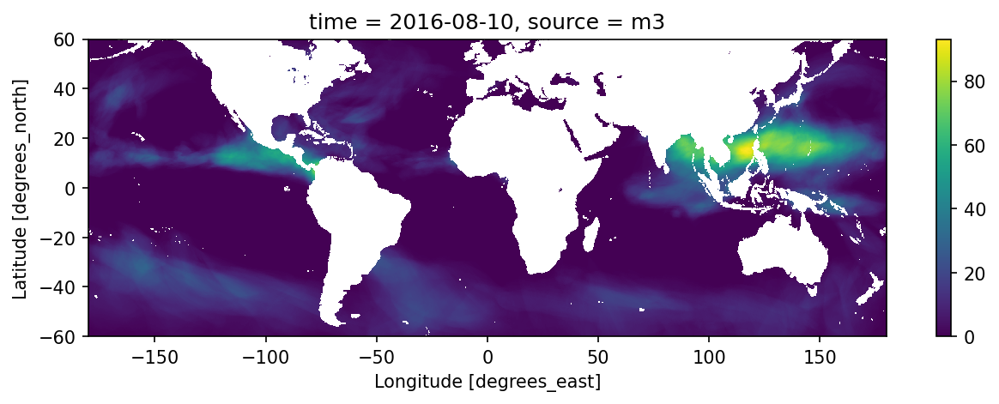

In [41]:
# name_map
fig = plt.figure(figsize=(10,3),dpi=150)
mcscloudfreq_o_mod_tams.sel(source='m3').plot()

In [42]:
# fig = plt.figure(figsize=(10,3),dpi=150)
# mcspcpfreq_l_diff_pyflex.sel(source='m2').plot()

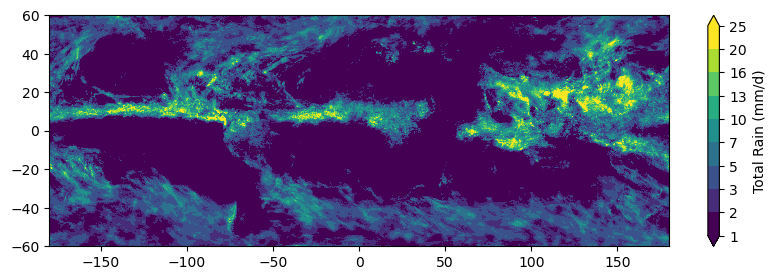

In [43]:
fig = plt.figure(figsize=[10,3], dpi=100)
# levels = np.arange(0,25.1,1)
levels = [1,2,3,5,7,10,13,16,20,25]
cmap = copy.copy(mpl.colormaps.get_cmap("viridis"))
# cmap = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
norm = mpl.colors.BoundaryNorm(boundaries=levels, ncolors=256)
pcm = plt.pcolormesh(lon_lm, lat_lm, totpcp_obs_pyflex, norm=norm, cmap=cmap)
plt.colorbar(label='Total Rain (mm/d)', extend='both')
# pcm.cmap.set_over('magenta')
# pcm.cmap.set_under('white')

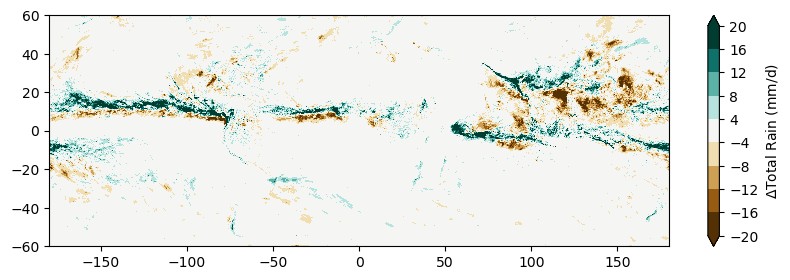

In [44]:
fig = plt.figure(figsize=[10,3], dpi=100)
levels = [-20,-16,-12,-8,-4,4,8,12,16,20]
cmap = mpl.colormaps.get_cmap('BrBG')
norm = mpl.colors.BoundaryNorm(boundaries=levels, ncolors=cmap.N)
pcm = plt.pcolormesh(lon_lm, lat_lm, totpcp_diff_pyflex.sel(source='m2'), norm=norm, cmap=cmap)
plt.colorbar(label='$\Delta$Total Rain (mm/d)', extend='both')

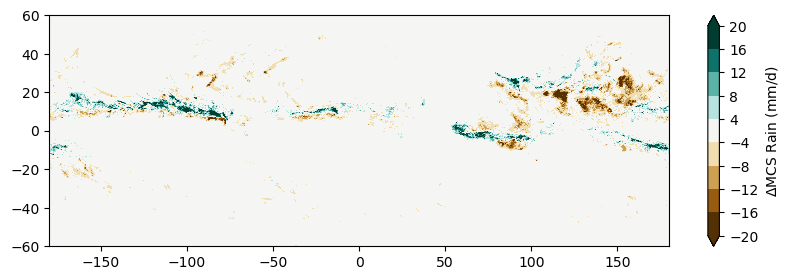

In [45]:
fig = plt.figure(figsize=[10,3], dpi=100)
levels = [-20,-16,-12,-8,-4,4,8,12,16,20]
cmap = mpl.colormaps.get_cmap('BrBG')
norm = mpl.colors.BoundaryNorm(boundaries=levels, ncolors=cmap.N)
pcm = plt.pcolormesh(lon_lm, lat_lm, mcspcp_diff_moaap.sel(source='m2'), norm=norm, cmap=cmap)
plt.colorbar(label='$\Delta$MCS Rain (mm/d)', extend='both')

In [46]:
# fig = plt.figure(figsize=[10,3], dpi=100)
# levels = [-20,-16,-12,-8,-4,4,8,12,16,20]
# cmap = mpl.colormaps.get_cmap('BrBG')
# norm = mpl.colors.BoundaryNorm(boundaries=levels, ncolors=cmap.N)
# pcm = plt.pcolormesh(lon, lat, mcspcp_diff.sel(source='m2'), norm=norm, cmap=cmap)
# plt.colorbar(label='$\Delta$MCS Rain (mm/d)', extend='both')

/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


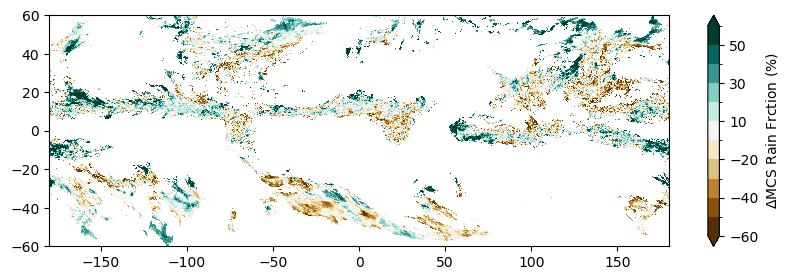

In [47]:
fig = plt.figure(figsize=[10,3], dpi=100)
levels = np.arange(-60, 60.1, 10)
levels = np.delete(levels, int((len(levels)-1)/2))
cmap = mpl.colormaps.get_cmap('BrBG')
norm = mpl.colors.BoundaryNorm(boundaries=levels, ncolors=cmap.N)
pcm = plt.pcolormesh(lon_lm, lat_lm, mcspcpfrac_diff_pyflex.where(mcspcp_mod_pyflex > 1).sel(source='m2'), norm=norm, cmap=cmap)
plt.colorbar(label='$\Delta$MCS Rain Frction (%)', extend='both')

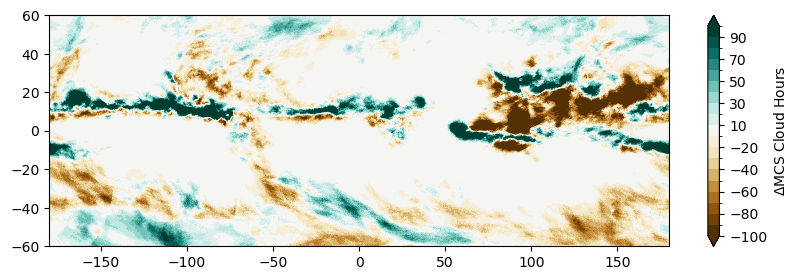

In [48]:
fig = plt.figure(figsize=[10,3], dpi=100)
levels = np.arange(-100, 100.1, 10)
levels = np.delete(levels, int((len(levels)-1)/2))
cmap = mpl.colormaps.get_cmap('BrBG')
norm = mpl.colors.BoundaryNorm(boundaries=levels, ncolors=cmap.N)
pcm = plt.pcolormesh(lon_lm, lat_lm, mcscloudhours_diff_pyflex.sel(source='m2'), norm=norm, cmap=cmap)
plt.colorbar(label='$\Delta$MCS Cloud Hours', extend='both')

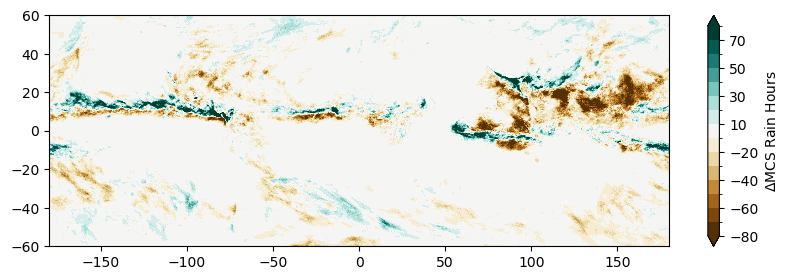

In [49]:
fig = plt.figure(figsize=[10,3], dpi=100)
levels = np.arange(-80, 80.1, 10)
levels = np.delete(levels, int((len(levels)-1)/2))
cmap = mpl.colormaps.get_cmap('BrBG')
norm = mpl.colors.BoundaryNorm(boundaries=levels, ncolors=cmap.N)
pcm = plt.pcolormesh(lon_lm, lat_lm, mcspcphours_diff_pyflex.sel(source='m2'), norm=norm, cmap=cmap)
plt.colorbar(label='$\Delta$MCS Rain Hours', extend='both')

## Specify regional boundaries for calculating mean values

In [50]:
if PHASE == 'Winter':
    box_tropics = [-180, 180, -30, 12]
    boxes = {
        'Land':box_tropics,
        'Ocean':box_tropics,
    }
    region_names = dict(zip(boxes.keys(), boxes.keys()))
    
    # Text location
    diff_reg = np.zeros(len(boxes), dtype=float)
    text_loc_x = np.zeros(len(boxes), dtype=float)
    for ii, name in enumerate(boxes):
        text_loc_x[ii] = boxes[name][0] + (boxes[name][1] - boxes[name][0])/2.
    text_loc_y = [
        boxes['Land'][3]+3,
        boxes['Ocean'][3]+3,
    ]
    text_loc = dict(zip(boxes.keys(), zip(text_loc_x, text_loc_y)))

In [51]:
if PHASE == 'Summer':
    box_tropics = [-180, 180, -12, 30]
    boxes = {
        'Land':box_tropics,
        'Ocean':box_tropics,
    }
    region_names = dict(zip(boxes.keys(), boxes.keys()))
    
    # Text location
    diff_reg = np.zeros(len(boxes), dtype=float)
    text_loc_x = np.zeros(len(boxes), dtype=float)
    for ii, name in enumerate(boxes):
        text_loc_x[ii] = boxes[name][0] + (boxes[name][1] - boxes[name][0])/2.
    text_loc_y = [
        boxes['Land'][3]+3,
        boxes['Ocean'][3]+3,
    ]
    text_loc = dict(zip(boxes.keys(), zip(text_loc_x, text_loc_y)))

In [52]:
# name = 'Land'
# fig = plt.figure(figsize=(10,3),dpi=150)
# mcscloudfreq_l_mod_tams.sel(source='m3', lon=slice(boxes[name][0], boxes[name][1]), lat=slice(boxes[name][2], boxes[name][3])).plot()
# # .sel(lon=slice(boxes[name][0], boxes[name][1]), lat=slice(boxes[name][2], boxes[name][3]), drop=True)

In [53]:
# if PHASE == 'Winter':
#     box_mc = [95%360,150%360,-20,5]
#     box_itcz = [151%360,-110%360,0,12]
#     box_spcz = [151%360,-150%360,-30,-1]
#     box_io = [50%360,94%360,-15,5]
#     box_afc = [10%360,40%360,-20,5]
#     box_amz = [-75%360,-40%360,-20,0]
#     box_ao = [-40%360,-10%360,-8,8]
#     boxes = {'MC':box_mc, 
#              'ITCZ':box_itcz, 
#              'SPCZ':box_spcz, 
#              'IO':box_io, 
#              'AO':box_ao,
#              'AFC':box_afc, 
#              'AMZ':box_amz, 
#              }
#     region_names = dict(zip(boxes.keys(), boxes.keys()))
    
#     # Calculate regional mean difference
#     diff_reg = np.zeros(len(boxes), dtype=float)
#     text_loc_x = np.zeros(len(boxes), dtype=float)
#     for ii, name in enumerate(boxes):
#         text_loc_x[ii] = boxes[name][0] + (boxes[name][1] - boxes[name][0])/2.
#     text_loc_y = [
#         boxes['MC'][3]+3,
#         boxes['ITCZ'][3]+3,
#         boxes['SPCZ'][2]-8, 
#         boxes['IO'][2]-8, 
#         boxes['AO'][3]+3,
#         boxes['AFC'][2]-8, 
#         boxes['AMZ'][2]-8, 
#     ]
#     text_loc = dict(zip(boxes.keys(), zip(text_loc_x, text_loc_y)))
#     text_loc['SPCZ'] = text_loc['SPCZ'][0] + 20, text_loc['SPCZ'][1]

In [54]:
# if PHASE == 'Summer':
#     box_mc = [95,150,-20,5]
#     box_itcz = [-179,-70,5,18]
#     box_io = [50,94,-15,5]
#     box_wpac = [125,178,0,30]
#     box_sam = [70,125,5,40]
#     box_afc = [-15,40,-5,18]
#     box_amz = [-75,-40,-20,0]
#     box_ao = [-60,-15,5,18]
#     box_cus = [-105, -80, 30, 50]
#     box_ao180 = [-60,-15,5,18]
#     box_cus180 = [-105, -80, 30, 50]
#     boxes = {
#         'WP':box_wpac,
#         'ITCZ':box_itcz, 
#         'IO':box_io, 
#         'AO':box_ao,
#         'AFC':box_afc, 
#         'SAM':box_sam,
#         'CUS':box_cus,
#     }
#     region_names = dict(zip(boxes.keys(), boxes.keys()))
    
#     # Calculate regional mean difference
#     diff_reg = np.zeros(len(boxes), dtype=float)
#     text_loc_x = np.zeros(len(boxes), dtype=float)
#     for ii, name in enumerate(boxes):
#         text_loc_x[ii] = boxes[name][0] + (boxes[name][1] - boxes[name][0])/2.
#     text_loc_y = [
#         boxes['WP'][3]+3,
#         boxes['ITCZ'][3]+3, 
#         boxes['IO'][2]-8, 
#         boxes['AO'][3]+3,
#         boxes['AFC'][2]-8, 
#         boxes['SAM'][3]+3,
#         boxes['CUS'][3]+3,
#     ]
#     text_loc = dict(zip(boxes.keys(), zip(text_loc_x, text_loc_y)))

In [55]:
text_loc

{'Land': (0.0, 33), 'Ocean': (0.0, 33)}

## Function to calculate regional mean

In [56]:
def calc_regional_mean(da, boxes):
    """
    Calculate regional mean for all sources
    Args:
        da: DataArray
            Data Array containing dimensions (source, lat, lon)
        boxes: dictionary
            Dictionary containing region names and lat/lon bounds
        
    Returns:
        dict_out: dictionary
            Dictionary containing mean difference for each box.
    """
    # Get number of sources (-1)
    nsource = da.sizes['source']
    # Get number of boxes
    nbox = len(boxes)
    # Get source names (exclude first one 'obs')
    source_names = list(da.source.data[:])
    
    # Make arrays to store the differences
    mean_reg = np.zeros((nsource,nbox), dtype=float)
    text_loc_x = np.zeros((nsource,nbox), dtype=float)
    
    # Loop over each region
    for ii, name in enumerate(boxes):
        text_loc_x[ii] = boxes[name][0] + (boxes[name][1] - boxes[name][0])/2.
        
        # Select (subset) the region
        ida = da.sel(lon=slice(boxes[name][0], boxes[name][1]), lat=slice(boxes[name][2], boxes[name][3]), drop=True)
        # Average over the region
        mean_reg[:,ii] = ida.mean(dim=('lat','lon'))
        
#         # Select non-obs sources, sum over the region
#         ida_mod = ida.isel(source=ida['source'] != 'obs').sum(dim=('lat','lon'))
#         # Select obs, sum over the region
#         ida_obs = ida.sel(source='obs').sum(dim=('lat','lon'))

#         # Calculate fractional difference
#         mean_reg[:,ii] = 100 * (ida_mod - ida_obs) / ida_obs
        
    # Put values in dictionary
    dict_out = dict(zip(source_names, mean_reg))
    # print(dict_out)
    
    return dict_out

In [57]:
name_map

{'obs': 'OBS',
 'm1': 'ARPEGE',
 'm2': 'IFS',
 'm3': 'MPAS',
 'm4': 'NICAM',
 'm5': 'SAM',
 'm6': 'UM',
 'm7': 'FV3',
 'm12': 'SCREAMv1'}

In [58]:
# dict_mcspcpAvg_pyflex = calc_regional_mean(mcspcp_pyflex, boxes)
# print(dict_mcspcpAvg_pyflex)

In [59]:
# fig = plt.figure(figsize=[10,3], dpi=100)
# levels = np.arange(0,101,10)
# cmap = mpl.colormaps.get_cmap('Spectral_r')
# norm = mpl.colors.BoundaryNorm(boundaries=levels, ncolors=cmap.N)
# pcm = plt.pcolormesh(lon_lm, lat_lm, mcscloudhours_pyflex.sel(source='m11'), norm=norm, cmap=cmap)
# plt.colorbar(label='$\Delta$MCS Cloud Hours', extend='both')

In [60]:
# fig = plt.figure(figsize=[10,3], dpi=100)
# levels = np.arange(0,101,10)
# cmap = mpl.colormaps.get_cmap('Spectral_r')
# norm = mpl.colors.BoundaryNorm(boundaries=levels, ncolors=cmap.N)
# pcm = plt.pcolormesh(lon_lm, lat_lm, mcscloudhours_moaap.sel(source='m11'), norm=norm, cmap=cmap)
# plt.colorbar(label='$\Delta$MCS Cloud Hours', extend='both')

In [61]:
# fig = plt.figure(figsize=[10,3], dpi=100)
# levels = np.arange(0,101,10)
# cmap = mpl.colormaps.get_cmap('Spectral_r')
# norm = mpl.colors.BoundaryNorm(boundaries=levels, ncolors=cmap.N)
# pcm = plt.pcolormesh(lon_lm, lat_lm, mcscloudhours_simtrack.sel(source='m11'), norm=norm, cmap=cmap)
# plt.colorbar(label='$\Delta$MCS Cloud Hours', extend='both')

## Ocean, Land separated

### PyFLEXTRKR

In [62]:
# Ocean
dict_mcspcpAvg_o_pyflex = calc_regional_mean(mcspcp_pyflex.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpAvg_o_pyflex)

dict_mcscloudfreqAvg_o_pyflex = calc_regional_mean(mcscloudfreq_pyflex.where(landmask >= ocean_thresh), boxes)
print(dict_mcscloudfreqAvg_o_pyflex)

dict_mcspcpfreqAvg_o_pyflex = calc_regional_mean(mcspcpfreq_pyflex.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpfreqAvg_o_pyflex)

# Land
dict_mcspcpAvg_l_pyflex = calc_regional_mean(mcspcp_pyflex.where(landmask <= land_thresh), boxes)
print(dict_mcspcpAvg_l_pyflex)

dict_mcscloudfreqAvg_l_pyflex = calc_regional_mean(mcscloudfreq_pyflex.where(landmask <= land_thresh), boxes)
print(dict_mcscloudfreqAvg_l_pyflex)

dict_mcspcpfreqAvg_l_pyflex = calc_regional_mean(mcspcpfreq_pyflex.where(landmask <= land_thresh), boxes)
print(dict_mcspcpfreqAvg_l_pyflex)

{'obs': array([2.80626535, 2.80626535]), 'm1': array([1.32618141, 1.32618141]), 'm2': array([2.41949797, 2.41949797]), 'm3': array([1.42674923, 1.42674923]), 'm4': array([3.23409271, 3.23409271]), 'm5': array([2.60261559, 2.60261559]), 'm6': array([2.49764109, 2.49764109]), 'm7': array([2.54981709, 2.54981709]), 'm12': array([2.57571077, 2.57571077])}
{'obs': array([5.31566095, 5.31566095]), 'm1': array([2.4318428, 2.4318428]), 'm2': array([4.62795115, 4.62795115]), 'm3': array([5.11419106, 5.11419106]), 'm4': array([8.21473694, 8.21473694]), 'm5': array([4.76669502, 4.76669502]), 'm6': array([4.61999178, 4.61999178]), 'm7': array([5.10199261, 5.10199261]), 'm12': array([5.67044926, 5.67044926])}
{'obs': array([2.24377966, 2.24377966]), 'm1': array([0.80262101, 0.80262101]), 'm2': array([1.41813314, 1.41813314]), 'm3': array([2.04336596, 2.04336596]), 'm4': array([1.39071977, 1.39071977]), 'm5': array([1.22810364, 1.22810364]), 'm6': array([1.49229383, 1.49229383]), 'm7': array([1.3725

### MOAAP

In [63]:
# Ocean
dict_mcspcpAvg_o_moaap = calc_regional_mean(mcspcp_moaap.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpAvg_o_moaap)

dict_mcscloudfreqAvg_o_moaap = calc_regional_mean(mcscloudfreq_moaap.where(landmask >= ocean_thresh), boxes)
print(dict_mcscloudfreqAvg_o_moaap)

dict_mcspcpfreqAvg_o_moaap = calc_regional_mean(mcspcpfreq_moaap.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpfreqAvg_o_moaap)

# Land
dict_mcspcpAvg_l_moaap = calc_regional_mean(mcspcp_moaap.where(landmask <= land_thresh), boxes)
print(dict_mcspcpAvg_l_moaap)

dict_mcscloudfreqAvg_l_moaap = calc_regional_mean(mcscloudfreq_moaap.where(landmask <= land_thresh), boxes)
print(dict_mcscloudfreqAvg_l_moaap)

dict_mcspcpfreqAvg_l_moaap = calc_regional_mean(mcspcpfreq_moaap.where(landmask <= land_thresh), boxes)
print(dict_mcspcpfreqAvg_l_moaap)

{'obs': array([2.09190559, 2.09190559]), 'm1': array([0.34240118, 0.34240118]), 'm2': array([1.49557292, 1.49557292]), 'm3': array([1.12776768, 1.12776768]), 'm4': array([1.78761673, 1.78761673]), 'm5': array([1.30137753, 1.30137753]), 'm6': array([1.69869614, 1.69869614]), 'm7': array([1.7470578, 1.7470578]), 'm12': array([1.93444359, 1.93444359])}
{'obs': array([4.19021034, 4.19021034]), 'm1': array([1.23885107, 1.23885107]), 'm2': array([3.43903375, 3.43903375]), 'm3': array([3.82717705, 3.82717705]), 'm4': array([5.76904678, 5.76904678]), 'm5': array([2.74218678, 2.74218678]), 'm6': array([3.71335268, 3.71335268]), 'm7': array([3.68524623, 3.68524623]), 'm12': array([4.23972654, 4.23972654])}
{'obs': array([1.63423228, 1.63423228]), 'm1': array([0.22654632, 0.22654632]), 'm2': array([0.92084616, 0.92084616]), 'm3': array([1.59371352, 1.59371352]), 'm4': array([0.79287302, 0.79287302]), 'm5': array([0.61678123, 0.61678123]), 'm6': array([1.06528926, 1.06528926]), 'm7': array([0.9240

### TOOCAN

In [64]:
# Ocean
dict_mcspcpAvg_o_toocan = calc_regional_mean(mcspcp_toocan.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpAvg_o_toocan)

dict_mcscloudfreqAvg_o_toocan = calc_regional_mean(mcscloudfreq_toocan.where(landmask >= ocean_thresh), boxes)
print(dict_mcscloudfreqAvg_o_toocan)

dict_mcspcpfreqAvg_o_toocan = calc_regional_mean(mcspcpfreq_toocan.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpfreqAvg_o_toocan)

# Land
dict_mcspcpAvg_l_toocan = calc_regional_mean(mcspcp_toocan.where(landmask <= land_thresh), boxes)
print(dict_mcspcpAvg_l_toocan)

dict_mcscloudfreqAvg_l_toocan = calc_regional_mean(mcscloudfreq_toocan.where(landmask <= land_thresh), boxes)
print(dict_mcscloudfreqAvg_l_toocan)

dict_mcspcpfreqAvg_l_toocan = calc_regional_mean(mcspcpfreq_toocan.where(landmask <= land_thresh), boxes)
print(dict_mcspcpfreqAvg_l_toocan)

{'obs': array([1.63008618, 1.63008618]), 'm1': array([0.20467177, 0.20467177]), 'm2': array([1.25839138, 1.25839138]), 'm3': array([0.59326553, 0.59326553]), 'm4': array([1.48701668, 1.48701668]), 'm5': array([0.74261814, 0.74261814]), 'm6': array([0.91927946, 0.91927946]), 'm7': array([1.31990635, 1.31990635]), 'm12': array([1.48541594, 1.48541594])}
{'obs': array([2.49724674, 2.49724674]), 'm1': array([0.43383828, 0.43383828]), 'm2': array([2.69949031, 2.69949031]), 'm3': array([1.4763763, 1.4763763]), 'm4': array([3.478549, 3.478549]), 'm5': array([1.31165791, 1.31165791]), 'm6': array([1.51908219, 1.51908219]), 'm7': array([2.41408229, 2.41408229]), 'm12': array([3.01705313, 3.01705313])}
{'obs': array([1.14108765, 1.14108765]), 'm1': array([0.12833403, 0.12833403]), 'm2': array([0.74397904, 0.74397904]), 'm3': array([0.73536694, 0.73536694]), 'm4': array([0.60988414, 0.60988414]), 'm5': array([0.32499409, 0.32499409]), 'm6': array([0.52344632, 0.52344632]), 'm7': array([0.64452064

### tobac

In [65]:
# Ocean
dict_mcspcpAvg_o_tobac = calc_regional_mean(mcspcp_tobac.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpAvg_o_tobac)

dict_mcscloudfreqAvg_o_tobac = calc_regional_mean(mcscloudfreq_tobac.where(landmask >= ocean_thresh), boxes)
print(dict_mcscloudfreqAvg_o_tobac)

dict_mcspcpfreqAvg_o_tobac = calc_regional_mean(mcspcpfreq_tobac.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpfreqAvg_o_tobac)

# Land
dict_mcspcpAvg_l_tobac = calc_regional_mean(mcspcp_tobac.where(landmask <= land_thresh), boxes)
print(dict_mcspcpAvg_l_tobac)

dict_mcscloudfreqAvg_l_tobac = calc_regional_mean(mcscloudfreq_tobac.where(landmask <= land_thresh), boxes)
print(dict_mcscloudfreqAvg_l_tobac)

dict_mcspcpfreqAvg_l_tobac = calc_regional_mean(mcspcpfreq_tobac.where(landmask <= land_thresh), boxes)
print(dict_mcspcpfreqAvg_l_tobac)

{'obs': array([1.73772597, 1.73772597]), 'm1': array([0.31993321, 0.31993321]), 'm2': array([1.44975019, 1.44975019]), 'm3': array([0.6502021, 0.6502021]), 'm4': array([1.7640512, 1.7640512]), 'm5': array([1.08715189, 1.08715189]), 'm6': array([1.49082518, 1.49082518]), 'm7': array([1.46032584, 1.46032584]), 'm12': array([1.34828615, 1.34828615])}
{'obs': array([2.73204255, 2.73204255]), 'm1': array([0.78941047, 0.78941047]), 'm2': array([3.03193355, 3.03193355]), 'm3': array([1.84517276, 1.84517276]), 'm4': array([4.83677769, 4.83677769]), 'm5': array([2.24765444, 2.24765444]), 'm6': array([2.64443851, 2.64443851]), 'm7': array([2.77765036, 2.77765036]), 'm12': array([2.90787935, 2.90787935])}
{'obs': array([1.27187002, 1.27187002]), 'm1': array([0.20801301, 0.20801301]), 'm2': array([0.86944079, 0.86944079]), 'm3': array([0.87711, 0.87711]), 'm4': array([0.75368083, 0.75368083]), 'm5': array([0.5149225, 0.5149225]), 'm6': array([0.86655271, 0.86655271]), 'm7': array([0.74779618, 0.74

### TAMS

In [66]:
# Ocean
dict_mcspcpAvg_o_tams = calc_regional_mean(mcspcp_tams.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpAvg_o_tams)

dict_mcscloudfreqAvg_o_tams = calc_regional_mean(mcscloudfreq_tams.where(landmask >= ocean_thresh), boxes)
print(dict_mcscloudfreqAvg_o_tams)

dict_mcspcpfreqAvg_o_tams = calc_regional_mean(mcspcpfreq_tams.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpfreqAvg_o_tams)

# Land
dict_mcspcpAvg_l_tams = calc_regional_mean(mcspcp_tams.where(landmask <= land_thresh), boxes)
print(dict_mcspcpAvg_l_tams)

dict_mcscloudfreqAvg_l_tams = calc_regional_mean(mcscloudfreq_tams.where(landmask <= land_thresh), boxes)
print(dict_mcscloudfreqAvg_l_tams)

dict_mcspcpfreqAvg_l_tams = calc_regional_mean(mcspcpfreq_tams.where(landmask <= land_thresh), boxes)
print(dict_mcspcpfreqAvg_l_tams)

{'obs': array([2.7868607, 2.7868607]), 'm1': array([0.89999139, 0.89999139]), 'm2': array([2.03121471, 2.03121471]), 'm3': array([2.13431311, 2.13431311]), 'm4': array([2.89243484, 2.89243484]), 'm5': array([2.0472281, 2.0472281]), 'm6': array([2.39005589, 2.39005589]), 'm7': array([2.42061448, 2.42061448]), 'm12': array([2.36792469, 2.36792469])}
{'obs': array([7.94522333, 7.94522333]), 'm1': array([3.28690863, 3.28690863]), 'm2': array([5.76857042, 5.76857042]), 'm3': array([12.00912762, 12.00912762]), 'm4': array([11.39662361, 11.39662361]), 'm5': array([6.64074659, 6.64074659]), 'm6': array([6.70841217, 6.70841217]), 'm7': array([7.74937201, 7.74937201]), 'm12': array([8.19087887, 8.19087887])}
{'obs': array([2.31351304, 2.31351304]), 'm1': array([0.6001296, 0.6001296]), 'm2': array([1.24047959, 1.24047959]), 'm3': array([3.07517505, 3.07517505]), 'm4': array([1.31203306, 1.31203306]), 'm5': array([1.0246613, 1.0246613]), 'm6': array([1.57404792, 1.57404792]), 'm7': array([1.352360

### SimpleTrack

In [67]:
# Ocean
dict_mcspcpAvg_o_simtrack = calc_regional_mean(mcspcp_simtrack.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpAvg_o_simtrack)

dict_mcscloudfreqAvg_o_simtrack = calc_regional_mean(mcscloudfreq_simtrack.where(landmask >= ocean_thresh), boxes)
print(dict_mcscloudfreqAvg_o_simtrack)

dict_mcspcpfreqAvg_o_simtrack = calc_regional_mean(mcspcpfreq_simtrack.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpfreqAvg_o_simtrack)

# Land
dict_mcspcpAvg_l_simtrack = calc_regional_mean(mcspcp_simtrack.where(landmask <= land_thresh), boxes)
print(dict_mcspcpAvg_l_simtrack)

dict_mcscloudfreqAvg_l_simtrack = calc_regional_mean(mcscloudfreq_simtrack.where(landmask <= land_thresh), boxes)
print(dict_mcscloudfreqAvg_l_simtrack)

dict_mcspcpfreqAvg_l_simtrack = calc_regional_mean(mcspcpfreq_simtrack.where(landmask <= land_thresh), boxes)
print(dict_mcspcpfreqAvg_l_simtrack)

{'obs': array([2.51898241, 2.51898241]), 'm1': array([0.6397267, 0.6397267]), 'm2': array([1.90058625, 1.90058625]), 'm3': array([0.92497712, 0.92497712]), 'm4': array([2.49946547, 2.49946547]), 'm5': array([1.67318881, 1.67318881]), 'm6': array([2.10590672, 2.10590672]), 'm7': array([2.03723407, 2.03723407]), 'm12': array([2.16699982, 2.16699982])}
{'obs': array([4.92538404, 4.92538404]), 'm1': array([1.92440307, 1.92440307]), 'm2': array([4.13970566, 4.13970566]), 'm3': array([3.76272511, 3.76272511]), 'm4': array([7.4482646, 7.4482646]), 'm5': array([3.94718742, 3.94718742]), 'm6': array([4.25513172, 4.25513172]), 'm7': array([4.61831856, 4.61831856]), 'm12': array([4.96844006, 4.96844006])}
{'obs': array([2.01477528, 2.01477528]), 'm1': array([0.42371616, 0.42371616]), 'm2': array([1.14843786, 1.14843786]), 'm3': array([1.37364042, 1.37364042]), 'm4': array([1.08678293, 1.08678293]), 'm5': array([0.81088275, 0.81088275]), 'm6': array([1.29160726, 1.29160726]), 'm7': array([1.087222

## Function to calculate regional mean percentage difference

In [68]:
def calc_regional_diff_percent(da, boxes):
    """
    Calculate regional mean percentage difference
    Args:
        da: DataArray
            Data Array containing dimensions (source, lat, lon)
        boxes: dictionary
            Dictionary containing region names and lat/lon bounds
        
    Returns:
        dict_out: dictionary
            Dictionary containing mean difference for each box.
    """
    # Get number of sources (-1)
    nsource = da.sizes['source']-1
    # Get number of boxes
    nbox = len(boxes)
    # Get source names (exclude first one 'obs')
    source_names = list(da.source.data[1:])
    
    # Make arrays to store the differences
    diff_reg = np.zeros((nsource,nbox), dtype=float)
    text_loc_x = np.zeros((nsource,nbox), dtype=float)
    
    # Loop over each region
    for ii, name in enumerate(boxes):
        text_loc_x[ii] = boxes[name][0] + (boxes[name][1] - boxes[name][0])/2.
        
        # Select (subset) the region
        ida = da.sel(lon=slice(boxes[name][0], boxes[name][1]), lat=slice(boxes[name][2], boxes[name][3]), drop=True)        
        # Select non-obs sources, sum over the region
        ida_mod = ida.isel(source=ida['source'] != 'obs').sum(dim=('lat','lon'))
        # Select obs, sum over the region
        ida_obs = ida.sel(source='obs').sum(dim=('lat','lon'))

        # Calculate fractional difference
        diff_reg[:,ii] = 100 * (ida_mod - ida_obs) / ida_obs
        
    # Put values in dictionary
    dict_out = dict(zip(source_names, diff_reg))
    # print(dict_out)
    
    return dict_out

In [69]:
# mcscloudhours_diff.sel(source='m3').where(landmask >= ocean_thresh).plot()

## Ocean & Land

### PyFLEXTRKR

In [70]:
dict_totpcp_pyflex = calc_regional_diff_percent(totpcp_pyflex, boxes)
print(dict_totpcp_pyflex)

dict_mcspcp_pyflex = calc_regional_diff_percent(mcspcp_pyflex, boxes)
print(dict_mcspcp_pyflex)

dict_mcscloudfreq_pyflex = calc_regional_diff_percent(mcscloudfreq_pyflex, boxes)
print(dict_mcscloudfreq_pyflex)

dict_mcspcpfreq_pyflex = calc_regional_diff_percent(mcspcpfreq_pyflex, boxes)
print(dict_mcspcpfreq_pyflex)

{'m1': array([26.51548958, 26.51548958]), 'm2': array([10.53562927, 10.53562927]), 'm3': array([2.36959362, 2.36959362]), 'm4': array([18.62116432, 18.62116432]), 'm5': array([21.43501091, 21.43501091]), 'm6': array([20.29973984, 20.29973984]), 'm7': array([11.41752815, 11.41752815]), 'm12': array([13.31799793, 13.31799793])}
{'m1': array([-51.87453079, -51.87453079]), 'm2': array([-6.28707409, -6.28707409]), 'm3': array([-45.05751801, -45.05751801]), 'm4': array([13.27732944, 13.27732944]), 'm5': array([-1.40251613, -1.40251613]), 'm6': array([-3.92017102, -3.92017102]), 'm7': array([-8.79963589, -8.79963589]), 'm12': array([1.06890523, 1.06890523])}
{'m1': array([-54.26556396, -54.26556396]), 'm2': array([-4.81035423, -4.81035423]), 'm3': array([7.17569113, 7.17569113]), 'm4': array([44.23339844, 44.23339844]), 'm5': array([-6.94908857, -6.94908857]), 'm6': array([-16.04202461, -16.04202461]), 'm7': array([-6.87896204, -6.87896204]), 'm12': array([14.88106823, 14.88106823])}
{'m1': a

### MOAAP

In [71]:
dict_totpcp_moaap = calc_regional_diff_percent(totpcp_moaap, boxes)
print(dict_totpcp_moaap)

dict_mcspcp_moaap = calc_regional_diff_percent(mcspcp_moaap, boxes)
print(dict_mcspcp_moaap)

dict_mcscloudfreq_moaap = calc_regional_diff_percent(mcscloudfreq_moaap, boxes)
print(dict_mcscloudfreq_moaap)

dict_mcspcpfreq_moaap = calc_regional_diff_percent(mcspcpfreq_moaap, boxes)
print(dict_mcspcpfreq_moaap)

{'m1': array([26.51548958, 26.51548958]), 'm2': array([10.53562927, 10.53562927]), 'm3': array([2.36959362, 2.36959362]), 'm4': array([18.62116432, 18.62116432]), 'm5': array([21.43501091, 21.43501091]), 'm6': array([20.29973984, 20.29973984]), 'm7': array([11.41752815, 11.41752815]), 'm12': array([13.31799793, 13.31799793])}
{'m1': array([-85.30531311, -85.30531311]), 'm2': array([-22.49562263, -22.49562263]), 'm3': array([-40.91386032, -40.91386032]), 'm4': array([-15.48201084, -15.48201084]), 'm5': array([-32.49922943, -32.49922943]), 'm6': array([-16.58283234, -16.58283234]), 'm7': array([-15.60309982, -15.60309982]), 'm12': array([1.68027282, 1.68027282])}
{'m1': array([-71.72815704, -71.72815704]), 'm2': array([-9.92211819, -9.92211819]), 'm3': array([2.21765518, 2.21765518]), 'm4': array([29.58408165, 29.58408165]), 'm5': array([-31.18986511, -31.18986511]), 'm6': array([-17.34706688, -17.34706688]), 'm7': array([-15.95654678, -15.95654678]), 'm12': array([8.57009697, 8.57009697

## Ocean, Land separated

### PyFLEXTRKR

In [72]:
# Ocean
dict_totpcp_o_pyflex = calc_regional_diff_percent(totpcp_pyflex.where(landmask >= ocean_thresh), boxes)
print(dict_totpcp_o_pyflex)

dict_mcspcp_o_pyflex = calc_regional_diff_percent(mcspcp_pyflex.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcp_o_pyflex)

dict_mcscloudfreq_o_pyflex = calc_regional_diff_percent(mcscloudfreq_pyflex.where(landmask >= ocean_thresh), boxes)
print(dict_mcscloudfreq_o_pyflex)

dict_mcspcpfreq_o_pyflex = calc_regional_diff_percent(mcspcpfreq_pyflex.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpfreq_o_pyflex)

# Land
dict_totpcp_l_pyflex = calc_regional_diff_percent(totpcp_pyflex.where(landmask <= land_thresh), boxes)
print(dict_totpcp_l_pyflex)

dict_mcspcp_l_pyflex = calc_regional_diff_percent(mcspcp_pyflex.where(landmask <= land_thresh), boxes)
print(dict_mcspcp_l_pyflex)

dict_mcscloudfreq_l_pyflex = calc_regional_diff_percent(mcscloudfreq_pyflex.where(landmask <= land_thresh), boxes)
print(dict_mcscloudfreq_l_pyflex)

dict_mcspcpfreq_l_pyflex = calc_regional_diff_percent(mcspcpfreq_pyflex.where(landmask <= land_thresh), boxes)
print(dict_mcspcpfreq_l_pyflex)

{'m1': array([19.69095612, 19.69095612]), 'm2': array([1.95755088, 1.95755088]), 'm3': array([1.82639837, 1.82639837]), 'm4': array([25.20858574, 25.20858574]), 'm5': array([19.71632195, 19.71632195]), 'm6': array([13.61670113, 13.61670113]), 'm7': array([13.3962183, 13.3962183]), 'm12': array([5.49646425, 5.49646425])}
{'m1': array([-52.74212265, -52.74212265]), 'm2': array([-13.78227806, -13.78227806]), 'm3': array([-49.15843582, -49.15843582]), 'm4': array([15.24543476, 15.24543476]), 'm5': array([-7.25697041, -7.25697041]), 'm6': array([-10.99768543, -10.99768543]), 'm7': array([-9.13842201, -9.13842201]), 'm12': array([-8.21571255, -8.21571255])}
{'m1': array([-54.25135422, -54.25135422]), 'm2': array([-12.93743324, -12.93743324]), 'm3': array([-3.79012442, -3.79012442]), 'm4': array([54.53837967, 54.53837967]), 'm5': array([-10.32733727, -10.32733727]), 'm6': array([-13.08716583, -13.08716583]), 'm7': array([-4.01959991, -4.01959991]), 'm12': array([6.67439175, 6.67439175])}
{'m1

### MOAAP

In [73]:
# Ocean
dict_totpcp_o_moaap = calc_regional_diff_percent(totpcp_moaap.where(landmask >= ocean_thresh), boxes)
print(dict_totpcp_o_moaap)

dict_mcspcp_o_moaap = calc_regional_diff_percent(mcspcp_moaap.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcp_o_moaap)

dict_mcscloudfreq_o_moaap = calc_regional_diff_percent(mcscloudfreq_moaap.where(landmask >= ocean_thresh), boxes)
print(dict_mcscloudfreq_o_moaap)

dict_mcspcpfreq_o_moaap = calc_regional_diff_percent(mcspcpfreq_moaap.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpfreq_o_moaap)

# Land
dict_totpcp_l_moaap = calc_regional_diff_percent(totpcp_moaap.where(landmask <= land_thresh), boxes)
print(dict_totpcp_l_moaap)

dict_mcspcp_l_moaap = calc_regional_diff_percent(mcspcp_moaap.where(landmask <= land_thresh), boxes)
print(dict_mcspcp_l_moaap)

dict_mcscloudfreq_l_moaap = calc_regional_diff_percent(mcscloudfreq_moaap.where(landmask <= land_thresh), boxes)
print(dict_mcscloudfreq_l_moaap)

dict_mcspcpfreq_l_moaap = calc_regional_diff_percent(mcspcpfreq_moaap.where(landmask <= land_thresh), boxes)
print(dict_mcspcpfreq_l_moaap)

{'m1': array([19.69095612, 19.69095612]), 'm2': array([1.95755088, 1.95755088]), 'm3': array([1.82639837, 1.82639837]), 'm4': array([25.20858574, 25.20858574]), 'm5': array([19.71632195, 19.71632195]), 'm6': array([13.61670113, 13.61670113]), 'm7': array([13.3962183, 13.3962183]), 'm12': array([5.49646425, 5.49646425])}
{'m1': array([-83.63208771, -83.63208771]), 'm2': array([-28.50667191, -28.50667191]), 'm3': array([-46.088974, -46.088974]), 'm4': array([-14.54601192, -14.54601192]), 'm5': array([-37.78985214, -37.78985214]), 'm6': array([-18.79670906, -18.79670906]), 'm7': array([-16.48485947, -16.48485947]), 'm12': array([-7.52719927, -7.52719927])}
{'m1': array([-70.43463135, -70.43463135]), 'm2': array([-17.92694092, -17.92694092]), 'm3': array([-8.66384602, -8.66384602]), 'm4': array([37.67916107, 37.67916107]), 'm5': array([-34.55730057, -34.55730057]), 'm6': array([-11.38027954, -11.38027954]), 'm7': array([-12.05104256, -12.05104256]), 'm12': array([1.18171442, 1.18171442])}


### TOOCAN

In [74]:
# Ocean
dict_totpcp_o_toocan = calc_regional_diff_percent(totpcp_toocan.where(landmask >= ocean_thresh), boxes)
print(dict_totpcp_o_toocan)

dict_mcspcp_o_toocan = calc_regional_diff_percent(mcspcp_toocan.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcp_o_toocan)

dict_mcscloudfreq_o_toocan = calc_regional_diff_percent(mcscloudfreq_toocan.where(landmask >= ocean_thresh), boxes)
print(dict_mcscloudfreq_o_toocan)

dict_mcspcpfreq_o_toocan = calc_regional_diff_percent(mcspcpfreq_toocan.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpfreq_o_toocan)

# Land
dict_totpcp_l_toocan = calc_regional_diff_percent(totpcp_toocan.where(landmask <= land_thresh), boxes)
print(dict_totpcp_l_toocan)

dict_mcspcp_l_toocan = calc_regional_diff_percent(mcspcp_toocan.where(landmask <= land_thresh), boxes)
print(dict_mcspcp_l_toocan)

dict_mcscloudfreq_l_toocan = calc_regional_diff_percent(mcscloudfreq_toocan.where(landmask <= land_thresh), boxes)
print(dict_mcscloudfreq_l_toocan)

dict_mcspcpfreq_l_toocan = calc_regional_diff_percent(mcspcpfreq_toocan.where(landmask <= land_thresh), boxes)
print(dict_mcspcpfreq_l_toocan)

{'m1': array([19.70382881, 19.70382881]), 'm2': array([1.95880282, 1.95880282]), 'm3': array([1.82009363, 1.82009363]), 'm4': array([25.2008419, 25.2008419]), 'm5': array([22.09291077, 22.09291077]), 'm6': array([13.60969925, 13.60969925]), 'm7': array([13.38918495, 13.38918495]), 'm12': array([5.48992062, 5.48992062])}
{'m1': array([-87.44411469, -87.44411469]), 'm2': array([-22.80216217, -22.80216217]), 'm3': array([-63.6052742, -63.6052742]), 'm4': array([-8.77680588, -8.77680588]), 'm5': array([-54.44301224, -54.44301224]), 'm6': array([-43.60547256, -43.60547256]), 'm7': array([-19.02843475, -19.02843475]), 'm12': array([-8.87500668, -8.87500668])}
{'m1': array([-82.62732697, -82.62732697]), 'm2': array([8.09866238, 8.09866238]), 'm3': array([-40.87983704, -40.87983704]), 'm4': array([39.29536438, 39.29536438]), 'm5': array([-47.47584152, -47.47584152]), 'm6': array([-39.1697197, -39.1697197]), 'm7': array([-3.33024883, -3.33024883]), 'm12': array([20.81518173, 20.81518173])}
{'m1

## tobac

In [75]:
# Ocean
dict_totpcp_o_tobac = calc_regional_diff_percent(totpcp_tobac.where(landmask >= ocean_thresh), boxes)
print(dict_totpcp_o_tobac)

dict_mcspcp_o_tobac = calc_regional_diff_percent(mcspcp_tobac.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcp_o_tobac)

dict_mcscloudfreq_o_tobac = calc_regional_diff_percent(mcscloudfreq_tobac.where(landmask >= ocean_thresh), boxes)
print(dict_mcscloudfreq_o_tobac)

dict_mcspcpfreq_o_tobac = calc_regional_diff_percent(mcspcpfreq_tobac.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpfreq_o_tobac)

# Land
dict_totpcp_l_tobac = calc_regional_diff_percent(totpcp_tobac.where(landmask <= land_thresh), boxes)
print(dict_totpcp_l_tobac)

dict_mcspcp_l_tobac = calc_regional_diff_percent(mcspcp_tobac.where(landmask <= land_thresh), boxes)
print(dict_mcspcp_l_tobac)

dict_mcscloudfreq_l_tobac = calc_regional_diff_percent(mcscloudfreq_tobac.where(landmask <= land_thresh), boxes)
print(dict_mcscloudfreq_l_tobac)

dict_mcspcpfreq_l_tobac = calc_regional_diff_percent(mcspcpfreq_tobac.where(landmask <= land_thresh), boxes)
print(dict_mcspcpfreq_l_tobac)

{'m1': array([19.69095612, 19.69095612]), 'm2': array([1.95755088, 1.95755088]), 'm3': array([1.82639837, 1.82639837]), 'm4': array([25.20858574, 25.20858574]), 'm5': array([19.71632195, 19.71632195]), 'm6': array([13.61670113, 13.61670113]), 'm7': array([13.3962183, 13.3962183]), 'm12': array([5.49646425, 5.49646425])}
{'m1': array([-81.588974, -81.588974]), 'm2': array([-16.57199097, -16.57199097]), 'm3': array([-62.58316422, -62.58316422]), 'm4': array([1.51492393, 1.51492393]), 'm5': array([-37.43824005, -37.43824005]), 'm6': array([-14.20826721, -14.20826721]), 'm7': array([-15.96339893, -15.96339893]), 'm12': array([-22.41088295, -22.41088295])}
{'m1': array([-71.10548401, -71.10548401]), 'm2': array([10.97680664, 10.97680664]), 'm3': array([-32.46178436, -32.46178436]), 'm4': array([77.03888702, 77.03888702]), 'm5': array([-17.72989082, -17.72989082]), 'm6': array([-3.20654202, -3.20654202]), 'm7': array([1.66936803, 1.66936803]), 'm12': array([6.43609381, 6.43609381])}
{'m1': a

## TAMS

In [76]:
# Ocean
dict_totpcp_o_tams = calc_regional_diff_percent(totpcp_tams.where(landmask >= ocean_thresh), boxes)
print(dict_totpcp_o_tams)

dict_mcspcp_o_tams = calc_regional_diff_percent(mcspcp_tams.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcp_o_tams)

dict_mcscloudfreq_o_tams = calc_regional_diff_percent(mcscloudfreq_tams.where(landmask >= ocean_thresh), boxes)
print(dict_mcscloudfreq_o_tams)

dict_mcspcpfreq_o_tams = calc_regional_diff_percent(mcspcpfreq_tams.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpfreq_o_tams)

# Land
dict_totpcp_l_tams = calc_regional_diff_percent(totpcp_tams.where(landmask <= land_thresh), boxes)
print(dict_totpcp_l_tams)

dict_mcspcp_l_tams = calc_regional_diff_percent(mcspcp_tams.where(landmask <= land_thresh), boxes)
print(dict_mcspcp_l_tams)

dict_mcscloudfreq_l_tams = calc_regional_diff_percent(mcscloudfreq_tams.where(landmask <= land_thresh), boxes)
print(dict_mcscloudfreq_l_tams)

dict_mcspcpfreq_l_tams = calc_regional_diff_percent(mcspcpfreq_tams.where(landmask <= land_thresh), boxes)
print(dict_mcspcpfreq_l_tams)

{'m1': array([19.69095612, 19.69095612]), 'm2': array([1.95755088, 1.95755088]), 'm3': array([1.82639837, 1.82639837]), 'm4': array([25.20858574, 25.20858574]), 'm5': array([19.71632195, 19.71632195]), 'm6': array([13.61670113, 13.61670113]), 'm7': array([13.3962183, 13.3962183]), 'm12': array([5.49646425, 5.49646425])}
{'m1': array([-67.70590973, -67.70590973]), 'm2': array([-27.11459541, -27.11459541]), 'm3': array([-23.41514969, -23.41514969]), 'm4': array([3.78828716, 3.78828716]), 'm5': array([-26.53998566, -26.53998566]), 'm6': array([-14.23841286, -14.23841286]), 'm7': array([-13.14189529, -13.14189529]), 'm12': array([-15.03253841, -15.03253841])}
{'m1': array([-58.63037872, -58.63037872]), 'm2': array([-27.39574242, -27.39574242]), 'm3': array([51.14902496, 51.14902496]), 'm4': array([43.43993378, 43.43993378]), 'm5': array([-16.41837692, -16.41837692]), 'm6': array([-15.56672478, -15.56672478]), 'm7': array([-2.46502399, -2.46502399]), 'm12': array([3.0918591, 3.0918591])}
{'

## simpleTrack

In [77]:
# Ocean
dict_totpcp_o_simtrack = calc_regional_diff_percent(totpcp_simtrack.where(landmask >= ocean_thresh), boxes)
print(dict_totpcp_o_simtrack)

dict_mcspcp_o_simtrack = calc_regional_diff_percent(mcspcp_simtrack.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcp_o_simtrack)

dict_mcscloudfreq_o_simtrack = calc_regional_diff_percent(mcscloudfreq_simtrack.where(landmask >= ocean_thresh), boxes)
print(dict_mcscloudfreq_o_simtrack)

dict_mcspcpfreq_o_simtrack = calc_regional_diff_percent(mcspcpfreq_simtrack.where(landmask >= ocean_thresh), boxes)
print(dict_mcspcpfreq_o_simtrack)

# Land
dict_totpcp_l_simtrack = calc_regional_diff_percent(totpcp_simtrack.where(landmask <= land_thresh), boxes)
print(dict_totpcp_l_simtrack)

dict_mcspcp_l_simtrack = calc_regional_diff_percent(mcspcp_simtrack.where(landmask <= land_thresh), boxes)
print(dict_mcspcp_l_simtrack)

dict_mcscloudfreq_l_simtrack = calc_regional_diff_percent(mcscloudfreq_simtrack.where(landmask <= land_thresh), boxes)
print(dict_mcscloudfreq_l_simtrack)

dict_mcspcpfreq_l_simtrack = calc_regional_diff_percent(mcspcpfreq_simtrack.where(landmask <= land_thresh), boxes)
print(dict_mcspcpfreq_l_simtrack)

{'m1': array([19.69095612, 19.69095612]), 'm2': array([1.95755088, 1.95755088]), 'm3': array([1.82639837, 1.82639837]), 'm4': array([25.20858574, 25.20858574]), 'm5': array([19.71632195, 19.71632195]), 'm6': array([13.61670113, 13.61670113]), 'm7': array([13.3962183, 13.3962183]), 'm12': array([5.49646425, 5.49646425])}
{'m1': array([-74.60375977, -74.60375977]), 'm2': array([-24.54944038, -24.54944038]), 'm3': array([-63.27973175, -63.27973175]), 'm4': array([-0.77478617, -0.77478617]), 'm5': array([-33.57679367, -33.57679367]), 'm6': array([-16.39850998, -16.39850998]), 'm7': array([-19.12471199, -19.12471199]), 'm12': array([-13.97319794, -13.97319794])}
{'m1': array([-60.92887497, -60.92887497]), 'm2': array([-15.95161152, -15.95161152]), 'm3': array([-23.60544586, -23.60544586]), 'm4': array([51.22200394, 51.22200394]), 'm5': array([-19.86031151, -19.86031151]), 'm6': array([-13.60812187, -13.60812187]), 'm7': array([-6.23434305, -6.23434305]), 'm12': array([0.8741619, 0.8741619])

In [78]:
name_map

{'obs': 'OBS',
 'm1': 'ARPEGE',
 'm2': 'IFS',
 'm3': 'MPAS',
 'm4': 'NICAM',
 'm5': 'SAM',
 'm6': 'UM',
 'm7': 'FV3',
 'm12': 'SCREAMv1'}

In [79]:
boxes

{'Land': [-180, 180, -12, 30], 'Ocean': [-180, 180, -12, 30]}

In [80]:
dict_mcscloudfreq_l_pyflex

{'m1': array([-52.55258179, -52.55258179]),
 'm2': array([20.62094688, 20.62094688]),
 'm3': array([35.40047455, 35.40047455]),
 'm4': array([13.86380577, 13.86380577]),
 'm5': array([0.67613733, 0.67613733]),
 'm6': array([-25.27726173, -25.27726173]),
 'm7': array([-15.88310432, -15.88310432]),
 'm12': array([40.1966362, 40.1966362])}

## Function to calculate regional mean fraction for all sources

In [81]:
def calc_regional_mean_frac(da1, da2, boxes):
    """
    Calculate regional mean fraction for all sources
    fraction = da1 / da2
    
    Args:
        da1: DataArray
            Data Array 1 containing dimensions (source, lat, lon)
        da2: DataArray
            Data Array 2 containing dimensions (source, lat, lon)
        boxes: dictionary
            Dictionary containing region names and lat/lon bounds
        
    Returns:
        dict_out: dictionary
            Dictionary containing mean difference for each box.
    """
    # Get number of sources
    nsource = da1.sizes['source']
    # Get number of boxes
    nbox = len(boxes)
    # Get source names (exclude first one 'obs')
    source_names = list(da1.source.data[:])
    
    # Make arrays to store the differences
    mean_reg = np.zeros((nsource,nbox), dtype=float)
    text_loc_x = np.zeros((nsource,nbox), dtype=float)
    
    # Loop over each region
    for ii, name in enumerate(boxes):
        text_loc_x[ii] = boxes[name][0] + (boxes[name][1] - boxes[name][0])/2.
        
        # Select (subset) the region
        ida1 = da1.sel(lon=slice(boxes[name][0], boxes[name][1]), lat=slice(boxes[name][2], boxes[name][3]), drop=True)
        ida2 = da2.sel(lon=slice(boxes[name][0], boxes[name][1]), lat=slice(boxes[name][2], boxes[name][3]), drop=True)
        # Sum over the region
        ida1_mod = ida1.sum(dim=('lat','lon'))
        ida2_mod = ida2.sum(dim=('lat','lon'))
        # Calculate mean fraction
        mean_reg[:,ii] = 100 * (ida1_mod) / (ida2_mod)       
        
    # Put values in dictionary
    dict_out = dict(zip(source_names, mean_reg))
    # print(dict_out)
    
    return dict_out

## PyFLEXTRKR

In [82]:
# Ocean & Land
dict_mcspcpfracAvg_pyflex = calc_regional_mean_frac(mcspcp_pyflex, totpcp_pyflex, boxes)
# dict_mcspcpfrac_pyflex

# Ocean
dict_mcspcpfracAvg_o_pyflex = calc_regional_mean_frac(mcspcp_pyflex.where(landmask >= ocean_thresh), totpcp_pyflex.where(landmask >= ocean_thresh), boxes)
# dict_mcspcpfracAvg_o_pyflex

# Land
dict_mcspcpfracAvg_l_pyflex = calc_regional_mean_frac(mcspcp_pyflex.where(landmask <= land_thresh), totpcp_pyflex.where(landmask <= land_thresh), boxes)
dict_mcspcpfracAvg_l_pyflex

{'obs': array([56.8678894, 56.8678894]),
 'm1': array([19.85728645, 19.85728645]),
 'm2': array([50.00555801, 50.00555801]),
 'm3': array([36.25340652, 36.25340652]),
 'm4': array([59.06468964, 59.06468964]),
 'm5': array([51.8915863, 51.8915863]),
 'm6': array([46.68833923, 46.68833923]),
 'm7': array([47.93496704, 47.93496704]),
 'm12': array([54.33769989, 54.33769989])}

## MOAAP

In [83]:
# Ocean & Land
dict_mcspcpfracAvg_moaap = calc_regional_mean_frac(mcspcp_moaap, totpcp_moaap, boxes)
# dict_mcspcpfrac_moaap

# Ocean
dict_mcspcpfracAvg_o_moaap = calc_regional_mean_frac(mcspcp_moaap.where(landmask >= ocean_thresh), totpcp_moaap.where(landmask >= ocean_thresh), boxes)
# dict_mcspcpfracAvg_o_moaap

# Land
dict_mcspcpfracAvg_l_moaap = calc_regional_mean_frac(mcspcp_moaap.where(landmask <= land_thresh), totpcp_moaap.where(landmask <= land_thresh), boxes)
dict_mcspcpfracAvg_l_moaap

{'obs': array([37.17823029, 37.17823029]),
 'm1': array([2.10349035, 2.10349035]),
 'm2': array([27.6436348, 27.6436348]),
 'm3': array([27.01956177, 27.01956177]),
 'm4': array([29.45536804, 29.45536804]),
 'm5': array([25.36060143, 25.36060143]),
 'm6': array([22.46448326, 22.46448326]),
 'm7': array([29.95363426, 29.95363426]),
 'm12': array([36.78478241, 36.78478241])}

## TOOCAN

In [84]:
# Ocean & Land
dict_mcspcpfracAvg_toocan = calc_regional_mean_frac(mcspcp_toocan, totpcp_toocan, boxes)
# dict_mcspcpfrac_toocan

# Ocean
dict_mcspcpfracAvg_o_toocan = calc_regional_mean_frac(mcspcp_toocan.where(landmask >= ocean_thresh), totpcp_toocan.where(landmask >= ocean_thresh), boxes)
# dict_mcspcpfracAvg_o_toocan

# Land
dict_mcspcpfracAvg_l_toocan = calc_regional_mean_frac(mcspcp_toocan.where(landmask <= land_thresh), totpcp_toocan.where(landmask <= land_thresh), boxes)
dict_mcspcpfracAvg_l_toocan

{'obs': array([31.34569168, 31.34569168]),
 'm1': array([1.38681567, 1.38681567]),
 'm2': array([26.74038506, 26.74038506]),
 'm3': array([13.31187057, 13.31187057]),
 'm4': array([33.71989441, 33.71989441]),
 'm5': array([19.12427139, 19.12427139]),
 'm6': array([14.69803524, 14.69803524]),
 'm7': array([24.39289093, 24.39289093]),
 'm12': array([30.36180878, 30.36180878])}

## tobac

In [85]:
# Ocean & Land
dict_mcspcpfracAvg_tobac = calc_regional_mean_frac(mcspcp_tobac, totpcp_tobac, boxes)
# dict_mcspcpfrac_tobac

# Ocean
dict_mcspcpfracAvg_o_tobac = calc_regional_mean_frac(mcspcp_tobac.where(landmask >= ocean_thresh), totpcp_tobac.where(landmask >= ocean_thresh), boxes)
# dict_mcspcpfracAvg_o_tobac

# Land
dict_mcspcpfracAvg_l_tobac = calc_regional_mean_frac(mcspcp_tobac.where(landmask <= land_thresh), totpcp_tobac.where(landmask <= land_thresh), boxes)
dict_mcspcpfracAvg_l_tobac

{'obs': array([33.56769943, 33.56769943]),
 'm1': array([3.10988307, 3.10988307]),
 'm2': array([28.00955009, 28.00955009]),
 'm3': array([14.67091942, 14.67091942]),
 'm4': array([34.67174911, 34.67174911]),
 'm5': array([22.77348328, 22.77348328]),
 'm6': array([21.13741875, 21.13741875]),
 'm7': array([27.63618469, 27.63618469]),
 'm12': array([27.45084763, 27.45084763])}

### TAMS

In [86]:
# Ocean & Land
dict_mcspcpfracAvg_tams = calc_regional_mean_frac(mcspcp_tams, totpcp_tams, boxes)
# dict_mcspcpfrac_tams

# Ocean
dict_mcspcpfracAvg_o_tams = calc_regional_mean_frac(mcspcp_tams.where(landmask >= ocean_thresh), totpcp_tams.where(landmask >= ocean_thresh), boxes)
# dict_mcspcpfracAvg_o_tams

# Land
dict_mcspcpfracAvg_l_tams = calc_regional_mean_frac(mcspcp_tams.where(landmask <= land_thresh), totpcp_tams.where(landmask <= land_thresh), boxes)
dict_mcspcpfracAvg_l_tams

{'obs': array([52.04754257, 52.04754257]),
 'm1': array([10.72567654, 10.72567654]),
 'm2': array([39.94901276, 39.94901276]),
 'm3': array([47.00614548, 47.00614548]),
 'm4': array([46.73779297, 46.73779297]),
 'm5': array([38.35214233, 38.35214233]),
 'm6': array([36.66442108, 36.66442108]),
 'm7': array([40.97179413, 40.97179413]),
 'm12': array([46.81713486, 46.81713486])}

### simpleTrack

In [87]:
# Ocean & Land
dict_mcspcpfracAvg_simtrack = calc_regional_mean_frac(mcspcp_simtrack, totpcp_simtrack, boxes)
# dict_mcspcpfrac_simtrack

# Ocean
dict_mcspcpfracAvg_o_simtrack = calc_regional_mean_frac(mcspcp_simtrack.where(landmask >= ocean_thresh), totpcp_simtrack.where(landmask >= ocean_thresh), boxes)
# dict_mcspcpfracAvg_o_simtrack

# Land
dict_mcspcpfracAvg_l_simtrack = calc_regional_mean_frac(mcspcp_simtrack.where(landmask <= land_thresh), totpcp_simtrack.where(landmask <= land_thresh), boxes)
dict_mcspcpfracAvg_l_simtrack

{'obs': array([50.84754562, 50.84754562]),
 'm1': array([8.11379147, 8.11379147]),
 'm2': array([36.80624771, 36.80624771]),
 'm3': array([19.66765404, 19.66765404]),
 'm4': array([45.13936996, 45.13936996]),
 'm5': array([32.43908691, 32.43908691]),
 'm6': array([33.58117294, 33.58117294]),
 'm7': array([37.10562134, 37.10562134]),
 'm12': array([39.64258194, 39.64258194])}

## Function to calculate regional fractionl difference between two sources

In [88]:
def calc_regional_diff_frac(da1, da2, boxes):
    """
    Calculate regional fractional difference between two sources
    fraction = da1 / da2
    
    Args:
        da1: DataArray
            Data Array 1 containing dimensions (source, lat, lon)
        da2: DataArray
            Data Array 2 containing dimensions (source, lat, lon)
        boxes: dictionary
            Dictionary containing region names and lat/lon bounds
        
    Returns:
        dict_out: dictionary
            Dictionary containing mean difference for each box.
    """
    # Get number of sources (-1)
    nsource = da1.sizes['source']-1
    # Get number of boxes
    nbox = len(boxes)
    # Get source names (exclude first one 'obs')
    source_names = list(da1.source.data[1:])
    
    # Make arrays to store the differences
    diff_reg = np.zeros((nsource,nbox), dtype=float)
    text_loc_x = np.zeros((nsource,nbox), dtype=float)
    
    # Loop over each region
    for ii, name in enumerate(boxes):
        text_loc_x[ii] = boxes[name][0] + (boxes[name][1] - boxes[name][0])/2.
        
        # Select (subset) the region
        ida1 = da1.sel(lon=slice(boxes[name][0], boxes[name][1]), lat=slice(boxes[name][2], boxes[name][3]), drop=True)
        ida2 = da2.sel(lon=slice(boxes[name][0], boxes[name][1]), lat=slice(boxes[name][2], boxes[name][3]), drop=True)     
        # Select non-obs sources, sum over the region
        ida1_mod = ida1.isel(source=ida1['source'] != 'obs').sum(dim=('lat','lon'))
        ida2_mod = ida2.isel(source=ida2['source'] != 'obs').sum(dim=('lat','lon'))
        # Select obs, sum over the region
        ida1_obs = ida1.sel(source='obs').sum(dim=('lat','lon'))
        ida2_obs = ida2.sel(source='obs').sum(dim=('lat','lon'))
        
        # Calculate mean fraction
        idafrac_obs = 100 * (ida1_obs) / (ida2_obs)
        idafrac_mod = 100 * (ida1_mod) / (ida2_mod)

        # Calculate difference
        diff_reg[:,ii] = (idafrac_mod - idafrac_obs)
        
    # Put values in dictionary
    dict_out = dict(zip(source_names, diff_reg))
    # print(dict_out)
    
    return dict_out

### PyFLEXTRKR

In [89]:
# Ocean & Land
dict_mcspcpfrac_pyflex = calc_regional_diff_frac(mcspcp_pyflex, totpcp_pyflex, boxes)
dict_mcspcpfrac_pyflex

# Ocean
dict_mcspcpfrac_o_pyflex = calc_regional_diff_frac(mcspcp_pyflex.where(landmask >= ocean_thresh), totpcp_pyflex.where(landmask >= ocean_thresh), boxes)
dict_mcspcpfrac_o_pyflex

# Land
dict_mcspcpfrac_l_pyflex = calc_regional_diff_frac(mcspcp_pyflex.where(landmask <= land_thresh), totpcp_pyflex.where(landmask <= land_thresh), boxes)
dict_mcspcpfrac_l_pyflex

{'m1': array([-37.01060486, -37.01060486]),
 'm2': array([-6.86233139, -6.86233139]),
 'm3': array([-20.61448288, -20.61448288]),
 'm4': array([2.19680023, 2.19680023]),
 'm5': array([-4.9763031, -4.9763031]),
 'm6': array([-10.17955017, -10.17955017]),
 'm7': array([-8.93292236, -8.93292236]),
 'm12': array([-2.53018951, -2.53018951])}

### MOAAP

In [90]:
# Ocean & Land
dict_mcspcpfrac_moaap = calc_regional_diff_frac(mcspcp_moaap, totpcp_moaap, boxes)
dict_mcspcpfrac_moaap

# Ocean
dict_mcspcpfrac_o_moaap = calc_regional_diff_frac(mcspcp_moaap.where(landmask >= ocean_thresh), totpcp_moaap.where(landmask >= ocean_thresh), boxes)
dict_mcspcpfrac_o_moaap

# Land
dict_mcspcpfrac_l_moaap = calc_regional_diff_frac(mcspcp_moaap.where(landmask <= land_thresh), totpcp_moaap.where(landmask <= land_thresh), boxes)
dict_mcspcpfrac_l_moaap

{'m1': array([-35.07474136, -35.07474136]),
 'm2': array([-9.53459549, -9.53459549]),
 'm3': array([-10.15866852, -10.15866852]),
 'm4': array([-7.72286224, -7.72286224]),
 'm5': array([-11.81762886, -11.81762886]),
 'm6': array([-14.71374702, -14.71374702]),
 'm7': array([-7.22459602, -7.22459602]),
 'm12': array([-0.39344788, -0.39344788])}

### TOOCAN

In [91]:
# Ocean & Land
dict_mcspcpfrac_toocan = calc_regional_diff_frac(mcspcp_toocan, totpcp_toocan, boxes)
dict_mcspcpfrac_toocan

# Ocean
dict_mcspcpfrac_o_toocan = calc_regional_diff_frac(mcspcp_toocan.where(landmask >= ocean_thresh), totpcp_toocan.where(landmask >= ocean_thresh), boxes)
dict_mcspcpfrac_o_toocan

# Land
dict_mcspcpfrac_l_toocan = calc_regional_diff_frac(mcspcp_toocan.where(landmask <= land_thresh), totpcp_toocan.where(landmask <= land_thresh), boxes)
dict_mcspcpfrac_l_toocan

{'m1': array([-29.95887566, -29.95887566]),
 'm2': array([-4.60530663, -4.60530663]),
 'm3': array([-18.03382111, -18.03382111]),
 'm4': array([2.37420273, 2.37420273]),
 'm5': array([-12.22142029, -12.22142029]),
 'm6': array([-16.64765549, -16.64765549]),
 'm7': array([-6.95280075, -6.95280075]),
 'm12': array([-0.9838829, -0.9838829])}

## tobac

In [92]:
# Ocean & Land
dict_mcspcpfrac_tobac = calc_regional_diff_frac(mcspcp_tobac, totpcp_tobac, boxes)
dict_mcspcpfrac_tobac

# Ocean
dict_mcspcpfrac_o_tobac = calc_regional_diff_frac(mcspcp_tobac.where(landmask >= ocean_thresh), totpcp_tobac.where(landmask >= ocean_thresh), boxes)
dict_mcspcpfrac_o_tobac

# Land
dict_mcspcpfrac_l_tobac = calc_regional_diff_frac(mcspcp_tobac.where(landmask <= land_thresh), totpcp_tobac.where(landmask <= land_thresh), boxes)
dict_mcspcpfrac_l_tobac

{'m1': array([-30.45781708, -30.45781708]),
 'm2': array([-5.55814934, -5.55814934]),
 'm3': array([-18.89678001, -18.89678001]),
 'm4': array([1.10404968, 1.10404968]),
 'm5': array([-10.79421616, -10.79421616]),
 'm6': array([-12.43028069, -12.43028069]),
 'm7': array([-5.93151474, -5.93151474]),
 'm12': array([-6.11685181, -6.11685181])}

## TAMS

In [93]:
# Ocean & Land
dict_mcspcpfrac_tams = calc_regional_diff_frac(mcspcp_tams, totpcp_tams, boxes)
dict_mcspcpfrac_tams

# Ocean
dict_mcspcpfrac_o_tams = calc_regional_diff_frac(mcspcp_tams.where(landmask >= ocean_thresh), totpcp_tams.where(landmask >= ocean_thresh), boxes)
dict_mcspcpfrac_o_tams

# Land
dict_mcspcpfrac_l_tams = calc_regional_diff_frac(mcspcp_tams.where(landmask <= land_thresh), totpcp_tams.where(landmask <= land_thresh), boxes)
dict_mcspcpfrac_l_tams

{'m1': array([-41.32186508, -41.32186508]),
 'm2': array([-12.09852982, -12.09852982]),
 'm3': array([-5.04139709, -5.04139709]),
 'm4': array([-5.3097496, -5.3097496]),
 'm5': array([-13.69540024, -13.69540024]),
 'm6': array([-15.38312149, -15.38312149]),
 'm7': array([-11.07574844, -11.07574844]),
 'm12': array([-5.23040771, -5.23040771])}

## simpleTrack

In [94]:
# Ocean & Land
dict_mcspcpfrac_simtrack = calc_regional_diff_frac(mcspcp_simtrack, totpcp_simtrack, boxes)
dict_mcspcpfrac_simtrack

# Ocean
dict_mcspcpfrac_o_simtrack = calc_regional_diff_frac(mcspcp_simtrack.where(landmask >= ocean_thresh), totpcp_simtrack.where(landmask >= ocean_thresh), boxes)
dict_mcspcpfrac_o_simtrack

# Land
dict_mcspcpfrac_l_simtrack = calc_regional_diff_frac(mcspcp_simtrack.where(landmask <= land_thresh), totpcp_simtrack.where(landmask <= land_thresh), boxes)
dict_mcspcpfrac_l_simtrack

{'m1': array([-42.7337532, -42.7337532]),
 'm2': array([-14.04129791, -14.04129791]),
 'm3': array([-31.17989159, -31.17989159]),
 'm4': array([-5.70817566, -5.70817566]),
 'm5': array([-18.40845871, -18.40845871]),
 'm6': array([-17.26637268, -17.26637268]),
 'm7': array([-13.74192429, -13.74192429]),
 'm12': array([-11.20496368, -11.20496368])}

## Combine land & ocean to the same dictionary

In [95]:
dict_totpcp_lo_pyflex = {}
dict_mcspcp_lo_pyflex = {}
dict_mcscloudfreq_lo_pyflex = {}
dict_mcspcpfreq_lo_pyflex = {}
dict_mcspcpfrac_lo_pyflex = {}

for key in dict_totpcp_l_pyflex.keys():
    dict_totpcp_lo_pyflex[key] = [dict_totpcp_l_pyflex[key][0], dict_totpcp_o_pyflex[key][0]]
    dict_mcspcp_lo_pyflex[key] = [dict_mcspcp_l_pyflex[key][0], dict_mcspcp_o_pyflex[key][0]]
    dict_mcscloudfreq_lo_pyflex[key] = [dict_mcscloudfreq_l_pyflex[key][0], dict_mcscloudfreq_o_pyflex[key][0]]
    dict_mcspcpfreq_lo_pyflex[key] = [dict_mcspcpfreq_l_pyflex[key][0], dict_mcspcpfreq_o_pyflex[key][0]]
    dict_mcspcpfrac_lo_pyflex[key] = [dict_mcspcpfrac_l_pyflex[key][0], dict_mcspcpfrac_o_pyflex[key][0]]

In [96]:
dict_totpcp_lo_moaap = {}
dict_mcspcp_lo_moaap = {}
dict_mcscloudfreq_lo_moaap = {}
dict_mcspcpfreq_lo_moaap = {}
dict_mcspcpfrac_lo_moaap = {}

for key in dict_totpcp_l_moaap.keys():
    dict_totpcp_lo_moaap[key] = [dict_totpcp_l_moaap[key][0], dict_totpcp_o_moaap[key][0]]
    dict_mcspcp_lo_moaap[key] = [dict_mcspcp_l_moaap[key][0], dict_mcspcp_o_moaap[key][0]]
    dict_mcscloudfreq_lo_moaap[key] = [dict_mcscloudfreq_l_moaap[key][0], dict_mcscloudfreq_o_moaap[key][0]]
    dict_mcspcpfreq_lo_moaap[key] = [dict_mcspcpfreq_l_moaap[key][0], dict_mcspcpfreq_o_moaap[key][0]]
    dict_mcspcpfrac_lo_moaap[key] = [dict_mcspcpfrac_l_moaap[key][0], dict_mcspcpfrac_o_moaap[key][0]]

In [97]:
dict_totpcp_lo_toocan = {}
dict_mcspcp_lo_toocan = {}
dict_mcscloudfreq_lo_toocan = {}
dict_mcspcpfreq_lo_toocan = {}
dict_mcspcpfrac_lo_toocan = {}

for key in dict_totpcp_l_toocan.keys():
    dict_totpcp_lo_toocan[key] = [dict_totpcp_l_toocan[key][0], dict_totpcp_o_toocan[key][0]]
    dict_mcspcp_lo_toocan[key] = [dict_mcspcp_l_toocan[key][0], dict_mcspcp_o_toocan[key][0]]
    dict_mcscloudfreq_lo_toocan[key] = [dict_mcscloudfreq_l_toocan[key][0], dict_mcscloudfreq_o_toocan[key][0]]
    dict_mcspcpfreq_lo_toocan[key] = [dict_mcspcpfreq_l_toocan[key][0], dict_mcspcpfreq_o_toocan[key][0]]
    dict_mcspcpfrac_lo_toocan[key] = [dict_mcspcpfrac_l_toocan[key][0], dict_mcspcpfrac_o_toocan[key][0]]

In [98]:
dict_totpcp_lo_tobac = {}
dict_mcspcp_lo_tobac = {}
dict_mcscloudfreq_lo_tobac = {}
dict_mcspcpfreq_lo_tobac = {}
dict_mcspcpfrac_lo_tobac = {}

for key in dict_totpcp_l_tobac.keys():
    dict_totpcp_lo_tobac[key] = [dict_totpcp_l_tobac[key][0], dict_totpcp_o_tobac[key][0]]
    dict_mcspcp_lo_tobac[key] = [dict_mcspcp_l_tobac[key][0], dict_mcspcp_o_tobac[key][0]]
    dict_mcscloudfreq_lo_tobac[key] = [dict_mcscloudfreq_l_tobac[key][0], dict_mcscloudfreq_o_tobac[key][0]]
    dict_mcspcpfreq_lo_tobac[key] = [dict_mcspcpfreq_l_tobac[key][0], dict_mcspcpfreq_o_tobac[key][0]]
    dict_mcspcpfrac_lo_tobac[key] = [dict_mcspcpfrac_l_tobac[key][0], dict_mcspcpfrac_o_tobac[key][0]]

In [99]:
dict_totpcp_lo_tams = {}
dict_mcspcp_lo_tams = {}
dict_mcscloudfreq_lo_tams = {}
dict_mcspcpfreq_lo_tams = {}
dict_mcspcpfrac_lo_tams = {}

for key in dict_totpcp_l_tams.keys():
    dict_totpcp_lo_tams[key] = [dict_totpcp_l_tams[key][0], dict_totpcp_o_tams[key][0]]
    dict_mcspcp_lo_tams[key] = [dict_mcspcp_l_tams[key][0], dict_mcspcp_o_tams[key][0]]
    dict_mcscloudfreq_lo_tams[key] = [dict_mcscloudfreq_l_tams[key][0], dict_mcscloudfreq_o_tams[key][0]]
    dict_mcspcpfreq_lo_tams[key] = [dict_mcspcpfreq_l_tams[key][0], dict_mcspcpfreq_o_tams[key][0]]
    dict_mcspcpfrac_lo_tams[key] = [dict_mcspcpfrac_l_tams[key][0], dict_mcspcpfrac_o_tams[key][0]]

In [100]:
dict_totpcp_lo_simtrack = {}
dict_mcspcp_lo_simtrack = {}
dict_mcscloudfreq_lo_simtrack = {}
dict_mcspcpfreq_lo_simtrack = {}
dict_mcspcpfrac_lo_simtrack = {}

for key in dict_totpcp_l_simtrack.keys():
    dict_totpcp_lo_simtrack[key] = [dict_totpcp_l_simtrack[key][0], dict_totpcp_o_simtrack[key][0]]
    dict_mcspcp_lo_simtrack[key] = [dict_mcspcp_l_simtrack[key][0], dict_mcspcp_o_simtrack[key][0]]
    dict_mcscloudfreq_lo_simtrack[key] = [dict_mcscloudfreq_l_simtrack[key][0], dict_mcscloudfreq_o_simtrack[key][0]]
    dict_mcspcpfreq_lo_simtrack[key] = [dict_mcspcpfreq_l_simtrack[key][0], dict_mcspcpfreq_o_simtrack[key][0]]
    dict_mcspcpfrac_lo_simtrack[key] = [dict_mcspcpfrac_l_simtrack[key][0], dict_mcspcpfrac_o_simtrack[key][0]]

In [101]:
# dict_mcscloudfreq_o_pyflex, dict_mcscloudfreq_o_moaap, dict_mcscloudfreq_o_toocan, dict_mcscloudfreq_o_tobac, dict_mcscloudfreq_o_tams, dict_mcscloudfreq_o_simtrack

## Combine all trackers to the same dictionary

In [102]:
region_names_all = ['L (PyFLEXTRKR)', 'L (MOAAP)', 'L (TOOCAN)', 'L (tobac)', 'L (TAMS)', 'L (simpleTrack)', 
                    'O (PyFLEXTRKR)', 'O (MOAAP)',  'O (TOOCAN)', 'O (tobac)', 'O (TAMS)', 'O (simpleTrack)']

dict_totpcp_lo = {}
dict_mcspcp_lo = {}
dict_mcscloudfreq_lo = {}
dict_mcspcpfreq_lo = {}
dict_mcspcpfrac_lo = {}

for key in dict_totpcp_l_pyflex.keys():
    # The order must be consistent with the region_names_all
    dict_totpcp_lo[key] = [dict_totpcp_l_pyflex[key][0], dict_totpcp_l_moaap[key][0], dict_totpcp_l_toocan[key][0], dict_totpcp_l_tobac[key][0], dict_totpcp_l_tams[key][0], dict_totpcp_l_simtrack[key][0],
                           dict_totpcp_o_pyflex[key][0], dict_totpcp_o_moaap[key][0], dict_totpcp_o_toocan[key][0], dict_totpcp_o_tobac[key][0], dict_totpcp_o_tams[key][0], dict_totpcp_o_simtrack[key][0],]
    dict_mcspcp_lo[key] = [dict_mcspcp_l_pyflex[key][0], dict_mcspcp_l_moaap[key][0], dict_mcspcp_l_toocan[key][0], dict_mcspcp_l_tobac[key][0], dict_mcspcp_l_tams[key][0], dict_mcspcp_l_simtrack[key][0],
                           dict_mcspcp_o_pyflex[key][0], dict_mcspcp_o_moaap[key][0], dict_mcspcp_o_toocan[key][0], dict_mcspcp_o_tobac[key][0], dict_mcspcp_o_tams[key][0], dict_mcspcp_o_simtrack[key][0],]
    dict_mcscloudfreq_lo[key] = [dict_mcscloudfreq_l_pyflex[key][0], dict_mcscloudfreq_l_moaap[key][0], dict_mcscloudfreq_l_toocan[key][0], dict_mcscloudfreq_l_tobac[key][0], dict_mcscloudfreq_l_tams[key][0], dict_mcscloudfreq_l_simtrack[key][0],
                                 dict_mcscloudfreq_o_pyflex[key][0], dict_mcscloudfreq_o_moaap[key][0], dict_mcscloudfreq_o_toocan[key][0], dict_mcscloudfreq_o_tobac[key][0], dict_mcscloudfreq_o_tams[key][0], dict_mcscloudfreq_o_simtrack[key][0],]
    dict_mcspcpfreq_lo[key] = [dict_mcspcpfreq_l_pyflex[key][0], dict_mcspcpfreq_l_moaap[key][0], dict_mcspcpfreq_l_toocan[key][0], dict_mcspcpfreq_l_tobac[key][0], dict_mcspcpfreq_l_tams[key][0], dict_mcspcpfreq_l_simtrack[key][0],
                               dict_mcspcpfreq_o_pyflex[key][0], dict_mcspcpfreq_o_moaap[key][0], dict_mcspcpfreq_o_toocan[key][0], dict_mcspcpfreq_o_tobac[key][0], dict_mcspcpfreq_o_tams[key][0], dict_mcspcpfreq_o_simtrack[key][0],]
    dict_mcspcpfrac_lo[key] = [dict_mcspcpfrac_l_pyflex[key][0], dict_mcspcpfrac_l_moaap[key][0], dict_mcspcpfrac_l_toocan[key][0], dict_mcspcpfrac_l_tobac[key][0], dict_mcspcpfrac_l_tams[key][0], dict_mcspcpfrac_l_simtrack[key][0],
                               dict_mcspcpfrac_o_pyflex[key][0], dict_mcspcpfrac_o_moaap[key][0], dict_mcspcpfrac_o_toocan[key][0], dict_mcspcpfrac_o_tobac[key][0], dict_mcspcpfrac_o_tams[key][0], dict_mcspcpfrac_o_simtrack[key][0],]

In [103]:
dict_mcspcpAvg_lo = {}
dict_mcspcpfracAvg_lo = {}
dict_mcscloudfreqAvg_lo = {}
dict_mcspcpfreqAvg_lo = {}

for key in name_map.keys():
    # The order must be consistent with the region_names_all
    dict_mcspcpAvg_lo[key] = [
        dict_mcspcpAvg_l_pyflex[key][0], dict_mcspcpAvg_l_moaap[key][0], dict_mcspcpAvg_l_toocan[key][0], dict_mcspcpAvg_l_tobac[key][0], dict_mcspcpAvg_l_tams[key][0], dict_mcspcpAvg_l_simtrack[key][0], 
        dict_mcspcpAvg_o_pyflex[key][0], dict_mcspcpAvg_o_moaap[key][0], dict_mcspcpAvg_o_toocan[key][0], dict_mcspcpAvg_o_tobac[key][0], dict_mcspcpAvg_o_tams[key][0], dict_mcspcpAvg_o_simtrack[key][0], 
    ]
    dict_mcspcpfracAvg_lo[key] = [
        dict_mcspcpfracAvg_l_pyflex[key][0], dict_mcspcpfracAvg_l_moaap[key][0], dict_mcspcpfracAvg_l_toocan[key][0], dict_mcspcpfracAvg_l_tobac[key][0], dict_mcspcpfracAvg_l_tams[key][0], dict_mcspcpfracAvg_l_simtrack[key][0], 
        dict_mcspcpfracAvg_o_pyflex[key][0], dict_mcspcpfracAvg_o_moaap[key][0], dict_mcspcpfracAvg_o_toocan[key][0], dict_mcspcpfracAvg_o_tobac[key][0], dict_mcspcpfracAvg_o_tams[key][0], dict_mcspcpfracAvg_o_simtrack[key][0], 
    ]
    dict_mcscloudfreqAvg_lo[key] = [
        dict_mcscloudfreqAvg_l_pyflex[key][0], dict_mcscloudfreqAvg_l_moaap[key][0], dict_mcscloudfreqAvg_l_toocan[key][0], dict_mcscloudfreqAvg_l_tobac[key][0], dict_mcscloudfreqAvg_l_tams[key][0], dict_mcscloudfreqAvg_l_simtrack[key][0], 
        dict_mcscloudfreqAvg_o_pyflex[key][0], dict_mcscloudfreqAvg_o_moaap[key][0], dict_mcscloudfreqAvg_o_toocan[key][0], dict_mcscloudfreqAvg_o_tobac[key][0], dict_mcscloudfreqAvg_o_tams[key][0], dict_mcscloudfreqAvg_o_simtrack[key][0], 
    ]
    dict_mcspcpfreqAvg_lo[key] = [
        dict_mcspcpfreqAvg_l_pyflex[key][0], dict_mcspcpfreqAvg_l_moaap[key][0], dict_mcspcpfreqAvg_l_toocan[key][0], dict_mcspcpfreqAvg_l_tobac[key][0], dict_mcspcpfreqAvg_l_tams[key][0], dict_mcspcpfreqAvg_l_simtrack[key][0], 
        dict_mcspcpfreqAvg_o_pyflex[key][0], dict_mcspcpfreqAvg_o_moaap[key][0], dict_mcspcpfreqAvg_o_toocan[key][0], dict_mcspcpfreqAvg_o_tobac[key][0], dict_mcspcpfreqAvg_o_tams[key][0], dict_mcspcpfreqAvg_o_simtrack[key][0], 
    ]

In [104]:
name_map

{'obs': 'OBS',
 'm1': 'ARPEGE',
 'm2': 'IFS',
 'm3': 'MPAS',
 'm4': 'NICAM',
 'm5': 'SAM',
 'm6': 'UM',
 'm7': 'FV3',
 'm12': 'SCREAMv1'}

In [105]:
# dict_mcscloudfreqAvg_l_pyflex
# dict_mcspcpfreqAvg_l_pyflex
# dict_mcscloudfreqAvg_l_tams

In [106]:
# dict_mcscloudfreqAvg_lo

## Combine all tracker mean differences in an array as [region-tracker, model]

In [107]:
# Put mean differences in an array as [region-tracker, model]
nrow = len(region_names_all)
ncol = len(dict_totpcp_l_pyflex.keys())
mcspcp_diffpercent_all = np.full((nrow, ncol), np.NaN, dtype=float)
# Put values from different trackers in the array
mcspcp_diffpercent_all[0,:] = [values[0] for values in dict_mcspcp_l_pyflex.values()]
mcspcp_diffpercent_all[1,:] = [values[0] for values in dict_mcspcp_l_moaap.values()]
mcspcp_diffpercent_all[2,:] = [values[0] for values in dict_mcspcp_l_toocan.values()]
mcspcp_diffpercent_all[3,:] = [values[0] for values in dict_mcspcp_l_tobac.values()]
mcspcp_diffpercent_all[4,:] = [values[0] for values in dict_mcspcp_l_tams.values()]
mcspcp_diffpercent_all[5,:] = [values[0] for values in dict_mcspcp_l_simtrack.values()]

mcspcp_diffpercent_all[6,:] = [values[0] for values in dict_mcspcp_o_pyflex.values()]
mcspcp_diffpercent_all[7,:] = [values[0] for values in dict_mcspcp_o_moaap.values()]
mcspcp_diffpercent_all[8,:] = [values[0] for values in dict_mcspcp_o_toocan.values()]
mcspcp_diffpercent_all[9,:] = [values[0] for values in dict_mcspcp_o_tobac.values()]
mcspcp_diffpercent_all[10,:] = [values[0] for values in dict_mcspcp_o_tams.values()]
mcspcp_diffpercent_all[11,:] = [values[0] for values in dict_mcspcp_o_simtrack.values()]

In [108]:
# MCS rain fraction
mcspcpfrac_diffpercent_all = np.full((nrow, ncol), np.NaN, dtype=float)
# Put values from different trackers in the array
mcspcpfrac_diffpercent_all[0,:] = [values[0] for values in dict_mcspcpfrac_l_pyflex.values()]
mcspcpfrac_diffpercent_all[1,:] = [values[0] for values in dict_mcspcpfrac_l_moaap.values()]
mcspcpfrac_diffpercent_all[2,:] = [values[0] for values in dict_mcspcpfrac_l_toocan.values()]
mcspcpfrac_diffpercent_all[3,:] = [values[0] for values in dict_mcspcpfrac_l_tobac.values()]
mcspcpfrac_diffpercent_all[4,:] = [values[0] for values in dict_mcspcpfrac_l_tams.values()]
mcspcpfrac_diffpercent_all[5,:] = [values[0] for values in dict_mcspcpfrac_l_simtrack.values()]

mcspcpfrac_diffpercent_all[6,:] = [values[0] for values in dict_mcspcpfrac_o_pyflex.values()]
mcspcpfrac_diffpercent_all[7,:] = [values[0] for values in dict_mcspcpfrac_o_moaap.values()]
mcspcpfrac_diffpercent_all[8,:] = [values[0] for values in dict_mcspcpfrac_o_toocan.values()]
mcspcpfrac_diffpercent_all[9,:] = [values[0] for values in dict_mcspcpfrac_o_tobac.values()]
mcspcpfrac_diffpercent_all[10,:] = [values[0] for values in dict_mcspcpfrac_o_tams.values()]
mcspcpfrac_diffpercent_all[11,:] = [values[0] for values in dict_mcspcpfrac_o_simtrack.values()]

In [109]:
# MCS cloud frequency
mcscloudfreq_diffpercent_all = np.full((nrow, ncol), np.NaN, dtype=float)
# Put values from different trackers in the array
mcscloudfreq_diffpercent_all[0,:] = [values[0] for values in dict_mcscloudfreq_l_pyflex.values()]
mcscloudfreq_diffpercent_all[1,:] = [values[0] for values in dict_mcscloudfreq_l_moaap.values()]
mcscloudfreq_diffpercent_all[2,:] = [values[0] for values in dict_mcscloudfreq_l_toocan.values()]
mcscloudfreq_diffpercent_all[3,:] = [values[0] for values in dict_mcscloudfreq_l_tobac.values()]
mcscloudfreq_diffpercent_all[4,:] = [values[0] for values in dict_mcscloudfreq_l_tams.values()]
mcscloudfreq_diffpercent_all[5,:] = [values[0] for values in dict_mcscloudfreq_l_simtrack.values()]

mcscloudfreq_diffpercent_all[6,:] = [values[0] for values in dict_mcscloudfreq_o_pyflex.values()]
mcscloudfreq_diffpercent_all[7,:] = [values[0] for values in dict_mcscloudfreq_o_moaap.values()]
mcscloudfreq_diffpercent_all[8,:] = [values[0] for values in dict_mcscloudfreq_o_toocan.values()]
mcscloudfreq_diffpercent_all[9,:] = [values[0] for values in dict_mcscloudfreq_o_tobac.values()]
mcscloudfreq_diffpercent_all[10,:] = [values[0] for values in dict_mcscloudfreq_o_tams.values()]
mcscloudfreq_diffpercent_all[11,:] = [values[0] for values in dict_mcscloudfreq_o_simtrack.values()]

In [110]:
# MCS rain frequency
mcspcpfreq_diffpercent_all = np.full((nrow, ncol), np.NaN, dtype=float)
# Put values from different trackers in the array
mcspcpfreq_diffpercent_all[0,:] = [values[0] for values in dict_mcspcpfreq_l_pyflex.values()]
mcspcpfreq_diffpercent_all[1,:] = [values[0] for values in dict_mcspcpfreq_l_moaap.values()]
mcspcpfreq_diffpercent_all[2,:] = [values[0] for values in dict_mcspcpfreq_l_toocan.values()]
mcspcpfreq_diffpercent_all[3,:] = [values[0] for values in dict_mcspcpfreq_l_tobac.values()]
mcspcpfreq_diffpercent_all[4,:] = [values[0] for values in dict_mcspcpfreq_l_tams.values()]
mcspcpfreq_diffpercent_all[5,:] = [values[0] for values in dict_mcspcpfreq_l_simtrack.values()]

mcspcpfreq_diffpercent_all[6,:] = [values[0] for values in dict_mcspcpfreq_o_pyflex.values()]
mcspcpfreq_diffpercent_all[7,:] = [values[0] for values in dict_mcspcpfreq_o_moaap.values()]
mcspcpfreq_diffpercent_all[8,:] = [values[0] for values in dict_mcspcpfreq_o_toocan.values()]
mcspcpfreq_diffpercent_all[9,:] = [values[0] for values in dict_mcspcpfreq_o_tobac.values()]
mcspcpfreq_diffpercent_all[10,:] = [values[0] for values in dict_mcspcpfreq_o_tams.values()]
mcspcpfreq_diffpercent_all[11,:] = [values[0] for values in dict_mcspcpfreq_o_simtrack.values()]

## Function to plot regional mean difference as heatmap

In [111]:
def shade_bias(data, titles=None, xlabels=None, ylabels=None, xlabel_rotation=90,
               levels=None, cmap=None, cblabels=None, cbticks=None, cbshrink=1, label_topbot=None,
               figname=None, figsize=[10,10], fontsize=None):
    
    mpl.rcParams['font.size'] = fontsize
    mpl.rcParams['font.family'] = 'Helvetica'
    mpl.rcParams['font.weight'] = 'regular'
    
    fig, ax = plt.subplots(1,1,figsize=figsize, dpi=100)

    # Shade the background with colors
    cmap = copy.copy(mpl.colormaps.get_cmap(cmap))
    norm = mpl.colors.BoundaryNorm(boundaries=levels, ncolors=cmap.N)
    pcm = ax.pcolormesh(data, norm=norm, cmap=cmap)
    ax.set_title(titles, loc='left')
    # Colorbar
    fig.colorbar(pcm, label=cblabels, ticks=cbticks, extend='both', pad=0.01, shrink=cbshrink)

    # Axis labels
    n_xlabels = len(xlabels)
    n_ylabels = len(ylabels)
    x_centers = np.arange(0.5, n_xlabels+0.5, 1)
    y_centers = np.arange(0.5, n_ylabels+0.5, 1)
    xlabel_ha = 'right' if xlabel_rotation > 0 else 'center'
    # ax.set_xticks(x, xlabels, rotation=xlabel_rotation, ha=xlabel_ha)
    ax.set_xticks(x_centers, xlabels, rotation=xlabel_rotation, ha=xlabel_ha)
    ax.set_yticks(y_centers, ylabels)

    # # Get y-axis limits
    # ymin, ymax = ax.get_ylim()
    # midpoint = (ymin + ymax) / 2
    # ax.axhline(y=midpoint, lw=5, color='k')
    
    # Get x-axis limits
    xmin, xmax = ax.get_xlim()
    midpoint = (xmin + xmax) / 2
    ax.axvline(x=midpoint, lw=5, color='k')

    # Add text annotations at the center of each cell
    for i, x in enumerate(x_centers):
        for j, y in enumerate(y_centers):
            ax.annotate(f'{data[j, i]:.0f}%', (x, y), color='k', fontsize=fontsize, ha='center', va='center')
            
    # fig.savefig(figname, dpi=300, bbox_inches='tight', facecolor='w')            
    return fig

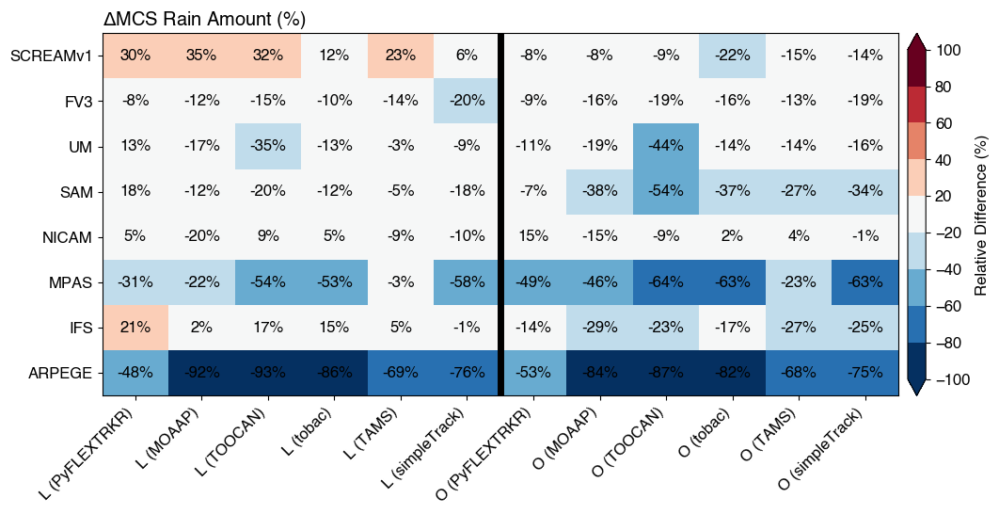

In [112]:
data_arr = mcspcp_diffpercent_all.transpose()
titles = f'$\Delta$MCS Rain Amount (%)'
levels = np.arange(-100, 101, 20)
levels = np.delete(levels, int((len(levels)-1)/2))
cbticks = np.arange(-100, 101, 20)
cbticks = np.delete(cbticks, int((len(cbticks)-1)/2))
cblabels = 'Relative Difference (%)'
cmap = 'RdBu_r'
xlabels = region_names_all
ylabels = list(name_map.values())[1:]
figsize = [13,5]
fontsize = 12
figname = f'{figdir}RelativeDiffHeatmap_mcs_rain_tropics_all.png'
fig = shade_bias(data_arr, titles=titles, xlabels=xlabels, ylabels=ylabels, xlabel_rotation=45,
                 levels=levels, cmap=cmap, cbticks=cbticks, cblabels=cblabels, figname=figname, figsize=figsize, fontsize=fontsize)

In [113]:
# data_arr = mcspcp_diffpercent_all.transpose()
# titles = f'$\Delta$MCS Rain Amount (%)'
# levels = np.arange(-100, 101, 20)
# levels = np.delete(levels, int((len(levels)-1)/2))
# cbticks = np.arange(-100, 101, 20)
# cbticks = np.delete(cbticks, int((len(cbticks)-1)/2))
# cblabels = 'Relative Difference (%)'
# cmap = 'RdBu_r'
# xlabels = region_names_all
# ylabels = list(name_map.values())[1:]
# figsize = [13,5]
# fontsize = 12
# figname = f'{figdir}RelativeDiffHeatmap_mcs_rain_tropics_all.png'
# fig = shade_bias(data_arr, titles=titles, xlabels=xlabels, ylabels=ylabels, xlabel_rotation=45,
#                  levels=levels, cmap=cmap, cbticks=cbticks, cblabels=cblabels, figname=figname, figsize=figsize, fontsize=fontsize)

In [114]:
# data_arr = mcspcpfrac_diffpercent_all.transpose()
# titles = f'$\Delta$MCS Rain Fraction (%)'
# levels = np.arange(-50, 51, 10)
# levels = np.delete(levels, int((len(levels)-1)/2))
# cbticks = levels
# cblabels = 'Relative Difference (%)'
# cmap = 'RdBu_r'
# xlabels = region_names_all
# ylabels = list(name_map.values())[1:]
# figsize = [13,5]
# fontsize = 12
# figname = f'{figdir}RelativeDiffHeatmap_mcs_rainfrac_tropics_all.png'
# fig = shade_bias(data_arr, titles=titles, xlabels=xlabels, ylabels=ylabels, xlabel_rotation=45,
#                  levels=levels, cmap=cmap, cbticks=cbticks, cblabels=cblabels, figname=figname, figsize=figsize, fontsize=fontsize)

In [115]:
# data_arr = mcscloudfreq_diffpercent_all.transpose()
# titles = f'$\Delta$MCS Cloud Frequency (%)'
# levels = np.arange(-100, 101, 20)
# levels = np.delete(levels, int((len(levels)-1)/2))
# cbticks = levels
# cblabels = 'Relative Difference (%)'
# cmap = 'RdBu_r'
# xlabels = region_names_all
# ylabels = list(name_map.values())[1:]
# figsize = [13,5]
# fontsize = 12
# figname = f'{figdir}RelativeDiffHeatmap_mcs_cloudfreq_tropics_all.png'
# fig = shade_bias(data_arr, titles=titles, xlabels=xlabels, ylabels=ylabels, xlabel_rotation=45,
#                  levels=levels, cmap=cmap, cbticks=cbticks, cblabels=cblabels, figname=figname, figsize=figsize, fontsize=fontsize)

In [116]:
# data_arr = mcspcpfreq_diffpercent_all.transpose()
# titles = f'$\Delta$MCS Rain Frequency (%)'
# levels = np.arange(-100, 101, 20)
# levels = np.delete(levels, int((len(levels)-1)/2))
# cbticks = levels
# cblabels = 'Relative Difference (%)'
# cmap = 'RdBu_r'
# xlabels = region_names_all
# ylabels = list(name_map.values())[1:]
# figsize = [13,5]
# fontsize = 12
# figname = f'{figdir}RelativeDiffHeatmap_mcs_rainfreq_tropics_all.png'
# fig = shade_bias(data_arr, titles=titles, xlabels=xlabels, ylabels=ylabels, xlabel_rotation=45,
#                  levels=levels, cmap=cmap, cbticks=cbticks, cblabels=cblabels, figname=figname, figsize=figsize, fontsize=fontsize)

In [117]:
# data_arr = mcspcp_diffpercent_all
# titles = f'$\Delta$MCS Rain Amount (%)'
# levels = np.arange(-100, 101, 20)
# levels = np.delete(levels, int((len(levels)-1)/2))
# cbticks = np.arange(-100, 101, 20)
# cbticks = np.delete(cbticks, int((len(cbticks)-1)/2))
# cblabels = 'Relative Difference (%)'
# cmap = 'RdBu_r'
# ylabels = region_names_all
# xlabels = list(name_map.values())[1:]
# figsize = [13,5]
# fontsize = 12
# figname = f'{figdir}RelativeDiffHeatmap_mcs_rain_tropics_all.png'
# fig = shade_bias(data_arr, titles=titles, xlabels=xlabels, ylabels=ylabels, 
#                  levels=levels, cmap=cmap, cbticks=cbticks, cblabels=cblabels, figname=figname, figsize=figsize, fontsize=fontsize)

In [118]:
# data_arr = mcspcpfrac_diffpercent_all
# titles = f'$\Delta$MCS Rain Fraction (%)'
# levels = np.arange(-50, 51, 10)
# levels = np.delete(levels, int((len(levels)-1)/2))
# cbticks = levels
# cblabels = 'Relative Difference (%)'
# cmap = 'RdBu_r'
# ylabels = region_names_all
# xlabels = list(name_map.values())[1:]
# figsize = [13,5]
# fontsize = 12
# figname = f'{figdir}RelativeDiffHeatmap_mcs_rainfrac_tropics_all.png'
# fig = shade_bias(data_arr, titles=titles, xlabels=xlabels, ylabels=ylabels, 
#                  levels=levels, cmap=cmap, cbticks=cbticks, cblabels=cblabels, figname=figname, figsize=figsize, fontsize=fontsize)

In [119]:
# data_arr = mcscloudfreq_diffpercent_all
# titles = f'$\Delta$MCS Cloud Frequency (%)'
# levels = np.arange(-100, 101, 20)
# levels = np.delete(levels, int((len(levels)-1)/2))
# cbticks = levels
# cblabels = 'Relative Difference (%)'
# cmap = 'RdBu_r'
# ylabels = region_names_all
# xlabels = list(name_map.values())[1:]
# figsize = [13,5]
# fontsize = 12
# figname = f'{figdir}RelativeDiffHeatmap_mcs_cloudfreq_tropics_all.png'
# fig = shade_bias(data_arr, titles=titles, xlabels=xlabels, ylabels=ylabels, 
#                  levels=levels, cmap=cmap, cbticks=cbticks, cblabels=cblabels, figname=figname, figsize=figsize, fontsize=fontsize)

In [120]:
# data_arr = mcspcpfreq_diffpercent_all
# titles = f'$\Delta$MCS Rain Frequency (%)'
# levels = np.arange(-100, 101, 20)
# levels = np.delete(levels, int((len(levels)-1)/2))
# cbticks = levels
# cblabels = 'Relative Difference (%)'
# cmap = 'RdBu_r'
# ylabels = region_names_all
# xlabels = list(name_map.values())[1:]
# figsize = [13,5]
# fontsize = 12
# figname = f'{figdir}RelativeDiffHeatmap_mcs_rainfreq_tropics_all.png'
# fig = shade_bias(data_arr, titles=titles, xlabels=xlabels, ylabels=ylabels, 
#                  levels=levels, cmap=cmap, cbticks=cbticks, cblabels=cblabels, figname=figname, figsize=figsize, fontsize=fontsize)

# Function to plot map, bar charts, and heatmap (relative difference)

In [121]:
def plot_map_bars_heatmap(data_map, lon, lat, titles, levels, cmaps, cblabels, cbticks, figname, 
                  oob_colors=None, contourf=False, figsize=None, fontsize=None, cb_fontsize=None,
                  boxes=None, boxtextloc=None, boxtext=None, boxtexttype=None, text_colors=None,
                  bar_data=None, bar_width=None, bar_ylabel=None, legend_prop=None, bar_ylim=None, bar_xlabels=None, bar_xlabel_rotation=0,
                  heatmap_data=None, xlabels=None, ylabels=None, xlabel_rotation=0):
                  # boxes=None, boxtextloc=None, dict_text_type=None, dict_text_val=None, text_colors=None, boxtext_fontsize=None):
    
    mpl.rcParams['font.size'] = fontsize
    mpl.rcParams['font.family'] = 'Helvetica'

    ###################################################
    # Map plot
    ###################################################
    map_extent = [-180., 179.5, -60.1, 60.1]
    lonv = np.arange(-180,180.1,30)
    latv = np.arange(-60,60.1,15)
    proj = ccrs.PlateCarree(central_longitude=0)
    data_proj = ccrs.PlateCarree()
    levelshgt = [1000,10000]

    fig = plt.figure(figsize=figsize, dpi=100)
    # h_ratios = [0.05, 1, 1]
    # gs = gridspec.GridSpec(3, 1, height_ratios=h_ratios, width_ratios=[1])
    # gs.update(left=0.05, right=0.88, bottom=0.1, top=0.9, wspace=0.05, hspace=0.25)
    h_ratios = [1, 1, 1]
    w_ratios = [1, 0.02]
    gs = gridspec.GridSpec(3, 2, height_ratios=h_ratios, width_ratios=w_ratios)
    gs.update(left=0.05, right=0.85, bottom=0.1, top=0.95, wspace=0.05, hspace=0.35)

    resolution = '110m'
    land = cfeature.NaturalEarthFeature('physical', 'land', resolution)
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', resolution)
    borders = cfeature.NaturalEarthFeature('cultural', 'admin_0_boundary_lines_land', resolution)
    
    ax = plt.subplot(gs[0,0], projection=proj)
    ax.set_extent(map_extent, crs=proj)
    ax.add_feature(land, facecolor='none', edgecolor='k', zorder=3)
    ax.set_aspect('auto', adjustable=None)
    ax.set_title(titles[0], loc='left')
    
    # Grid lines & labels
    gl = ax.gridlines(crs=proj, draw_labels=False, linestyle='--', linewidth=0.5)
    gl.xlocator = mpl.ticker.FixedLocator(lonv)
    gl.ylocator = mpl.ticker.FixedLocator(latv)         
    # if (row == nrow-1):
    ax.set_xticks(lonv, crs=data_proj)
    lon_formatter = LongitudeFormatter(zero_direction_label=True)
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.set_yticks(latv, crs=data_proj)
    lat_formatter = LatitudeFormatter()
    ax.yaxis.set_major_formatter(lat_formatter)

    # Terrain height
    ct = ax.contour(lon_ter, lat_ter, ter_s, levels=[1000,1001], \
                    colors='dimgray', linewidths=1, transform=data_proj, zorder=3)
    
    # Select and mask data source
    Zm = np.ma.masked_where(np.isnan(data_map), data_map)
    cmap = copy.copy(mpl.colormaps.get_cmap(cmaps[0]))
    # Set out-of-bounds colors
    if oob_colors is not None:
        cmap.set_over(oob_colors['over'])
        cmap.set_under(oob_colors['under'])
        # cf1.set_clim(min(levels), max(levels))
    norm = colors.BoundaryNorm(boundaries=levels[0], ncolors=cmap.N)
    # Plot data
    if (contourf == False):
        cf1 = ax.pcolormesh(lon, lat, Zm, shading='auto', norm=norm, cmap=cmap, transform=data_proj, zorder=2)
    else:
        cf1 = ax.contourf(lon, lat, Zm, levels=levels, norm=norm, cmap=cmap, transform=data_proj, extend='both', zorder=2)
           
    # Plot boxes
    if boxes is not None:
        for ii in boxes:
            # Plot region boxes
            corners = [[boxes[ii][0],boxes[ii][2]], [boxes[ii][1],boxes[ii][2]], [boxes[ii][1],boxes[ii][3]], [boxes[ii][0],boxes[ii][3]]]
            box = Polygon(corners, edgecolor='k', facecolor='none', lw=2, transform=data_proj, zorder=10)
            ax.add_patch(box)

            if boxtexttype is None:
                text_color = text_colors['pos'] if (boxtext[ii] >=0) else text_colors['neg']
                ax.text(boxtextloc[ii][0], boxtextloc[ii][1], f"{boxtext[ii]:.00f}%", ha='center',
                        bbox=dict(facecolor='w', alpha=0.8, edgecolor=text_color),
                        fontsize=12, fontweight='bold', color=text_color, transform=data_proj, zorder=4)
            else:
                text_color = 'k'
                ax.text(boxtextloc[ii][0], boxtextloc[ii][1], f"{boxtext[ii]}", ha='center',
                        bbox=dict(facecolor='w', alpha=0.8, edgecolor=text_color),
                        fontsize=12, fontweight='bold', color=text_color, transform=data_proj, zorder=4)

    
    ###################################################
    # Bar chart
    ###################################################
    ax2 = plt.subplot(gs[1,0])
    # labels = list(boxes.keys())
    x = np.arange(len(bar_xlabels))
    # multiplier = -((len(name_map)-1)/2)
    multiplier = -((len(bar_data))/2)
    lcolors = {
        'obs': 'k', 
        'm1': 'crimson',
        'm2': 'darkorange', 
        'm3': 'gold',
        'm4': 'green',
        'm5': 'turquoise',
        'm6': 'lime',
        'm7': 'blue',
        'm8': 'deepskyblue',
        'm9': 'purple',
        'm10': 'violet',
        'm11': 'deeppink',
        'm12': 'dodgerblue',
    }

    # Loop over each source    
    for key, val in bar_data.items():
        offset = bar_width * multiplier
        rects = ax2.bar(x + offset, val, bar_width, color=lcolors[key], label=name_map[key], zorder=2)
        multiplier += 1    

    # Add some text for xlabels, title and custom x-axis tick xlabels, etc.
    ax2.set_ylabel(bar_ylabel)
    ax2.set_title(titles[1], loc='left')
    # ax2.set_xticks(x, bar_xlabels)
    # Set xlabel text alignment
    xlabel_ha = 'right' if bar_xlabel_rotation > 0 else 'center'
    ax2.set_xticks(x, bar_xlabels, rotation=bar_xlabel_rotation, ha=xlabel_ha)
    
    ax2.legend(ncol=legend_prop['ncol'], fontsize=legend_prop['fontsize'], loc=legend_prop['legend_loc'], bbox_to_anchor=legend_prop['legend_anchor'])
    ax2.axhline(y=0, lw=1, ls='--', color='k')
    ax2.grid(which='major', ls='--', axis='y')
    ax2.set_ylim(bar_ylim[0], bar_ylim[1])
    
    # Shade the background with colors
    # Get x-axis limits
    xmin, xmax = ax2.get_xlim()
    midpoint = (xmin + xmax) / 2
    ax2.axvspan(xmin, midpoint, facecolor='antiquewhite', alpha=0.6)
    ax2.axvspan(midpoint, xmax, facecolor='lightcyan', alpha=0.6)
    ax2.set_xlim(xmin, xmax)
    
    ax2.text(0.25, 0.9, 'Land', ha='center', va='center', color='saddlebrown', fontweight='bold', fontsize=fontsize*1.5, transform=ax2.transAxes)
    ax2.text(0.75, 0.9, 'Ocean', ha='center', va='center', color='royalblue', fontweight='bold', fontsize=fontsize*1.5, transform=ax2.transAxes)
    
    # # Plot a vertical line in the middle of the axis
    # xmin, xmax = ax2.get_xlim()
    # midpoint = (xmin + xmax) / 2
    # ax2.axvline(x=midpoint, lw=3, color='k', ls='--')
    
    ###################################################
    # Heatmap
    ###################################################
    ax3 = plt.subplot(gs[2,0])
    # Shade the background with colors
    cmap = copy.copy(mpl.colormaps.get_cmap(cmaps[1]))
    norm = mpl.colors.BoundaryNorm(boundaries=levels[1], ncolors=cmap.N)
    pcm3 = ax3.pcolormesh(heatmap_data, norm=norm, cmap=cmap)
    ax3.set_title(titles[2], loc='left')
    # Colorbar
    # fig.colorbar(pcm, label=cblabels, ticks=cbticks, extend='both', pad=0.01, shrink=cbshrink)

    # Axis labels
    n_xlabels = len(xlabels)
    n_ylabels = len(ylabels)
    x_centers = np.arange(0.5, n_xlabels+0.5, 1)
    y_centers = np.arange(0.5, n_ylabels+0.5, 1)
    xlabel_ha = 'right' if xlabel_rotation > 0 else 'center'
    # ax.set_xticks(x, xlabels, rotation=xlabel_rotation, ha=xlabel_ha)
    ax3.set_xticks(x_centers, xlabels, rotation=xlabel_rotation, ha=xlabel_ha)
    ax3.set_yticks(y_centers, ylabels)
   
    # Plot a vertical line in the middle of the axis
    xmin, xmax = ax3.get_xlim()
    midpoint = (xmin + xmax) / 2
    ax3.axvline(x=midpoint, lw=5, color='k')

    # Add text annotations at the center of each cell
    for i, x in enumerate(x_centers):
        for j, y in enumerate(y_centers):
            ax3.annotate(f'{heatmap_data[j, i]:.0f}%', (x, y), color='k', fontsize=fontsize, ha='center', va='center')
    
    # Colorbars
    cax1 = plt.subplot(gs[0,1])
    cax3 = plt.subplot(gs[2,1])
    cb1 = plt.colorbar(cf1, cax=cax1, label=cblabels[0], ticks=cbticks[0], orientation='vertical', extend='both')
    cb3 = plt.colorbar(pcm3, cax=cax3, label=cblabels[1], ticks=cbticks[1], extend='both')
    cb1.ax.tick_params(labelsize=cb_fontsize)
    cb3.ax.tick_params(labelsize=cb_fontsize)
    
    fig.savefig(figname, dpi=300, bbox_inches='tight', facecolor='w')
    return fig

In [122]:
if PHASE == 'Summer':
    panel_numbers = ['(a)', '(c)', '(e)']
elif PHASE == 'Winter':
    panel_numbers = ['(b)', '(d)', '(f)']
print(panel_numbers)

['(a)', '(c)', '(e)']


/global/cfs/cdirs/m1867/zfeng/MCSMIP/DYAMOND/Summer/figures/MCSMIP/globalmap_mcs_cloudfreq_obs_barchart_heatmap_diff.png


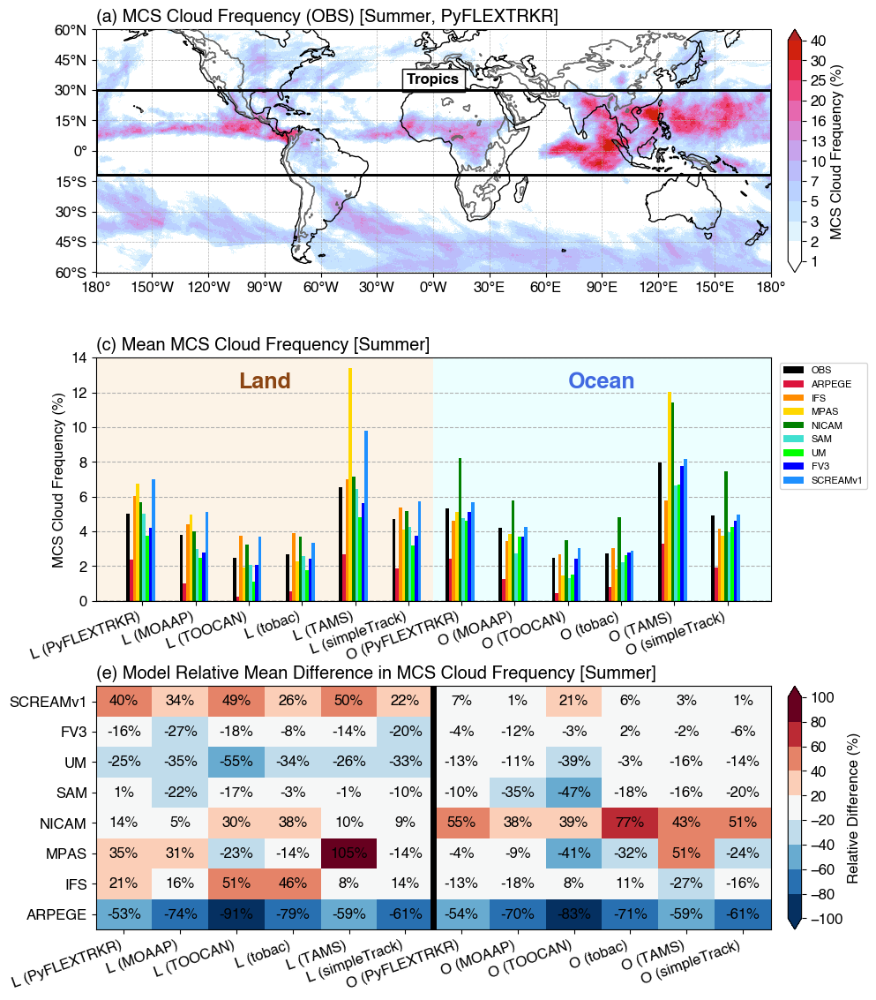

In [123]:
figsize = [10,12]
fontsize = 12
cb_fontsize = 12
varname1 = 'MCS Cloud Frequency'
varname2 = 'MCS Cloud Frequency'
units = '%'

# Map data
data_dict = mcscloudfreq_obs_pyflex
lev1 = [1,2,3,5,7,10,13,16,20,25,30,40]
lev2 = np.arange(-100, 101, 20)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
levels = [lev1, lev2]
cbticks = levels
cmap1 = cc.cm.CET_L19
cmap2 = copy.copy(mpl.colormaps.get_cmap('RdBu_r'))
cmaps = [cmap1, cmap2]
titles = [
    f'{panel_numbers[0]} {varname1} (OBS) [{PHASE}, PyFLEXTRKR]', 
    f'{panel_numbers[1]} Mean {varname1} [{PHASE}]', 
    f'{panel_numbers[2]} Model Relative Mean Difference in {varname1} [{PHASE}]'
]
oob_colors = {'under':'white', 'over':'firebrick'}
cblabels = [f'{varname1} ({units})', 'Relative Difference (%)']
text_colors = None
text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# Bar chart data
bar_data = dict_mcscloudfreqAvg_lo
bar_xlabels = region_names_all
bar_ylabel = f'{varname2} (%)'
bar_ylim = (0,14)
bar_width = 0.06
# legend_prop = {'ncol':len(name_map), 'fontsize':8, 'legend_loc':'upper right', 'legend_anchor':(1.1, 1.2)}
legend_prop = {'ncol':1, 'fontsize':8, 'legend_loc':'upper right', 'legend_anchor':(1.15, 1.)}
bar_xlabel_rotation = 20

# Heatmap data
heatmap_data = mcscloudfreq_diffpercent_all.transpose()
xlabels = region_names_all
ylabels = list(name_map.values())[1:]
xlabel_rotation = 20

figname = f'{figdir}globalmap_mcs_cloudfreq_obs_barchart_heatmap_diff.png'
print(figname)
fig = plot_map_bars_heatmap(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                    figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
                    boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
                    bar_data=bar_data, bar_width=bar_width, bar_ylabel=bar_ylabel, legend_prop=legend_prop, bar_ylim=bar_ylim, bar_xlabels=bar_xlabels, bar_xlabel_rotation=bar_xlabel_rotation, 
                    heatmap_data=heatmap_data, xlabels=xlabels, ylabels=ylabels, xlabel_rotation=xlabel_rotation)

/global/cfs/cdirs/m1867/zfeng/MCSMIP/DYAMOND/Summer/figures/MCSMIP/globalmap_mcs_rain_obs_barchart_heatmap_diff.png


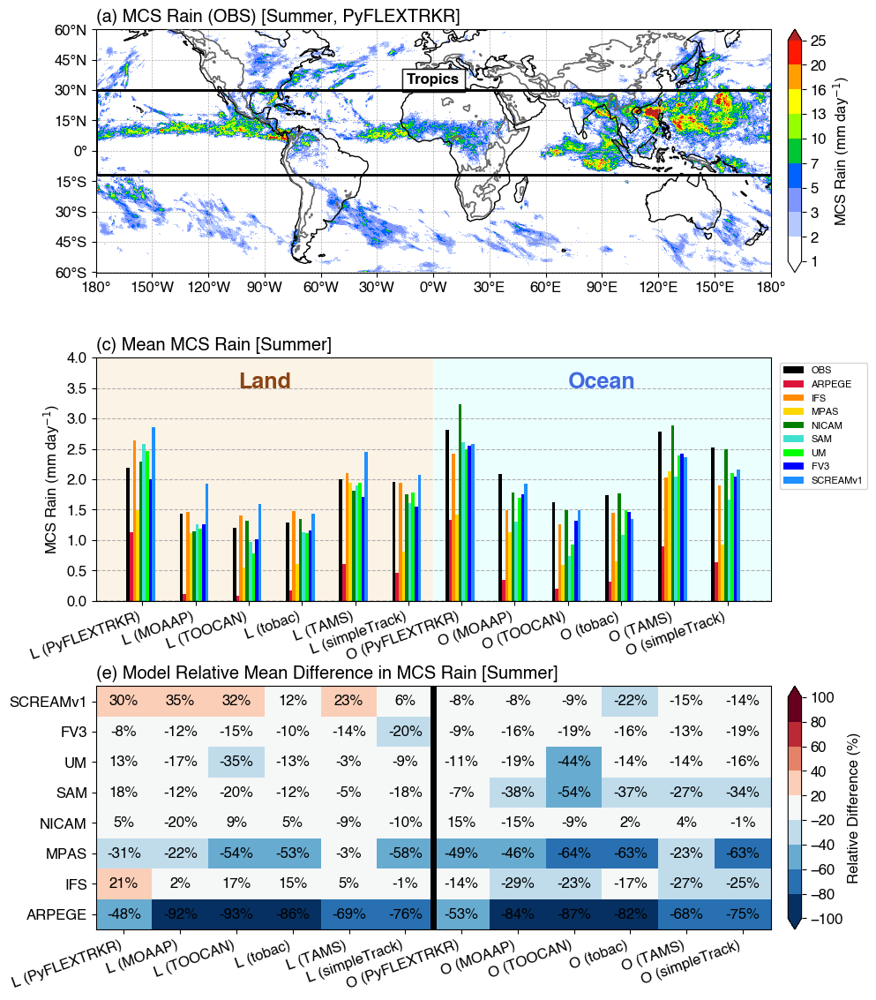

In [124]:
figsize = [10,12]
fontsize = 12
cb_fontsize = 12
varname1 = 'MCS Rain'
varname2 = 'MCS Rain'
units = 'mm day$^{-1}$'

# Map data
data_dict = mcspcp_obs_pyflex
lev1 = [1,2,3,5,7,10,13,16,20,25]
lev2 = np.arange(-100, 101, 20)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
levels = [lev1, lev2]
cbticks = levels
cmap1 = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
cmap2 = copy.copy(mpl.colormaps.get_cmap('RdBu_r'))
cmaps = [cmap1, cmap2]
titles = [
    f'{panel_numbers[0]} {varname1} (OBS) [{PHASE}, PyFLEXTRKR]', 
    f'{panel_numbers[1]} Mean {varname1} [{PHASE}]', 
    f'{panel_numbers[2]} Model Relative Mean Difference in {varname1} [{PHASE}]'
]
oob_colors = {'under':'white', 'over':'firebrick'}
cblabels = [f'{varname1} ({units})', 'Relative Difference (%)']
text_colors = None
text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# Bar chart data
bar_data = dict_mcspcpAvg_lo
bar_xlabels = region_names_all
bar_ylabel = f'{varname2} ({units})'
bar_ylim = (0,4)
bar_width = 0.06
# legend_prop = {'ncol':len(name_map), 'fontsize':8, 'legend_loc':'upper right', 'legend_anchor':(1.1, 1.2)}
legend_prop = {'ncol':1, 'fontsize':8, 'legend_loc':'upper right', 'legend_anchor':(1.15, 1.)}
bar_xlabel_rotation = 20

# Heatmap data
heatmap_data = mcspcp_diffpercent_all.transpose()
xlabels = region_names_all
ylabels = list(name_map.values())[1:]

figname = f'{figdir}globalmap_mcs_rain_obs_barchart_heatmap_diff.png'
print(figname)
fig = plot_map_bars_heatmap(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                    figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
                    boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
                    bar_data=bar_data, bar_width=bar_width, bar_ylabel=bar_ylabel, legend_prop=legend_prop, bar_ylim=bar_ylim, bar_xlabels=bar_xlabels, bar_xlabel_rotation=bar_xlabel_rotation, 
                    heatmap_data=heatmap_data, xlabels=xlabels, ylabels=ylabels, xlabel_rotation=xlabel_rotation)

/global/cfs/cdirs/m1867/zfeng/MCSMIP/DYAMOND/Summer/figures/MCSMIP/globalmap_mcs_rainfrac_obs_barchart_heatmap_diff.png


/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


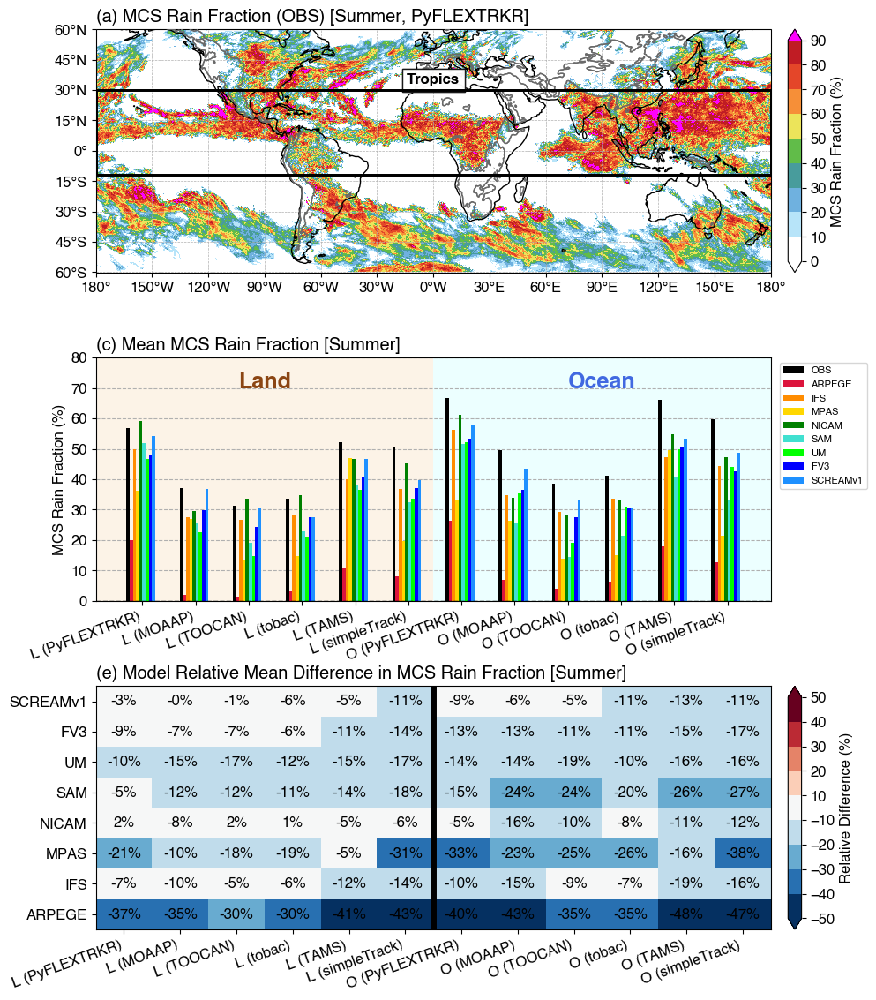

In [125]:
figsize = [10,12]
fontsize = 12
cb_fontsize = 12
varname1 = 'MCS Rain Fraction'
varname2 = 'MCS Rain Fraction'
units = '%'

# Map data
data_dict = mcspcpfrac_obs_pyflex
lev1 = np.arange(0, 90.01, 10)
lev2 = np.arange(-50, 51, 10)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
levels = [lev1, lev2]
cbticks = levels
cmap1 = generate_NCL_cmap('WhiteBlueGreenYellowRed')
cmap1 = truncate_colormap(cmap1, 0.0, 0.9)
cmap2 = copy.copy(mpl.colormaps.get_cmap('RdBu_r'))
cmaps = [cmap1, cmap2]
titles = [
    f'{panel_numbers[0]} {varname1} (OBS) [{PHASE}, PyFLEXTRKR]', 
    f'{panel_numbers[1]} Mean {varname1} [{PHASE}]', 
    f'{panel_numbers[2]} Model Relative Mean Difference in {varname1} [{PHASE}]'
]
oob_colors = {'under':'white', 'over':'magenta'}
cblabels = [f'{varname1} ({units})', 'Relative Difference (%)']
text_colors = None
text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# Bar chart data
bar_data = dict_mcspcpfracAvg_lo
bar_xlabels = region_names_all
bar_ylabel = f'{varname2} ({units})'
bar_ylim = (0,80)
bar_width = 0.06
# legend_prop = {'ncol':len(name_map), 'fontsize':8, 'legend_loc':'upper right', 'legend_anchor':(1.1, 1.2)}
legend_prop = {'ncol':1, 'fontsize':8, 'legend_loc':'upper right', 'legend_anchor':(1.15, 1.)}
bar_xlabel_rotation = 20

# Heatmap data
heatmap_data = mcspcpfrac_diffpercent_all.transpose()
xlabels = region_names_all
ylabels = list(name_map.values())[1:]

figname = f'{figdir}globalmap_mcs_rainfrac_obs_barchart_heatmap_diff.png'
print(figname)
fig = plot_map_bars_heatmap(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                    figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
                    boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
                    bar_data=bar_data, bar_width=bar_width, bar_ylabel=bar_ylabel, legend_prop=legend_prop, bar_ylim=bar_ylim, bar_xlabels=bar_xlabels, bar_xlabel_rotation=bar_xlabel_rotation, 
                    heatmap_data=heatmap_data, xlabels=xlabels, ylabels=ylabels, xlabel_rotation=xlabel_rotation)

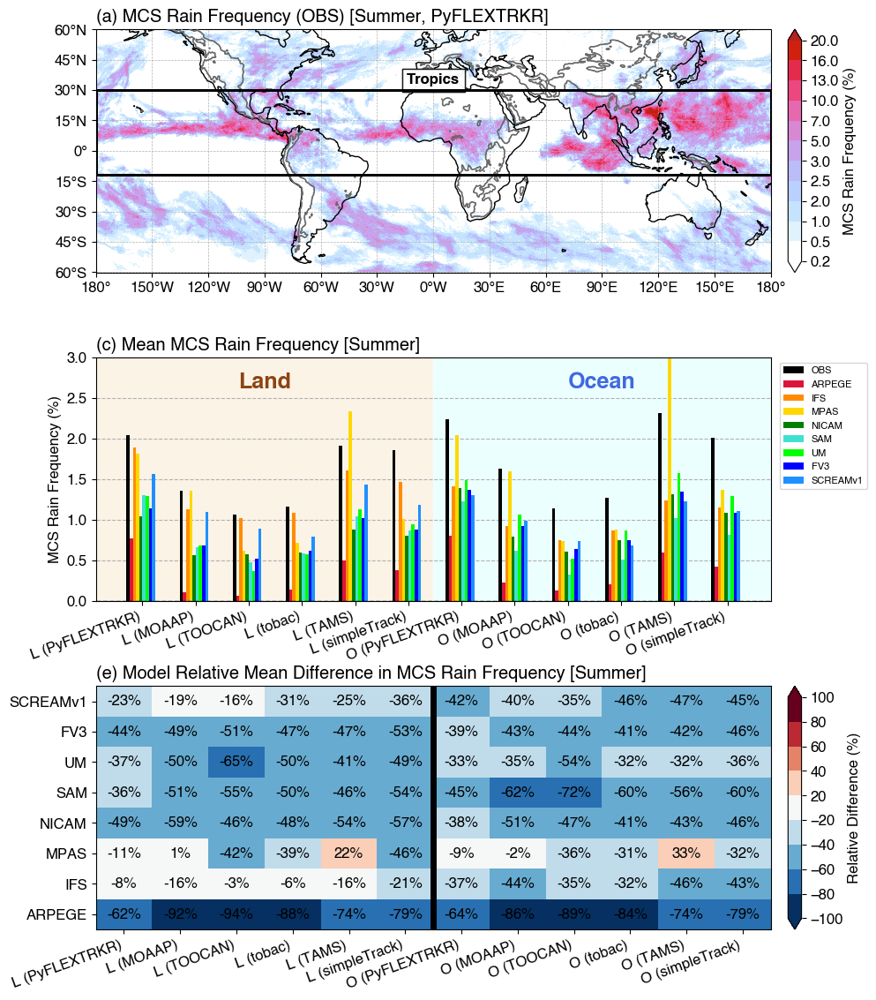

In [126]:
figsize = [10,12]
fontsize = 12
cb_fontsize = 12
varname1 = 'MCS Rain Frequency'
varname2 = 'MCS Rain Frequency'
units = '%'

# Map data
data_dict = mcspcpfreq_obs_pyflex
lev1 = [0.2,0.5,1,2,2.5,3,5,7,10,13,16,20]
lev2 = np.arange(-100, 101, 20)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
levels = [lev1, lev2]
cbticks = levels
cmap1 = cc.cm.CET_L19
cmap2 = copy.copy(mpl.colormaps.get_cmap('RdBu_r'))
cmaps = [cmap1, cmap2]
titles = [
    f'{panel_numbers[0]} {varname1} (OBS) [{PHASE}, PyFLEXTRKR]', 
    f'{panel_numbers[1]} Mean {varname1} [{PHASE}]', 
    f'{panel_numbers[2]} Model Relative Mean Difference in {varname1} [{PHASE}]'
]
oob_colors = {'under':'white', 'over':'firebrick'}
cblabels = [f'{varname1} ({units})', 'Relative Difference (%)']
text_colors = None
text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# Bar chart data
bar_data = dict_mcspcpfreqAvg_lo
bar_xlabels = region_names_all
bar_ylabel = f'{varname2} ({units})'
bar_ylim = (0,3)
bar_width = 0.06
# legend_prop = {'ncol':len(name_map), 'fontsize':8, 'legend_loc':'upper right', 'legend_anchor':(1.1, 1.2)}
legend_prop = {'ncol':1, 'fontsize':8, 'legend_loc':'upper right', 'legend_anchor':(1.15, 1.)}
bar_xlabel_rotation = 20

# Heatmap data
heatmap_data = mcspcpfreq_diffpercent_all.transpose()
xlabels = region_names_all
ylabels = list(name_map.values())[1:]

figname = f'{figdir}globalmap_mcs_rainfreq_obs_barchart_heatmap_diff.png'

fig = plot_map_bars_heatmap(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                    figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
                    boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
                    bar_data=bar_data, bar_width=bar_width, bar_ylabel=bar_ylabel, legend_prop=legend_prop, bar_ylim=bar_ylim, bar_xlabels=bar_xlabels, bar_xlabel_rotation=bar_xlabel_rotation, 
                    heatmap_data=heatmap_data, xlabels=xlabels, ylabels=ylabels, xlabel_rotation=xlabel_rotation)

## Function to plot 1 map and heatmap (relative difference)

In [127]:
def plot_map_heatmap(data_map, lon, lat, titles, levels, cmaps, cblabels, cbticks, figname, 
                  oob_colors=None, contourf=False, figsize=None, fontsize=None, cb_fontsize=None,
                  boxes=None, boxtextloc=None, boxtext=None, boxtexttype=None, text_colors=None,
                  heatmap_data=None, xlabels=None, ylabels=None,):
    
    mpl.rcParams['font.size'] = fontsize
    mpl.rcParams['font.family'] = 'Helvetica'

    ###################################################
    # Map plot
    ###################################################
    map_extent = [-180., 179.5, -60.1, 60.1]
    lonv = np.arange(-180,180.1,30)
    latv = np.arange(-60,60.1,15)
    proj = ccrs.PlateCarree(central_longitude=0)
    data_proj = ccrs.PlateCarree()
    levelshgt = [1000,10000]

    fig = plt.figure(figsize=figsize, dpi=100)
    h_ratios = [1, 1]
    w_ratios = [1, 0.02]
    gs = gridspec.GridSpec(2, 2, height_ratios=h_ratios, width_ratios=w_ratios)
    gs.update(left=0.05, right=0.85, bottom=0.1, top=0.95, wspace=0.05, hspace=0.2)

    resolution = '110m'
    land = cfeature.NaturalEarthFeature('physical', 'land', resolution)
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', resolution)
    borders = cfeature.NaturalEarthFeature('cultural', 'admin_0_boundary_lines_land', resolution)
    
    ax = plt.subplot(gs[0,0], projection=proj)
    ax.set_extent(map_extent, crs=proj)
    ax.add_feature(land, facecolor='none', edgecolor='k', zorder=3)
    ax.set_aspect('auto', adjustable=None)
    ax.set_title(titles[0], loc='left')
    
    # Grid lines & labels
    gl = ax.gridlines(crs=proj, draw_labels=False, linestyle='--', linewidth=0.5)
    gl.xlocator = mpl.ticker.FixedLocator(lonv)
    gl.ylocator = mpl.ticker.FixedLocator(latv)         
    # if (row == nrow-1):
    ax.set_xticks(lonv, crs=data_proj)
    lon_formatter = LongitudeFormatter(zero_direction_label=True)
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.set_yticks(latv, crs=data_proj)
    lat_formatter = LatitudeFormatter()
    ax.yaxis.set_major_formatter(lat_formatter)

    # Terrain height
    ct = ax.contour(lon_ter, lat_ter, ter_s, levels=[1000,1001], \
                    colors='dimgray', linewidths=1, transform=data_proj, zorder=3)
    
    # Select and mask data source
    Zm = np.ma.masked_where(np.isnan(data_map), data_map)
    cmap = copy.copy(mpl.colormaps.get_cmap(cmaps[0]))
    # Set out-of-bounds colors
    if oob_colors is not None:
        cmap.set_over(oob_colors['over'])
        cmap.set_under(oob_colors['under'])
        # cf1.set_clim(min(levels), max(levels))
    norm = colors.BoundaryNorm(boundaries=levels[0], ncolors=cmap.N)
    # Plot data
    if (contourf == False):
        cf1 = ax.pcolormesh(lon, lat, Zm, shading='auto', norm=norm, cmap=cmap, transform=data_proj, zorder=2)
    else:
        cf1 = ax.contourf(lon, lat, Zm, levels=levels, norm=norm, cmap=cmap, transform=data_proj, extend='both', zorder=2)
           
    # Plot boxes
    if boxes is not None:
        for ii in boxes:
            # Plot region boxes
            corners = [[boxes[ii][0],boxes[ii][2]], [boxes[ii][1],boxes[ii][2]], [boxes[ii][1],boxes[ii][3]], [boxes[ii][0],boxes[ii][3]]]
            box = Polygon(corners, edgecolor='k', facecolor='none', lw=2, transform=data_proj, zorder=10)
            ax.add_patch(box)

            if boxtexttype is None:
                text_color = text_colors['pos'] if (boxtext[ii] >=0) else text_colors['neg']
                ax.text(boxtextloc[ii][0], boxtextloc[ii][1], f"{boxtext[ii]:.00f}%", ha='center',
                        bbox=dict(facecolor='w', alpha=0.8, edgecolor=text_color),
                        fontsize=12, fontweight='bold', color=text_color, transform=data_proj, zorder=4)
            else:
                text_color = 'k'
                ax.text(boxtextloc[ii][0], boxtextloc[ii][1], f"{boxtext[ii]}", ha='center',
                        bbox=dict(facecolor='w', alpha=0.8, edgecolor=text_color),
                        fontsize=12, fontweight='bold', color=text_color, transform=data_proj, zorder=4)

    
    ###################################################
    # Heatmap plot
    ###################################################
    ax2 = plt.subplot(gs[1,0])
    cmap = copy.copy(mpl.colormaps.get_cmap(cmaps[1]))
    norm = mpl.colors.BoundaryNorm(boundaries=levels[1], ncolors=cmap.N)
    pcm2 = ax2.pcolormesh(heatmap_data, norm=norm, cmap=cmap)
    ax2.set_title(titles[1], loc='left')
    
    # Axis labels
    n_xlabels = len(xlabels)
    n_ylabels = len(ylabels)
    x_centers = np.arange(0.5, n_xlabels+0.5, 1)
    y_centers = np.arange(0.5, n_ylabels+0.5, 1)
    ax2.set_xticks(x_centers, xlabels, rotation=90)
    ax2.set_yticks(y_centers, ylabels)
    # Add a horizontal line to divide regions
    # Get x-axis limits
    ymin, ymax = ax2.get_ylim()
    midpoint = (ymin + ymax) / 2
    ax2.axhline(y=midpoint, lw=5, color='k')

    # Add text annotations at the center of each cell
    for i, x in enumerate(x_centers):
        for j, y in enumerate(y_centers):
            ax2.annotate(f'{heatmap_data[j, i]:.0f}%', (x, y), color='k', fontsize=fontsize, ha='center', va='center')
            
    # Colorbars
    cax1 = plt.subplot(gs[0,1])
    cax2 = plt.subplot(gs[1,1])
    cb1 = plt.colorbar(cf1, cax=cax1, label=cblabels[0], ticks=cbticks[0], orientation='vertical', extend='both')
    cb2 = plt.colorbar(pcm2, cax=cax2, label=cblabels[1], ticks=cbticks[1], extend='both')
    cb1.ax.tick_params(labelsize=cb_fontsize)
    cb2.ax.tick_params(labelsize=cb_fontsize)
              
    fig.savefig(figname, dpi=300, bbox_inches='tight', facecolor='w')
    return fig

In [128]:
# figsize = [12,9]
# fontsize = 12
# cb_fontsize = 12
# varname1 = 'MCS Rain'
# varname2 = '$\Delta$MCS Rain'
# units = 'mm day$^{-1}$'

# # Map data
# data_dict = mcspcp_obs_pyflex
# lev1 = [1,2,3,5,7,10,13,16,20,25]
# lev2 = np.arange(-100, 101, 20)
# lev2 = np.delete(lev2, int((len(lev2)-1)/2))
# levels = [lev1, lev2]
# cbticks = levels
# cmap1 = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
# cmap2 = copy.copy(mpl.colormaps.get_cmap('RdBu_r'))
# cmaps = [cmap1, cmap2]
# titles = [f'(a) {varname1} (OBS) [PyFLEXTRKR]', f'(b) Model Relative Mean Difference in {varname1}']
# oob_colors = {'under':'white', 'over':'firebrick'}
# cblabels = [f'{varname1} ({units})', 'Relative Difference (%)']
# text_colors = None
# text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# # Heatmap data
# heatmap_data = mcspcp_diffpercent_all
# ylabels = region_names_all
# xlabels = list(name_map.values())[1:]

# figname = f'{figdir}globalmap_mcs_rain_obs_heatmap_diff.png'
# print(figname)
# fig = plot_map_heatmap(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                     boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
#                     heatmap_data=heatmap_data, xlabels=xlabels, ylabels=ylabels)

In [129]:
# figsize = [12,9]
# fontsize = 12
# cb_fontsize = 12
# varname1 = 'MCS Rain Fraction'
# varname2 = '$\Delta$MCS Rain Fraction'
# units = '%'

# # Map data
# data_dict = mcspcpfrac_obs_pyflex
# lev1 = np.arange(0, 90.01, 10)
# lev2 = np.arange(-50, 51, 10)
# lev2 = np.delete(lev2, int((len(lev2)-1)/2))
# levels = [lev1, lev2]
# cbticks = levels
# cmap1 = generate_NCL_cmap('WhiteBlueGreenYellowRed')
# cmap2 = copy.copy(mpl.colormaps.get_cmap('RdBu_r'))
# cmaps = [cmap1, cmap2]
# titles = [f'(a) {varname1} (OBS) [PyFLEXTRKR]', f'(b) Model Relative Mean Difference in {varname1}']
# oob_colors = {'under':'white', 'over':'magenta'}
# cblabels = [f'{varname1} ({units})', 'Relative Difference (%)']
# text_colors = None
# text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# # Heatmap data
# heatmap_data = mcspcpfrac_diffpercent_all
# ylabels = region_names_all
# xlabels = list(name_map.values())[1:]

# figname = f'{figdir}globalmap_mcs_rainfrac_obs_heatmap_diff.png'
# print(figname)
# fig = plot_map_heatmap(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                     boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
#                     heatmap_data=heatmap_data, xlabels=xlabels, ylabels=ylabels)

In [130]:
# figsize = [12,9]
# fontsize = 12
# cb_fontsize = 12
# varname1 = 'MCS Cloud Frequency'
# varname2 = '$\Delta$MCS Cloud Frequency'
# units = '%'

# # Map data
# data_dict = mcscloudfreq_obs_pyflex
# lev1 = [1,2,3,5,7,10,13,16,20,25,30,40]
# lev2 = np.arange(-100, 101, 20)
# lev2 = np.delete(lev2, int((len(lev2)-1)/2))
# levels = [lev1, lev2]
# cbticks = levels
# cmap1 = cc.cm.CET_L19
# cmap2 = copy.copy(mpl.colormaps.get_cmap('RdBu_r'))
# cmaps = [cmap1, cmap2]
# titles = [f'(a) {varname1} (OBS) [PyFLEXTRKR]', f'(b) Model Relative Mean Difference in {varname1}']
# oob_colors = {'under':'white', 'over':'firebrick'}
# cblabels = [f'{varname1} ({units})', 'Relative Difference (%)']
# text_colors = None
# text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# # Heatmap data
# heatmap_data = mcscloudfreq_diffpercent_all
# ylabels = region_names_all
# xlabels = list(name_map.values())[1:]

# figname = f'{figdir}globalmap_mcs_cloudfreq_obs_heatmap_diff.png'
# print(figname)
# fig = plot_map_heatmap(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                     boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
#                     heatmap_data=heatmap_data, xlabels=xlabels, ylabels=ylabels)

In [131]:
# figsize = [12,9]
# fontsize = 12
# cb_fontsize = 12
# varname1 = 'MCS Rain Frequency'
# varname2 = '$\Delta$MCS Rain Frequency'
# units = '%'

# # Map data
# data_dict = mcspcpfreq_obs_pyflex
# lev1 = [0.2,0.5,1,2,2.5,3,5,7,10,13,16,20]
# lev2 = np.arange(-100, 101, 20)
# lev2 = np.delete(lev2, int((len(lev2)-1)/2))
# levels = [lev1, lev2]
# cbticks = levels
# cmap1 = cc.cm.CET_L19
# cmap2 = copy.copy(mpl.colormaps.get_cmap('RdBu_r'))
# cmaps = [cmap1, cmap2]
# titles = [f'(a) {varname1} (OBS) [PyFLEXTRKR]', f'(b) Model Relative Mean Difference in {varname1}']
# oob_colors = {'under':'white', 'over':'firebrick'}
# cblabels = [f'{varname1} ({units})', 'Relative Difference (%)']
# text_colors = None
# text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# # Heatmap data
# heatmap_data = mcspcpfreq_diffpercent_all
# ylabels = region_names_all
# xlabels = list(name_map.values())[1:]

# figname = f'{figdir}globalmap_mcs_rainfreq_obs_heatmap_diff.png'
# print(figname)
# fig = plot_map_heatmap(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                     boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
#                     heatmap_data=heatmap_data, xlabels=xlabels, ylabels=ylabels)

In [132]:
figname

'/global/cfs/cdirs/m1867/zfeng/MCSMIP/DYAMOND/Summer/figures/MCSMIP/globalmap_mcs_rainfreq_obs_barchart_heatmap_diff.png'

## Plot regional mean difference as bar chart

In [133]:
def bar_chart(dict_data, xlabels, name_map, width=None, ylabel=None, ylim=None, legend_prop=None, figsize=None, figname=None, xlabel_rotation=0):

    mpl.rcParams['font.size'] = 16
    mpl.rcParams['font.family'] = 'Helvetica'
    mpl.rcParams['font.weight'] = 'regular'
    fig, ax = plt.subplots(figsize=figsize, dpi=100)

    # labels = list(region_names.keys())
    x = np.arange(len(xlabels))
    # multiplier = -((len(name_map)-1)/2)
    multiplier = -((len(dict_data))/2)
    lcolors = {
        'obs':'k', 
        'm1': 'crimson',
        'm2': 'darkorange', 
        'm3': 'gold',
        'm4': 'green',
        'm5': 'turquoise',
        'm6': 'lime',
        'm7': 'blue',
        'm8': 'deepskyblue',
        'm9': 'purple',
        'm10': 'violet',
        'm11': 'deeppink',
        'm12': 'dodgerblue',
    }

    # Loop over each source    
    for key, val in dict_data.items():
        offset = width * multiplier
        rects = ax.bar(x + offset, val, width, color=lcolors[key], label=name_map[key], zorder=5)
        multiplier += 1

    # Add some text for xlabels, title and custom x-axis tick xlabels, etc.
    ax.set_ylabel(ylabel)
    # Set xlabel text alignment
    xlabel_ha = 'right' if xlabel_rotation > 0 else 'center'
    ax.set_xticks(x, xlabels, rotation=xlabel_rotation, ha=xlabel_ha)
    ax.legend(ncol=legend_prop['ncol'], fontsize=legend_prop['fontsize'])
    ax.axhline(y=0, lw=1, ls='--', color='k')
    ax.grid(which='major', ls='--', axis='y')
    ax.set_ylim(ylim[0], ylim[1])
    
    # fig.tight_layout()
    
    # Shade the background with colors
    # Get x-axis limits
    xmin, xmax = ax.get_xlim()
    midpoint = (xmin + xmax) / 2
    ax.axvspan(xmin, midpoint, facecolor='antiquewhite', alpha=0.5, transform=ax.get_xaxis_transform())
    ax.axvspan(midpoint, xmax, facecolor='lightcyan', alpha=0.5, transform=ax.get_xaxis_transform())
    
    # Set x-axis limits
    ax.set_xlim(xmin, xmax)
    
    # fig.savefig(figname, dpi=300, bbox_inches='tight', facecolor='w')
    return fig

In [134]:
region_names

{'Land': 'Land', 'Ocean': 'Ocean'}

In [135]:
len(dict_totpcp_lo_pyflex), len(name_map)

(8, 9)

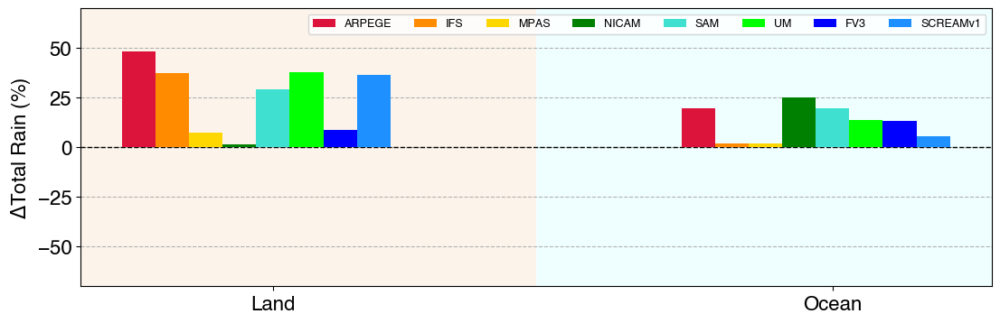

In [136]:
ylabel = f'$\Delta$Total Rain (%)'
if PHASE == 'Winter':
    ylim = (-70,70)
if PHASE == 'Summer':
    ylim = (-70,70)
width = 0.06
figsize = [13,4]
figname = f'{figdir}globalmap_totpcp_tropics_meandiff_barchart.png'
legend_prop = {'ncol':len(name_map)-1, 'fontsize':9}
fig = bar_chart(dict_totpcp_lo_pyflex, region_names, name_map, width=width, ylabel=ylabel, ylim=ylim, legend_prop=legend_prop, figsize=figsize, figname=figname)

In [137]:
# ylabel = 'MCS Rain (mm day$^{-1}$)'
# if PHASE == 'Winter':
#     ylim = (0,4)
# if PHASE == 'Summer':
#     ylim = (0,4)
# width = 0.07
# # width = 0.1
# figsize = [13,4]
# figname = f'{figdir}globalmap_mcspcp_tropics_mean_barchart.png'
# legend_prop = {'ncol':len(name_map), 'fontsize':9}
# fig = bar_chart(dict_mcspcpAvg_lo, region_names_all, name_map, width=width, ylabel=ylabel, ylim=ylim, legend_prop=legend_prop, figsize=figsize, figname=figname, xlabel_rotation=45)

In [138]:
# ylabel = f'MCS Rain Fraction (%)'
# if PHASE == 'Winter':
#     ylim = (0,80)
# if PHASE == 'Summer':
#     ylim = (0,80)
# width = 0.07
# # width = 0.1
# figsize = [13,4]
# figname = f'{figdir}globalmap_mcspcpfrac_tropics_mean_barchart.png'
# legend_prop = {'ncol':len(name_map), 'fontsize':9}
# fig = bar_chart(dict_mcspcpfracAvg_lo, region_names_all, name_map, width=width, ylabel=ylabel, ylim=ylim, legend_prop=legend_prop, figsize=figsize, figname=figname, xlabel_rotation=45)

In [139]:
# ylabel = f'MCS Cloud Frequency (%)'
# if PHASE == 'Winter':
#     ylim = (0,15)
# if PHASE == 'Summer':
#     ylim = (0,15)
# width = 0.07
# figsize = [13,4]
# figname = f'{figdir}globalmap_mcscloudfreq_tropics_mean_barchart.png'
# legend_prop = {'ncol':len(name_map), 'fontsize':9}
# fig = bar_chart(dict_mcscloudfreqAvg_lo, region_names_all, name_map, width=width, ylabel=ylabel, ylim=ylim, legend_prop=legend_prop, figsize=figsize, figname=figname, xlabel_rotation=45)

In [140]:
# ylabel = f'MCS Rain Frequency (%)'
# if PHASE == 'Winter':
#     ylim = (0,3)
# if PHASE == 'Summer':
#     ylim = (0,3)
# width = 0.07
# figsize = [13,4]
# figname = f'{figdir}globalmap_mcsrainfreq_tropics_mean_barchart.png'
# legend_prop = {'ncol':len(name_map), 'fontsize':9}
# fig = bar_chart(dict_mcspcpfreqAvg_lo, region_names_all, name_map, width=width, ylabel=ylabel, ylim=ylim, legend_prop=legend_prop, figsize=figsize, figname=figname, xlabel_rotation=45)

In [141]:
# ylabel = f'$\Delta$MCS Rain (%)'
# if PHASE == 'Winter':
#     ylim = (-100,100)
# if PHASE == 'Summer':
#     ylim = (-100,100)
# width = 0.07
# # width = 0.1
# figsize = [13,4]
# figname = f'{figdir}globalmap_mcspcp_tropics_meandiff_barchart.png'
# legend_prop = {'ncol':len(name_map)-1, 'fontsize':9}
# fig = bar_chart(dict_mcspcp_lo, region_names_all, name_map, width=width, ylabel=ylabel, ylim=ylim, legend_prop=legend_prop, figsize=figsize, figname=figname, xlabel_rotation=45)

In [142]:
# ylabel = f'$\Delta$MCS Rain Fraction (%)'
# if PHASE == 'Winter':
#     ylim = (-50,50)
# if PHASE == 'Summer':
#     ylim = (-50,50)
# width = 0.07
# figsize = [13,4]
# figname = f'{figdir}globalmap_mcspcpfrac_tropics_meandiff_barchart.png'
# legend_prop = {'ncol':len(name_map)-1, 'fontsize':9}
# fig = bar_chart(dict_mcspcpfrac_lo, region_names_all, name_map, width=width, ylabel=ylabel, ylim=ylim, legend_prop=legend_prop, figsize=figsize, figname=figname, xlabel_rotation=45)

In [143]:
# ylabel = f'$\Delta$MCS Rain Frequency (%)'
# if PHASE == 'Winter':
#     ylim = (-100,100)
# if PHASE == 'Summer':
#     ylim = (-100,100)
# width = 0.07
# figsize = [13,4]
# figname = f'{figdir}globalmap_mcspcpfreq_tropics_meandiff_barchart.png'
# legend_prop = {'ncol':len(name_map)-1, 'fontsize':9}
# fig = bar_chart(dict_mcspcpfreq_lo, region_names_all, name_map, width=width, ylabel=ylabel, ylim=ylim, legend_prop=legend_prop, figsize=figsize, figname=figname, xlabel_rotation=45)

In [144]:
# ylabel = f'$\Delta$MCS Cloud Frequency (%)'
# if PHASE == 'Winter':
#     ylim = (-100,200)
# if PHASE == 'Summer':
#     ylim = (-100,100)
# width = 0.07
# figsize = [13,4]
# figname = f'{figdir}globalmap_mcscloudfreq_tropics_meandiff_barchart.png'
# legend_prop = {'ncol':len(name_map)-1, 'fontsize':9}
# fig = bar_chart(dict_mcscloudfreq_lo, region_names_all, name_map, width=width, ylabel=ylabel, ylim=ylim, legend_prop=legend_prop, figsize=figsize, figname=figname, xlabel_rotation=45)

## Function to plot 1 map and bar chart

In [145]:
def plot_map_bars(data_map, lon, lat, titles, levels, cmaps, cblabels, cbticks, figname, 
                  oob_colors=None, contourf=False, figsize=None, fontsize=None, cb_fontsize=None,
                  boxes=None, boxtextloc=None, boxtext=None, boxtexttype=None, text_colors=None,
                  bar_data=None, bar_width=None, bar_ylabel=None, legend_prop=None, bar_ylim=None, bar_xlabels=None, bar_xlabel_rotation=0):
                  # boxes=None, boxtextloc=None, dict_text_type=None, dict_text_val=None, text_colors=None, boxtext_fontsize=None):
    
    mpl.rcParams['font.size'] = fontsize
    mpl.rcParams['font.family'] = 'Helvetica'

    ###################################################
    # Map plot
    ###################################################
    map_extent = [-180., 179.5, -60.1, 60.1]
    lonv = np.arange(-180,180.1,30)
    latv = np.arange(-60,60.1,15)
    proj = ccrs.PlateCarree(central_longitude=0)
    data_proj = ccrs.PlateCarree()
    levelshgt = [1000,10000]

    fig = plt.figure(figsize=figsize, dpi=100)
    h_ratios = [0.05, 1, 1]
    gs = gridspec.GridSpec(3, 1, height_ratios=h_ratios, width_ratios=[1])
    gs.update(left=0.05, right=0.88, bottom=0.1, top=0.9, wspace=0.05, hspace=0.25)

    resolution = '110m'
    land = cfeature.NaturalEarthFeature('physical', 'land', resolution)
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', resolution)
    borders = cfeature.NaturalEarthFeature('cultural', 'admin_0_boundary_lines_land', resolution)
    
    ax = plt.subplot(gs[1,0], projection=proj)
    ax.set_extent(map_extent, crs=proj)
    ax.add_feature(land, facecolor='none', edgecolor='k', zorder=3)
    ax.set_aspect('auto', adjustable=None)
    ax.set_title(titles[0], loc='left')
    
    # Grid lines & labels
    gl = ax.gridlines(crs=proj, draw_labels=False, linestyle='--', linewidth=0.5)
    gl.xlocator = mpl.ticker.FixedLocator(lonv)
    gl.ylocator = mpl.ticker.FixedLocator(latv)         
    # if (row == nrow-1):
    ax.set_xticks(lonv, crs=data_proj)
    lon_formatter = LongitudeFormatter(zero_direction_label=True)
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.set_yticks(latv, crs=data_proj)
    lat_formatter = LatitudeFormatter()
    ax.yaxis.set_major_formatter(lat_formatter)

    # Terrain height
    ct = ax.contour(lon_ter, lat_ter, ter_s, levels=[1000,1001], \
                    colors='dimgray', linewidths=1, transform=data_proj, zorder=3)
    
    # Select and mask data source
    Zm = np.ma.masked_where(np.isnan(data_map), data_map)
    cmap = copy.copy(mpl.colormaps.get_cmap(cmaps))
    # Set out-of-bounds colors
    if oob_colors is not None:
        cmap.set_over(oob_colors['over'])
        cmap.set_under(oob_colors['under'])
        # cf1.set_clim(min(levels), max(levels))
    norm = colors.BoundaryNorm(boundaries=levels, ncolors=cmap.N)
    # Plot data
    if (contourf == False):
        cf1 = ax.pcolormesh(lon, lat, Zm, shading='auto', norm=norm, cmap=cmap, transform=data_proj, zorder=2)
    else:
        cf1 = ax.contourf(lon, lat, Zm, levels=levels, norm=norm, cmap=cmap, transform=data_proj, extend='both', zorder=2)
    # # Set out-of-bounds colors
    # if oob_colors is not None:
    #     cf1.cmap.set_over(oob_colors['over'])
    #     cf1.cmap.set_under(oob_colors['under'])
    #     cf1.set_clim(min(levels), max(levels))
    # Colorbars
    cax1 = plt.subplot(gs[0,0])
    cb1 = plt.colorbar(cf1, cax=cax1, label=cblabels, ticks=cbticks, orientation='horizontal', extend='both')
    cb1.ax.xaxis.set_label_position('top')
    cb1.ax.tick_params(labelsize=cb_fontsize)
        
    # Plot boxes
    if boxes is not None:
        for ii in boxes:
            # Plot region boxes
            corners = [[boxes[ii][0],boxes[ii][2]], [boxes[ii][1],boxes[ii][2]], [boxes[ii][1],boxes[ii][3]], [boxes[ii][0],boxes[ii][3]]]
            box = Polygon(corners, edgecolor='k', facecolor='none', lw=2, transform=data_proj, zorder=10)
            ax.add_patch(box)

            if boxtexttype is None:
                text_color = text_colors['pos'] if (boxtext[ii] >=0) else text_colors['neg']
                ax.text(boxtextloc[ii][0], boxtextloc[ii][1], f"{boxtext[ii]:.00f}%", ha='center',
                        bbox=dict(facecolor='w', alpha=0.8, edgecolor=text_color),
                        fontsize=12, fontweight='bold', color=text_color, transform=data_proj, zorder=4)
            else:
                text_color = 'k'
                ax.text(boxtextloc[ii][0], boxtextloc[ii][1], f"{boxtext[ii]}", ha='center',
                        bbox=dict(facecolor='w', alpha=0.8, edgecolor=text_color),
                        fontsize=12, fontweight='bold', color=text_color, transform=data_proj, zorder=4)

    
    ###################################################
    # Bar chart
    ###################################################
    ax2 = plt.subplot(gs[2,0])
    # labels = list(boxes.keys())
    x = np.arange(len(bar_xlabels))
    # multiplier = -((len(name_map)-1)/2)
    multiplier = -((len(bar_data))/2)
    lcolors = {
        'obs':'k', 
        'm1': 'crimson',
        'm2': 'darkorange', 
        'm3': 'gold',
        'm4': 'green',
        'm5': 'turquoise',
        'm6': 'lime',
        'm7': 'blue',
        'm8': 'deepskyblue',
        'm9': 'purple',
        'm10': 'violet',
        'm11': 'deeppink',
        'm12': 'dodgerblue',
    }

    # Loop over each source    
    for key, val in bar_data.items():
        offset = bar_width * multiplier
        rects = ax2.bar(x + offset, val, bar_width, color=lcolors[key], label=name_map[key], zorder=2)
        multiplier += 1    

    # Add some text for xlabels, title and custom x-axis tick xlabels, etc.
    ax2.set_ylabel(bar_ylabel)
    ax2.set_title(titles[1], loc='left')
    # ax2.set_xticks(x, bar_xlabels)
    # Set xlabel text alignment
    xlabel_ha = 'right' if bar_xlabel_rotation > 0 else 'center'
    ax2.set_xticks(x, bar_xlabels, rotation=bar_xlabel_rotation, ha=xlabel_ha)
    
    ax2.legend(ncol=legend_prop['ncol'], fontsize=legend_prop['fontsize'])
    ax2.axhline(y=0, lw=1, ls='--', color='k')
    ax2.grid(which='major', ls='--', axis='y')
    ax2.set_ylim(bar_ylim[0], bar_ylim[1])
    
    # Shade the background with colors
    # Get x-axis limits
    xmin, xmax = ax2.get_xlim()
    midpoint = (xmin + xmax) / 2
    ax2.axvspan(xmin, midpoint, facecolor='antiquewhite', alpha=0.6)
    ax2.axvspan(midpoint, xmax, facecolor='lightcyan', alpha=0.6)
    ax2.set_xlim(xmin, xmax)
    
    fig.savefig(figname, dpi=300, bbox_inches='tight', facecolor='w')
    return fig

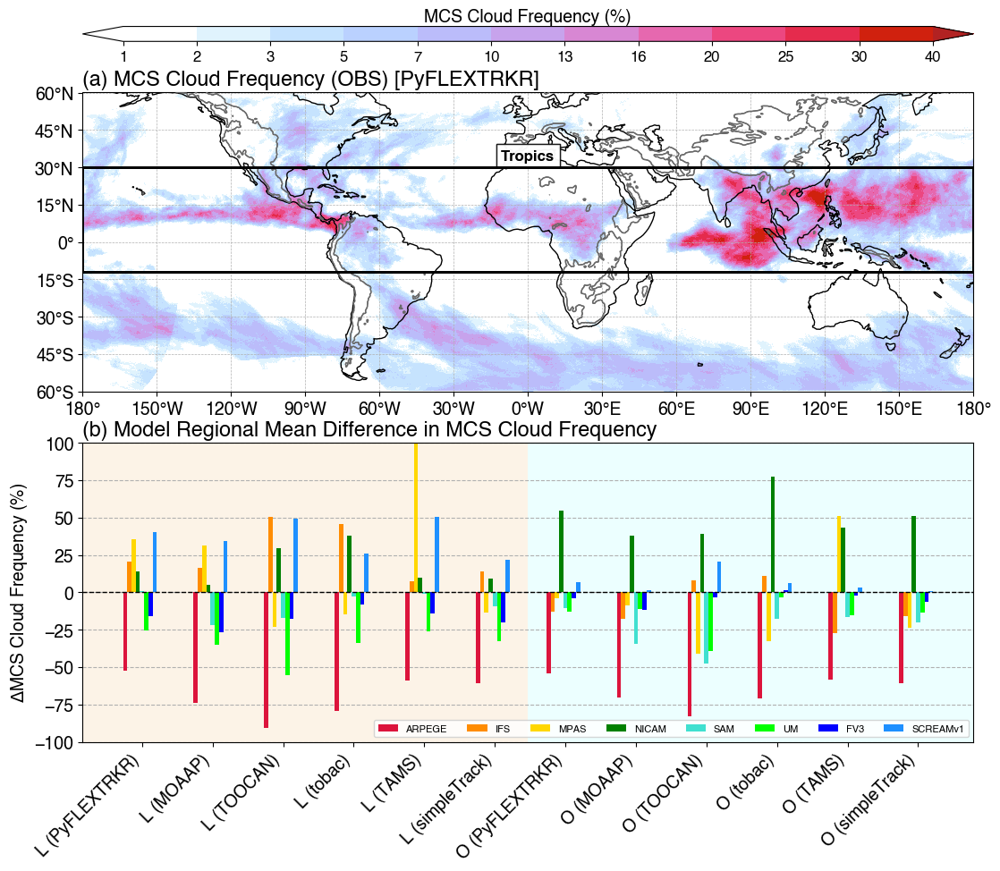

In [146]:
figsize = [12,10]
fontsize = 14
cb_fontsize = 12
varname1 = 'MCS Cloud Frequency'
varname2 = '$\Delta$MCS Cloud Frequency'
units = '%'

# Map data
data_dict = mcscloudfreq_obs_pyflex
levels = [1,2,3,5,7,10,13,16,20,25,30,40]
cmaps = cc.cm.CET_L19
titles = [f'(a) {varname1} (OBS) [PyFLEXTRKR]', f'(b) Model Regional Mean Difference in {varname1}']
cbticks = levels
oob_colors = {'under':'white', 'over':'firebrick'}
cblabels = f'{varname1} ({units})'
text_colors = None
# text_val = dict(zip(boxes.keys(),boxes.keys()))
text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# Bar chart data
bar_data = dict_mcscloudfreq_lo
bar_xlabels = region_names_all
bar_ylabel = f'{varname2} (%)'
bar_ylim = (-100,100)
bar_width = 0.06
legend_prop = {'ncol':len(name_map)-1, 'fontsize':8}

figname = f'{figdir}globalmap_mcs_cloudfreq_obs_barchart_diff.png'

fig = plot_map_bars(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                    figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
                    boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
                    bar_data=bar_data, bar_width=bar_width, bar_ylabel=bar_ylabel, legend_prop=legend_prop, bar_ylim=bar_ylim, bar_xlabels=bar_xlabels, bar_xlabel_rotation=45)

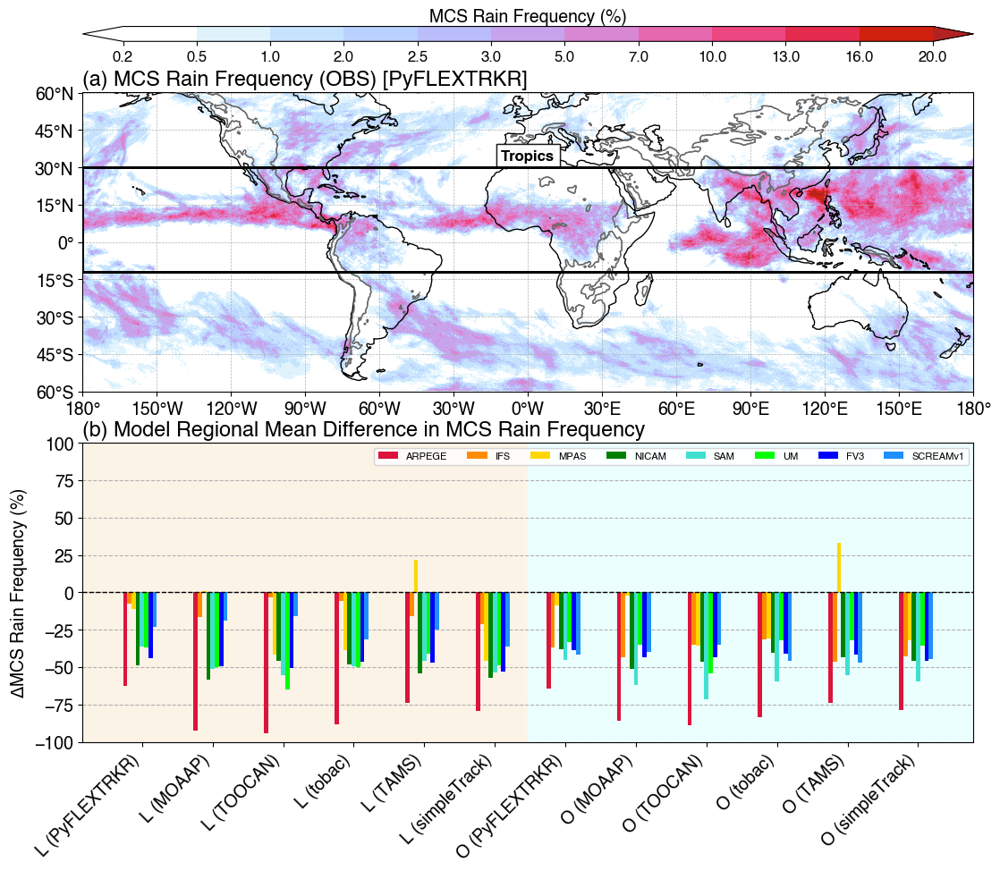

In [147]:
figsize = [12,10]
fontsize = 14
cb_fontsize = 12
varname1 = 'MCS Rain Frequency'
varname2 = '$\Delta$MCS Rain Frequency'
units = '%'

# Map data
data_dict = mcspcpfreq_obs_pyflex
levels = [0.2,0.5,1,2,2.5,3,5,7,10,13,16,20]
cmaps = cc.cm.CET_L19
titles = [f'(a) {varname1} (OBS) [PyFLEXTRKR]', f'(b) Model Regional Mean Difference in {varname1}']
cbticks = levels
oob_colors = {'under':'white', 'over':'firebrick'}
cblabels = f'{varname1} ({units})'
text_colors = None
# text_val = dict(zip(boxes.keys(),boxes.keys()))
text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# Bar chart data
bar_data = dict_mcspcpfreq_lo
bar_xlabels = region_names_all
bar_ylabel = f'{varname2} (%)'
bar_ylim = (-100,100)
bar_width = 0.06
legend_prop = {'ncol':len(name_map)-1, 'fontsize':8}

figname = f'{figdir}globalmap_mcs_rainfreq_obs_barchart_diff.png'

fig = plot_map_bars(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                    figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
                    boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
                    bar_data=bar_data, bar_width=bar_width, bar_ylabel=bar_ylabel, legend_prop=legend_prop, bar_ylim=bar_ylim, bar_xlabels=bar_xlabels, bar_xlabel_rotation=45)

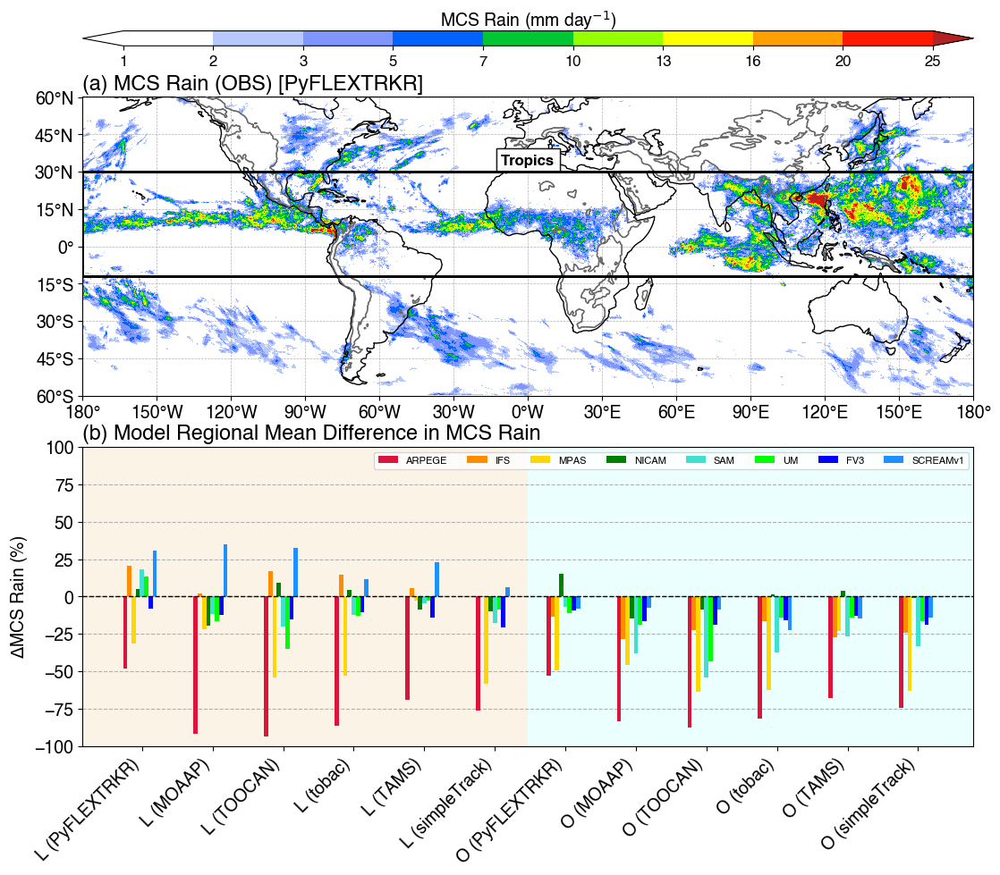

In [148]:
figsize = [12,10]
fontsize = 14
cb_fontsize = 12
varname1 = 'MCS Rain'
varname2 = '$\Delta$MCS Rain'
units = 'mm day$^{-1}$'

# Map data
data_dict = mcspcp_obs_pyflex
levels = [1,2,3,5,7,10,13,16,20,25]
cmaps = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
titles = [f'(a) {varname1} (OBS) [PyFLEXTRKR]', f'(b) Model Regional Mean Difference in {varname1}']
cbticks = levels
oob_colors = {'under':'white', 'over':'firebrick'}
cblabels = f'{varname1} ({units})'
text_colors = None
# text_val = dict(zip(boxes.keys(),boxes.keys()))
text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# Bar chart data
bar_data = dict_mcspcp_lo
bar_xlabels = region_names_all
bar_ylabel = f'{varname2} (%)'
bar_ylim = (-100,100)
bar_width = 0.06
legend_prop = {'ncol':len(name_map)-1, 'fontsize':8}

figname = f'{figdir}globalmap_mcs_rain_obs_barchart_diff.png'

fig = plot_map_bars(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                    figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
                    boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
                    bar_data=bar_data, bar_width=bar_width, bar_ylabel=bar_ylabel, legend_prop=legend_prop, bar_ylim=bar_ylim, bar_xlabels=bar_xlabels, bar_xlabel_rotation=45)

/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


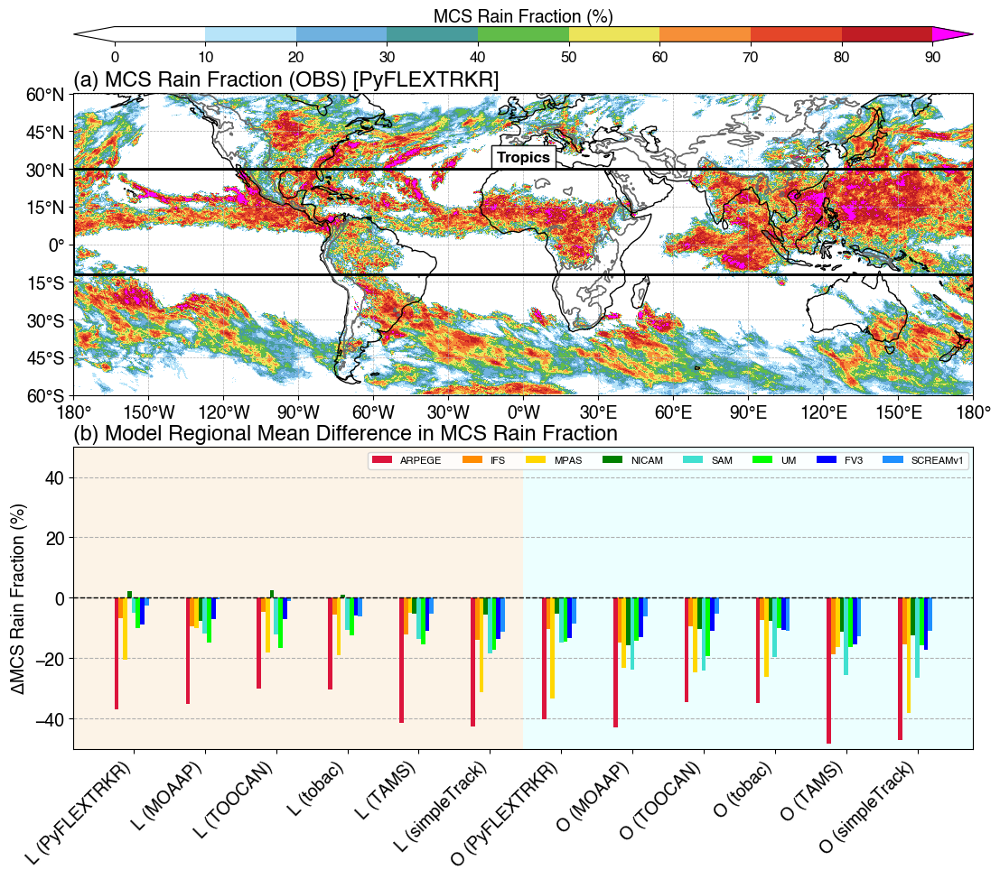

In [149]:
figsize = [12,10]
fontsize = 14
cb_fontsize = 12
varname1 = 'MCS Rain Fraction'
varname2 = '$\Delta$MCS Rain Fraction'
units = '%'

# Map data
data_dict = mcspcpfrac_obs_pyflex
levels = np.arange(0, 90.01, 10)
cmaps = generate_NCL_cmap('WhiteBlueGreenYellowRed')
cmaps = truncate_colormap(cmaps, 0.0, 0.9)
titles = [f'(a) {varname1} (OBS) [PyFLEXTRKR]', f'(b) Model Regional Mean Difference in {varname1}']
cbticks = levels
oob_colors = {'under':'white', 'over':'magenta'}
cblabels = f'{varname1} ({units})'
text_colors = None
# text_val = dict(zip(boxes.keys(),boxes.keys()))
text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# Bar chart data
bar_data = dict_mcspcpfrac_lo
bar_xlabels = region_names_all
bar_ylabel = f'{varname2} (%)'
bar_ylim = (-50,50)
bar_width = 0.06
legend_prop = {'ncol':len(name_map)-1, 'fontsize':8}

figname = f'{figdir}globalmap_mcs_rainfrac_obs_barchart_diff.png'

fig = plot_map_bars(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                    figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
                    boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
                    bar_data=bar_data, bar_width=bar_width, bar_ylabel=bar_ylabel, legend_prop=legend_prop, bar_ylim=bar_ylim, bar_xlabels=bar_xlabels, bar_xlabel_rotation=45)

In [150]:
figdir

'/global/cfs/cdirs/m1867/zfeng/MCSMIP/DYAMOND/Summer/figures/MCSMIP/'

In [151]:
# figsize = [12,10]
# fontsize = 14
# cb_fontsize = 12
# varname1 = 'MCS Rain'
# varname2 = 'MCS Rain'
# units = 'mm day$^{-1}$'

# # Map data
# data_dict = mcspcp_obs_pyflex
# levels = [1,2,3,5,7,10,13,16,20,25]
# cmaps = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
# titles = [f'(a) {varname1} (OBS) [PyFLEXTRKR]', f'(b) Model Regional Mean {varname1}']
# cbticks = levels
# oob_colors = {'under':'white', 'over':'firebrick'}
# cblabels = f'{varname1} ({units})'
# text_colors = None
# # text_val = dict(zip(boxes.keys(),boxes.keys()))
# text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# # Bar chart data
# bar_data = dict_mcspcpAvg_lo
# bar_xlabels = region_names_all
# bar_ylabel = f'{varname2} ({units})'
# bar_ylim = (0,4)
# bar_width = 0.07
# legend_prop = {'ncol':len(name_map), 'fontsize':8}

# figname = f'{figdir}globalmap_mcs_rain_obs_barchart.png'

# fig = plot_map_bars(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                     boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
#                     bar_data=bar_data, bar_width=bar_width, bar_ylabel=bar_ylabel, legend_prop=legend_prop, bar_ylim=bar_ylim, bar_xlabels=bar_xlabels, bar_xlabel_rotation=45)

In [152]:
# figsize = [12,10]
# fontsize = 14
# cb_fontsize = 12
# varname1 = 'MCS Rain Fraction'
# varname2 = 'MCS Rain Fraction'
# units = '%'

# # Map data
# data_dict = mcspcpfrac_obs_pyflex
# levels = np.arange(0, 90.01, 10)
# cmaps = generate_NCL_cmap('WhiteBlueGreenYellowRed')
# cmaps = truncate_colormap(cmaps, 0.0, 0.9)
# titles = [f'(a) {varname1} (OBS) [PyFLEXTRKR]', f'(b) Model Regional Mean {varname1}']
# cbticks = levels
# oob_colors = {'under':'white', 'over':'magenta'}
# cblabels = f'{varname1} ({units})'
# text_colors = None
# # text_val = dict(zip(boxes.keys(),boxes.keys()))
# text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# # Bar chart data
# bar_data = dict_mcspcpfracAvg_lo
# bar_xlabels = region_names_all
# bar_ylabel = f'{varname2} (%)'
# bar_ylim = (0,80)
# bar_width = 0.07
# legend_prop = {'ncol':len(name_map), 'fontsize':8}

# figname = f'{figdir}globalmap_mcs_rainfrac_obs_barchart.png'

# fig = plot_map_bars(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                     boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
#                     bar_data=bar_data, bar_width=bar_width, bar_ylabel=bar_ylabel, legend_prop=legend_prop, bar_ylim=bar_ylim, bar_xlabels=bar_xlabels, bar_xlabel_rotation=45)

In [153]:
# figsize = [12,10]
# fontsize = 14
# cb_fontsize = 12
# varname1 = 'MCS Cloud Frequency'
# varname2 = 'MCS Cloud Frequency'
# units = '%'

# # Map data
# data_dict = mcscloudfreq_obs_pyflex
# levels = [1,2,3,5,7,10,13,16,20,25,30,40]
# cmaps = cc.cm.CET_L19
# titles = [f'(a) {varname1} (OBS) [PyFLEXTRKR]', f'(b) Model Regional Mean {varname1}']
# cbticks = levels
# oob_colors = {'under':'white', 'over':'firebrick'}
# cblabels = f'{varname1} ({units})'
# text_colors = None
# # text_val = dict(zip(boxes.keys(),boxes.keys()))
# text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# # Bar chart data
# bar_data = dict_mcscloudfreqAvg_lo
# bar_xlabels = region_names_all
# bar_ylabel = f'{varname2} ({units})'
# bar_ylim = (0,15)
# bar_width = 0.07
# legend_prop = {'ncol':len(name_map), 'fontsize':8}

# figname = f'{figdir}globalmap_mcs_cloudfreq_obs_barchart.png'

# fig = plot_map_bars(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                     boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
#                     bar_data=bar_data, bar_width=bar_width, bar_ylabel=bar_ylabel, legend_prop=legend_prop, bar_ylim=bar_ylim, bar_xlabels=bar_xlabels, bar_xlabel_rotation=45)

In [154]:
# figsize = [12,10]
# fontsize = 14
# cb_fontsize = 12
# varname1 = 'MCS Rain Frequency'
# varname2 = 'MCS Rain Frequency'
# units = '%'

# # Map data
# data_dict = mcspcpfreq_obs_pyflex
# levels = [0.2,0.5,1,2,2.5,3,5,7,10,13,16,20]
# cmaps = cc.cm.CET_L19
# titles = [f'(a) {varname1} (OBS) [PyFLEXTRKR]', f'(b) Model Regional Mean Difference in {varname1}']
# cbticks = levels
# oob_colors = {'under':'white', 'over':'firebrick'}
# cblabels = f'{varname1} ({units})'
# text_colors = None
# # text_val = dict(zip(boxes.keys(),boxes.keys()))
# text_val = {'Land':'Tropics', 'Ocean':'Tropics'}

# # Bar chart data
# bar_data = dict_mcspcpfreqAvg_lo
# bar_xlabels = region_names_all
# bar_ylabel = f'{varname2} (%)'
# bar_ylim = (0,3)
# bar_width = 0.07
# legend_prop = {'ncol':len(name_map), 'fontsize':8}

# figname = f'{figdir}globalmap_mcs_rainfreq_obs_barchart.png'

# fig = plot_map_bars(data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                     boxes=boxes, boxtextloc=text_loc, boxtext=text_val, boxtexttype='string',
#                     bar_data=bar_data, bar_width=bar_width, bar_ylabel=bar_ylabel, legend_prop=legend_prop, bar_ylim=bar_ylim, bar_xlabels=bar_xlabels, bar_xlabel_rotation=45)

In [155]:
figname

'/global/cfs/cdirs/m1867/zfeng/MCSMIP/DYAMOND/Summer/figures/MCSMIP/globalmap_mcs_rainfrac_obs_barchart_diff.png'

## Function to plot multi-row maps for all sources

In [156]:
def plot_maps_nrow(nrow, data_dict, lon, lat, titles, levels, cmaps, cblabels, cbticks, figname, 
                   oob_colors=None, contourf=False, figsize=None, fontsize=None, cb_fontsize=None,
                   boxes=None, boxtextloc=None, dict_text_type=None, dict_text_val=None, text_colors=None, boxtext_fontsize=None):
    
    mpl.rcParams['font.size'] = fontsize
    mpl.rcParams['font.family'] = 'Helvetica'

    map_extent = [-180., 179.5, -60.1, 60.1]
    lonv = np.arange(-180,180.1,30)
    latv = np.arange(-60,60.1,15)
    proj = ccrs.PlateCarree(central_longitude=0)
    data_proj = ccrs.PlateCarree()
    levelshgt = [1000,10000]

    fig = plt.figure(figsize=figsize, dpi=100)
    h_ratios = [0.05] + list(np.repeat(1,nrow)) + [0.05]
    gs = gridspec.GridSpec(nrow+2, 1, height_ratios=h_ratios, width_ratios=[1])
    gs.update(left=0.05, right=0.88, bottom=0.1, top=0.9, wspace=0.05, hspace=0.13)

    resolution = '110m'
    land = cfeature.NaturalEarthFeature('physical', 'land', resolution)
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', resolution)
    borders = cfeature.NaturalEarthFeature('cultural', 'admin_0_boundary_lines_land', resolution)
    
    cf_save = []
    for row in range(0, nrow):
        ax = plt.subplot(gs[row+1,0], projection=proj)
        ax.set_extent(map_extent, crs=proj)
        ax.add_feature(land, facecolor='none', edgecolor='k', zorder=3)
        ax.set_aspect('auto', adjustable=None)
        # Title
        flabel = ax.text(0.02, 0.05, titles[row], transform=ax.transAxes, fontsize=None)
        flabel.set_bbox(dict(facecolor='w', alpha=0.8, edgecolor='w'))
        
        # Grid lines & labels
        gl = ax.gridlines(crs=proj, draw_labels=False, linestyle='--', linewidth=0.5)
        gl.xlocator = mpl.ticker.FixedLocator(lonv)
        gl.ylocator = mpl.ticker.FixedLocator(latv)         
        if (row == nrow-1):
            ax.set_xticks(lonv, crs=data_proj)
            lon_formatter = LongitudeFormatter(zero_direction_label=True)
            ax.xaxis.set_major_formatter(lon_formatter)
        ax.set_yticks(latv, crs=data_proj)
        lat_formatter = LatitudeFormatter()
        ax.yaxis.set_major_formatter(lat_formatter)
        
        # Terrain height
        ct = ax.contour(lon_ter, lat_ter, ter_s, levels=[1000,1001], \
                        colors='dimgray', linewidths=1, transform=data_proj, zorder=3)

        # Select and mask data source
        data = data_dict.isel(source=row)
        Zm = np.ma.masked_where(np.isnan(data), data)
        cmap = copy.copy(mpl.colormaps.get_cmap(cmaps[row]))
        # Set out-of-bounds colors
        if oob_colors is not None:
            oob_c = oob_colors[row]
            if oob_c is not None:
                cmap.set_over(oob_c['over'])
                cmap.set_under(oob_c['under'])
        norm = colors.BoundaryNorm(boundaries=levels[row], ncolors=cmap.N)
        # Plot data
        if (contourf == False):
            cf1 = ax.pcolormesh(lon, lat, Zm, shading='auto', norm=norm, cmap=cmap, transform=data_proj, zorder=2)
        else:
            cf1 = ax.contourf(lon, lat, Zm, levels=levels[row], norm=norm, cmap=cmap, transform=data_proj, extend='both', zorder=2)
        cf_save.append(cf1)

        # Plot regional boxes
        if boxes is not None:
            # Loop over each box dictionary
            for ii in boxes:
                # Plot region boxes
                corners = [[boxes[ii][0],boxes[ii][2]], [boxes[ii][1],boxes[ii][2]], [boxes[ii][1],boxes[ii][3]], [boxes[ii][0],boxes[ii][3]]]
                box = Polygon(corners, edgecolor='k', facecolor='none', lw=2, transform=data_proj, zorder=10)
                ax.add_patch(box)
                
                # Get key using row number
                key = list(dict_text_type.keys())[row]
                boxtexttype = dict_text_type[key]
                boxtext = dict_text_val[key]
                
                # Plot box text
                if boxtexttype == 'float':
                    text_color = text_colors['pos'] if (boxtext[ii] >=0) else text_colors['neg']
                    ax.text(boxtextloc[ii][0], boxtextloc[ii][1], f"{boxtext[ii]:.00f}%", ha='center',
                            bbox=dict(facecolor='w', alpha=0.8, edgecolor=text_color),
                            fontsize=boxtext_fontsize, fontweight='bold', color=text_color, transform=data_proj, zorder=4)
                if boxtexttype == 'string':
                    text_color = 'k'
                    ax.text(boxtextloc[ii][0], boxtextloc[ii][1], f"{boxtext[ii]}", ha='center',
                            bbox=dict(facecolor='w', alpha=0.8, edgecolor=text_color),
                            fontsize=boxtext_fontsize, fontweight='bold', color=text_color, transform=data_proj, zorder=4)
                
    # Colorbars
    cax1 = plt.subplot(gs[0,0])
    cax2 = plt.subplot(gs[-1,0])
    cb1 = plt.colorbar(cf_save[0], cax=cax1, label=cblabels[0], ticks=cbticks[0], orientation='horizontal', extend='both')
    cb2 = plt.colorbar(cf_save[-1], cax=cax2, label=cblabels[1], ticks=cbticks[1], orientation='horizontal', extend='both')
    cb1.ax.xaxis.set_label_position('top')
        # # cb1.set_label(cblabel, fontsize=14)
    cb1.ax.tick_params(labelsize=cb_fontsize)
    
    fig.savefig(figname, dpi=300, bbox_inches='tight', facecolor='w')
    return fig

In [157]:
# Combine region names & model difference values to a dictionary
dict1 = {'obs': list(boxes.keys())}
# dict1 = {'obs': {'Land': 'Tropics', 'Ocean': 'Tropics'}}
dict_text_combine = {**dict1, **dict_totpcp_o_pyflex}
# Make dictionary key with region names
dict_text_val = {}
for key, val in name_map.items():
    boxtext = dict_text_combine[key]
    dict_text_val[key] = dict(zip(boxes.keys(), boxtext))

# Make text type for each source
dict1 = {'obs': 'string'}
dict2 = {key: 'float' for key in dict_totpcp_o_pyflex}
dict_text_type = {**dict1, **dict2}
# dict_text_type

dict_text_val['obs'] = {'Land': 'Tropics', 'Ocean': 'Tropics'}
print(dict_text_val)
# dict_text_combine

{'obs': {'Land': 'Tropics', 'Ocean': 'Tropics'}, 'm1': {'Land': 19.690956115722656, 'Ocean': 19.690956115722656}, 'm2': {'Land': 1.9575508832931519, 'Ocean': 1.9575508832931519}, 'm3': {'Land': 1.8263983726501465, 'Ocean': 1.8263983726501465}, 'm4': {'Land': 25.208585739135742, 'Ocean': 25.208585739135742}, 'm5': {'Land': 19.71632194519043, 'Ocean': 19.71632194519043}, 'm6': {'Land': 13.616701126098633, 'Ocean': 13.616701126098633}, 'm7': {'Land': 13.396218299865723, 'Ocean': 13.396218299865723}, 'm8': {'Land': 5.496464252471924, 'Ocean': 5.496464252471924}}


In [158]:
# print(2.84 / ds.dims['source'])
# height_ratio_per_panel = 0.36
# height_ratio_per_panel * ds.dims['source']

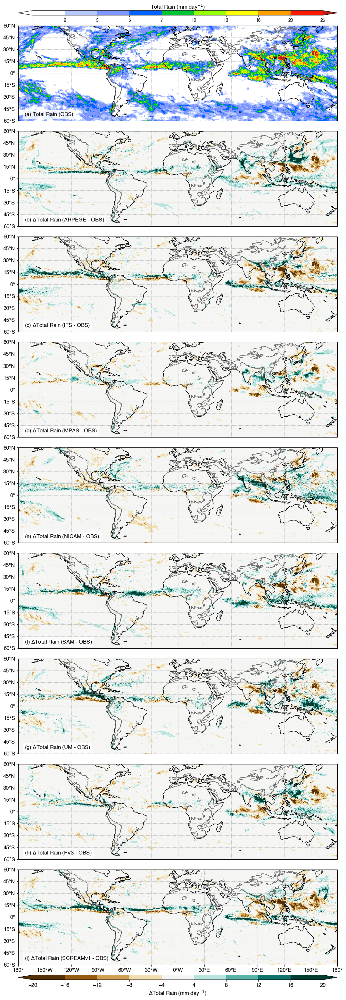

In [159]:
figwidth = 12
height_ratio_per_panel = 0.35
ratio = height_ratio_per_panel * ds_pyflex.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'Total Rain'
varname2 = '$\Delta$Total Rain'
units = 'mm day$^{-1}$'

# Combine OBS & model differences
data_dict = xr.concat([totpcp_obs_pyflex, totpcp_diff_pyflex], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25]
lev2 = [-20,-16,-12,-8,-4,4,8,12,16,20]
cmap1 = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]})')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_total_rain_obs_diff_all.png'

# lon_lm.shape, lon_lm.shape, data_dict.sel(source='obs').shape, data_dict.sel(source='m1').shape
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )

# fig = plot_maps_nrow(nrows, data_dict, lon_lm, lon_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                      figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                      boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

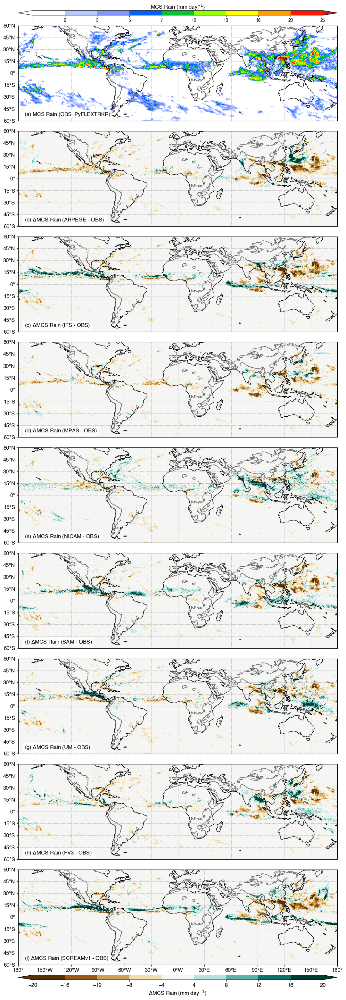

In [160]:
figwidth = 12
height_ratio_per_panel = 0.35
ratio = height_ratio_per_panel * ds_pyflex.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Rain'
varname2 = '$\Delta$MCS Rain'
units = 'mm day$^{-1}$'

# Combine OBS & model differences
data_dict = xr.concat([mcspcp_obs_pyflex, mcspcp_diff_pyflex], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25]
lev2 = [-20,-16,-12,-8,-4,4,8,12,16,20]
cmap1 = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  PyFLEXTRKR)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_rain_obs_diff_all_PyFLEXTRKR.png'

# lon_obs.shape, lat_obs.shape, data_dict.sel(source='obs').shape
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )
                     # boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

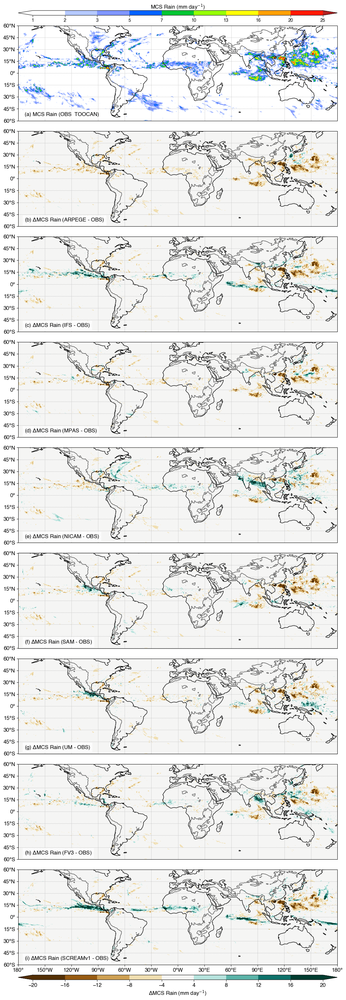

In [161]:
figwidth = 12
height_ratio_per_panel = 0.35
ratio = height_ratio_per_panel * ds_toocan.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Rain'
varname2 = '$\Delta$MCS Rain'
units = 'mm day$^{-1}$'

# Combine OBS & model differences
data_dict = xr.concat([mcspcp_obs_toocan, mcspcp_diff_toocan], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25]
lev2 = [-20,-16,-12,-8,-4,4,8,12,16,20]
cmap1 = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  TOOCAN)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_rain_obs_diff_all_TOOCAN.png'

# lon_obs.shape, lat_obs.shape, data_dict.sel(source='obs').shape
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )
                     # boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

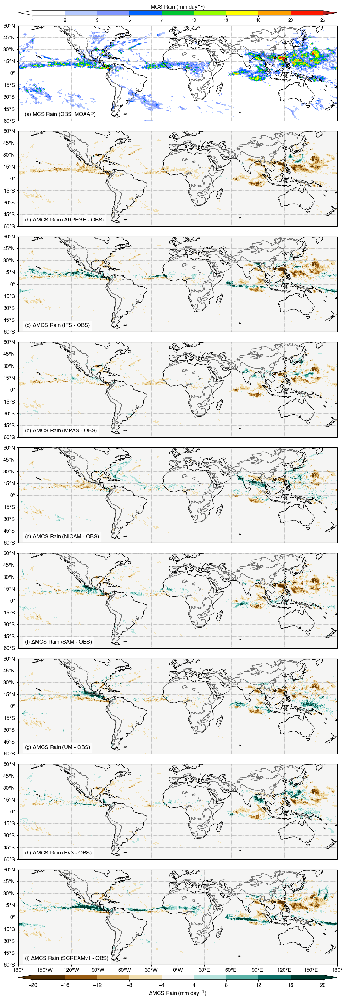

In [162]:
figwidth = 12
height_ratio_per_panel = 0.35
ratio = height_ratio_per_panel * ds_moaap.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Rain'
varname2 = '$\Delta$MCS Rain'
units = 'mm day$^{-1}$'

# Combine OBS & model differences
data_dict = xr.concat([mcspcp_obs_moaap, mcspcp_diff_moaap], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25]
lev2 = [-20,-16,-12,-8,-4,4,8,12,16,20]
cmap1 = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  MOAAP)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_rain_obs_diff_all_MOAAP.png'

# lon_obs.shape, lat_obs.shape, data_dict.sel(source='obs').shape
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )
                     # boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

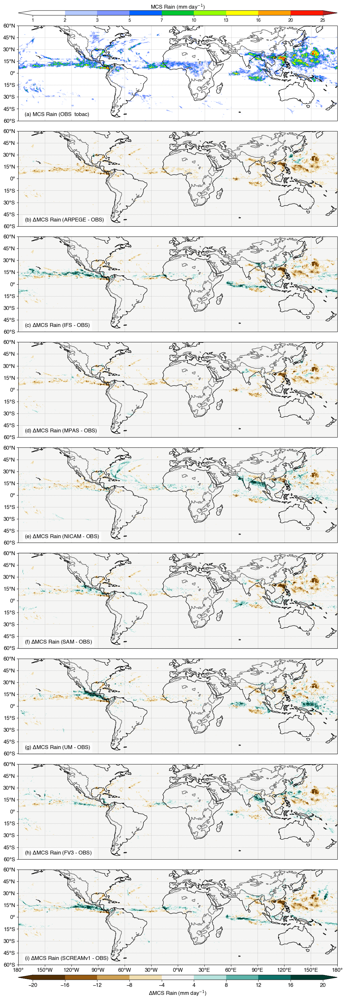

In [163]:
figwidth = 12
height_ratio_per_panel = 0.35
ratio = height_ratio_per_panel * ds_tobac.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Rain'
varname2 = '$\Delta$MCS Rain'
units = 'mm day$^{-1}$'

# Combine OBS & model differences
data_dict = xr.concat([mcspcp_obs_tobac, mcspcp_diff_tobac], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25]
lev2 = [-20,-16,-12,-8,-4,4,8,12,16,20]
cmap1 = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  tobac)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_rain_obs_diff_all_tobac.png'

# lon_obs.shape, lat_obs.shape, data_dict.sel(source='obs').shape
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )
                     # boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

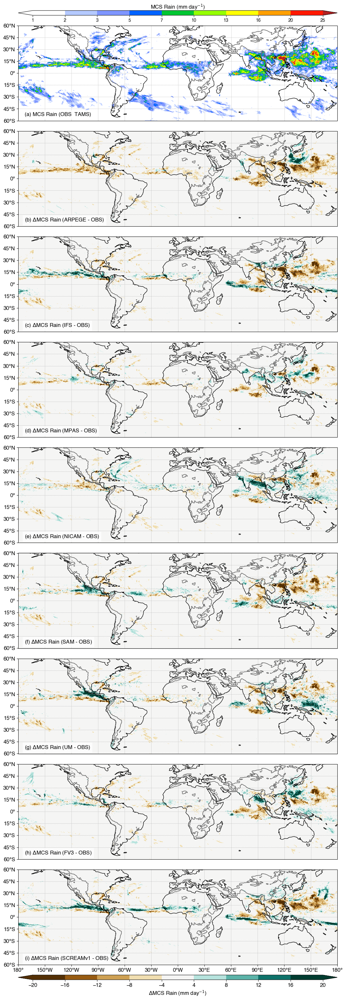

In [164]:
figwidth = 12
height_ratio_per_panel = 0.35
ratio = height_ratio_per_panel * ds_tams.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Rain'
varname2 = '$\Delta$MCS Rain'
units = 'mm day$^{-1}$'

# Combine OBS & model differences
data_dict = xr.concat([mcspcp_obs_tams, mcspcp_diff_tams], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25]
lev2 = [-20,-16,-12,-8,-4,4,8,12,16,20]
cmap1 = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  TAMS)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_rain_obs_diff_all_TAMS.png'

# lon_obs.shape, lat_obs.shape, data_dict.sel(source='obs').shape
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )
                     # boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

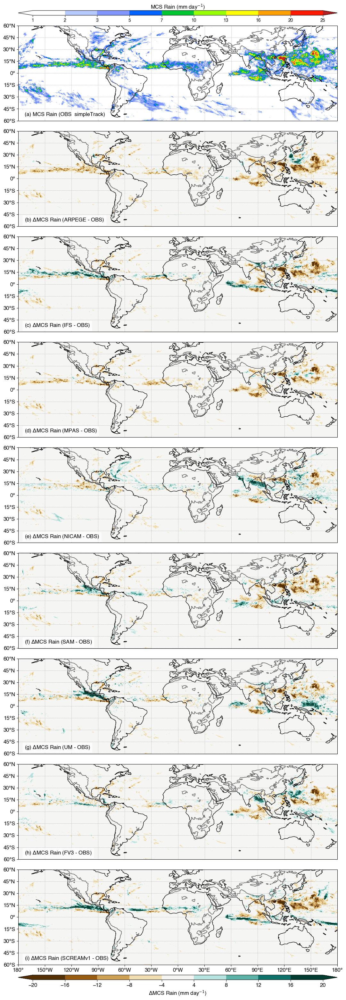

In [165]:
figwidth = 12
height_ratio_per_panel = 0.35
ratio = height_ratio_per_panel * ds_simtrack.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Rain'
varname2 = '$\Delta$MCS Rain'
units = 'mm day$^{-1}$'

# Combine OBS & model differences
data_dict = xr.concat([mcspcp_obs_simtrack, mcspcp_diff_simtrack], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25]
lev2 = [-20,-16,-12,-8,-4,4,8,12,16,20]
cmap1 = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  simpleTrack)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_rain_obs_diff_all_simpleTrack.png'

# lon_obs.shape, lat_obs.shape, data_dict.sel(source='obs').shape
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )
                     # boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

## MCS cloud frequency

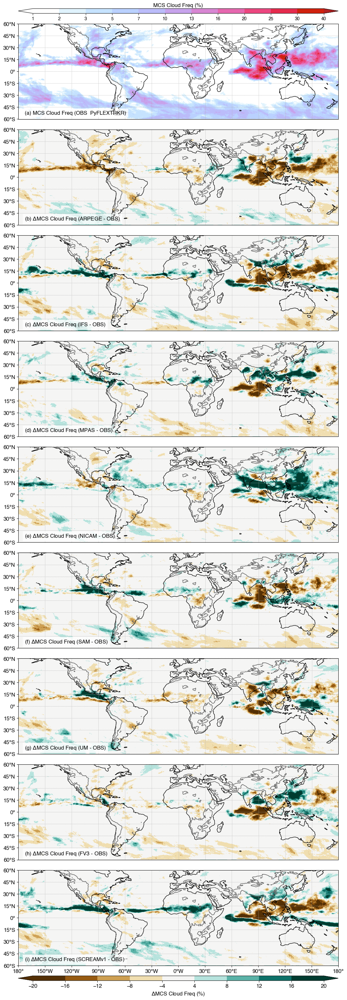

In [166]:
figwidth = 12
height_ratio_per_panel = 0.35 
ratio = height_ratio_per_panel * ds_pyflex.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Cloud Freq'
varname2 = '$\Delta$MCS Cloud Freq'
units = '%'

# Combine OBS & model differences
data_dict = xr.concat([mcscloudfreq_obs_pyflex, mcscloudfreq_diff_pyflex], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25,30,40]
lev2 = np.arange(-20, 20.1, 4)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
cmap1 = cc.cm.CET_L19
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  PyFLEXTRKR)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_cloudfreq_obs_diff_all_PyFLEXTRKR.png'
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )
                     # boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

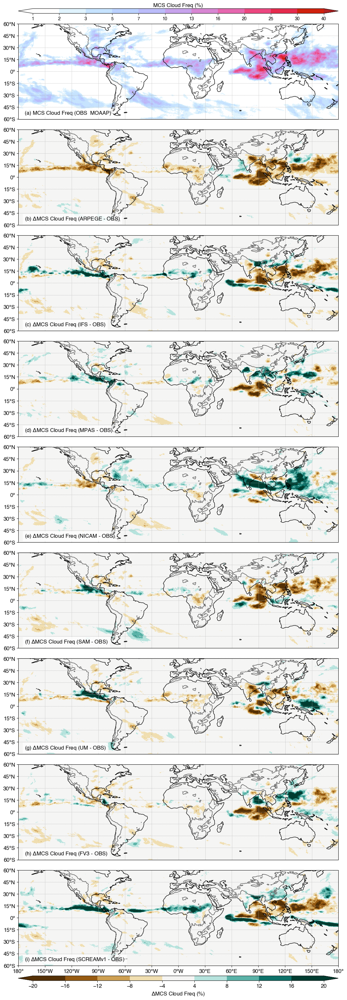

In [167]:
figwidth = 12
height_ratio_per_panel = 0.35 
ratio = height_ratio_per_panel * ds_moaap.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Cloud Freq'
varname2 = '$\Delta$MCS Cloud Freq'
units = '%'

# Combine OBS & model differences
data_dict = xr.concat([mcscloudfreq_obs_moaap, mcscloudfreq_diff_moaap], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25,30,40]
lev2 = np.arange(-20, 20.1, 4)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
cmap1 = cc.cm.CET_L19
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  MOAAP)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_cloudfreq_obs_diff_all_MOAAP.png'
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )

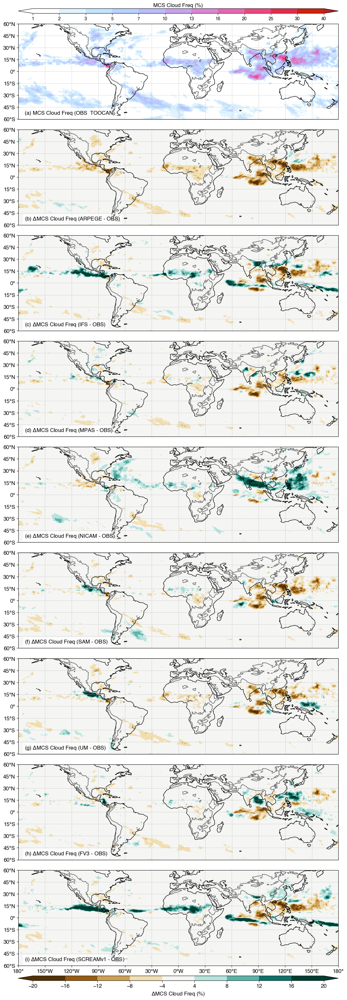

In [168]:
figwidth = 12
height_ratio_per_panel = 0.35 
ratio = height_ratio_per_panel * ds_toocan.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Cloud Freq'
varname2 = '$\Delta$MCS Cloud Freq'
units = '%'

# Combine OBS & model differences
data_dict = xr.concat([mcscloudfreq_obs_toocan, mcscloudfreq_diff_toocan], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25,30,40]
lev2 = np.arange(-20, 20.1, 4)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
cmap1 = cc.cm.CET_L19
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  TOOCAN)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_cloudfreq_obs_diff_all_TOOCAN.png'
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )

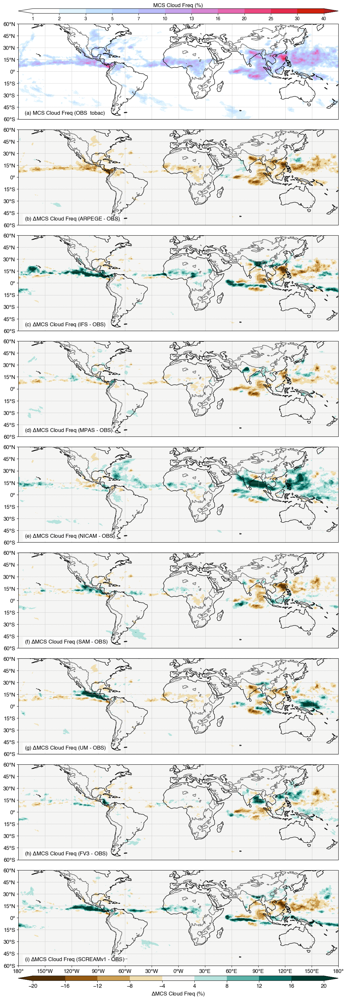

In [169]:
figwidth = 12
height_ratio_per_panel = 0.35 
ratio = height_ratio_per_panel * ds_tobac.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Cloud Freq'
varname2 = '$\Delta$MCS Cloud Freq'
units = '%'

# Combine OBS & model differences
data_dict = xr.concat([mcscloudfreq_obs_tobac, mcscloudfreq_diff_tobac], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25,30,40]
lev2 = np.arange(-20, 20.1, 4)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
cmap1 = cc.cm.CET_L19
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  tobac)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_cloudfreq_obs_diff_all_tobac.png'
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )
                     # boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

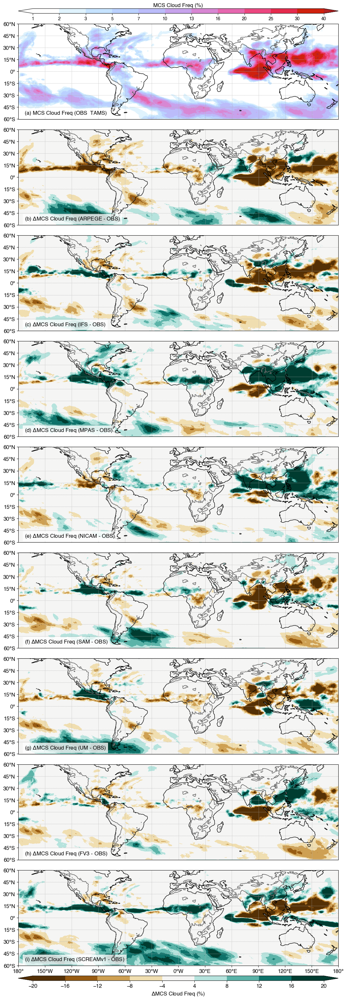

In [170]:
figwidth = 12
height_ratio_per_panel = 0.35 
ratio = height_ratio_per_panel * ds_tams.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Cloud Freq'
varname2 = '$\Delta$MCS Cloud Freq'
units = '%'

# Combine OBS & model differences
data_dict = xr.concat([mcscloudfreq_obs_tams, mcscloudfreq_diff_tams], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25,30,40]
lev2 = np.arange(-20, 20.1, 4)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
cmap1 = cc.cm.CET_L19
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  TAMS)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_cloudfreq_obs_diff_all_TAMS.png'
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )
                     # boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

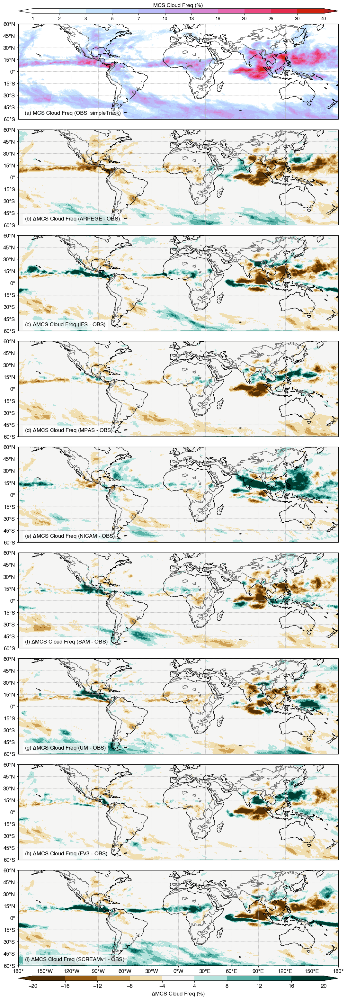

In [171]:
figwidth = 12
height_ratio_per_panel = 0.35 
ratio = height_ratio_per_panel * ds_simtrack.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Cloud Freq'
varname2 = '$\Delta$MCS Cloud Freq'
units = '%'

# Combine OBS & model differences
data_dict = xr.concat([mcscloudfreq_obs_simtrack, mcscloudfreq_diff_simtrack], dim='source')
lev1 = [1,2,3,5,7,10,13,16,20,25,30,40]
lev2 = np.arange(-20, 20.1, 4)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
cmap1 = cc.cm.CET_L19
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  simpleTrack)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_cloudfreq_obs_diff_all_simpleTrack.png'
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )
                     # boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

## MCS rain fraction

/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/

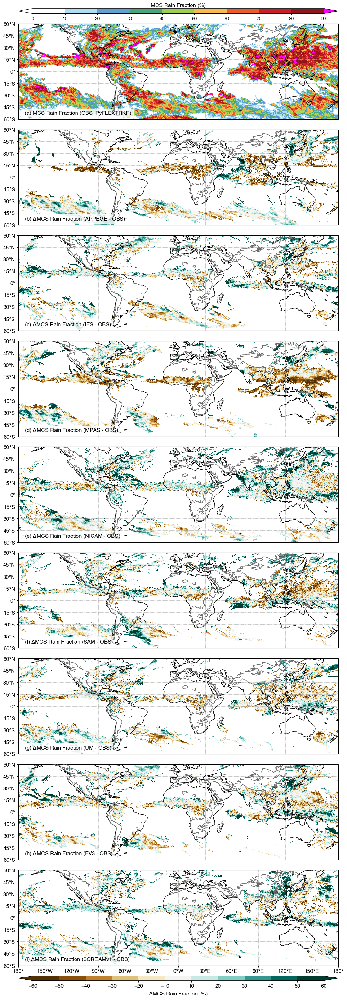

In [172]:
figwidth = 12
height_ratio_per_panel = 0.35 
ratio = height_ratio_per_panel * ds_pyflex.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Rain Fraction'
varname2 = '$\Delta$MCS Rain Fraction'
units = '%'

# Combine OBS & model differences
min_mcspcp_thresh = 1.0  # [mm/day]
data_dict = xr.concat([mcspcpfrac_obs_pyflex, mcspcpfrac_diff_pyflex.where(mcspcp_mod_pyflex > min_mcspcp_thresh)], dim='source')
lev1 = np.arange(0, 90.01, 10)
lev2 = np.arange(-60, 60.1, 10)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
cmap1 = generate_NCL_cmap('WhiteBlueGreenYellowRed')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  PyFLEXTRKR)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'magenta'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_rainfrac_obs_diff_all_PyFLEXTRKR.png'
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )

/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/c

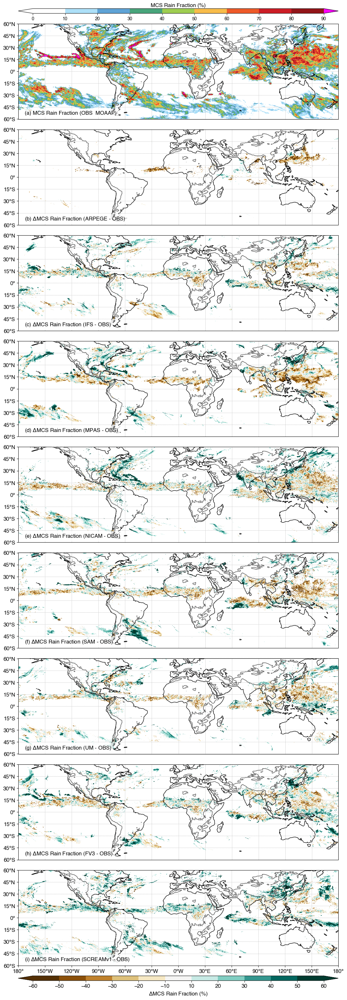

In [173]:
figwidth = 12
height_ratio_per_panel = 0.35 
ratio = height_ratio_per_panel * ds_moaap.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Rain Fraction'
varname2 = '$\Delta$MCS Rain Fraction'
units = '%'

# Combine OBS & model differences
min_mcspcp_thresh = 1.0  # [mm/day]
data_dict = xr.concat([mcspcpfrac_obs_moaap, mcspcpfrac_diff_moaap.where(mcspcp_mod_moaap > min_mcspcp_thresh)], dim='source')
lev1 = np.arange(0, 90.01, 10)
lev2 = np.arange(-60, 60.1, 10)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
cmap1 = generate_NCL_cmap('WhiteBlueGreenYellowRed')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  MOAAP)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'magenta'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_rainfrac_obs_diff_all_MOAAP.png'
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )

/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/co

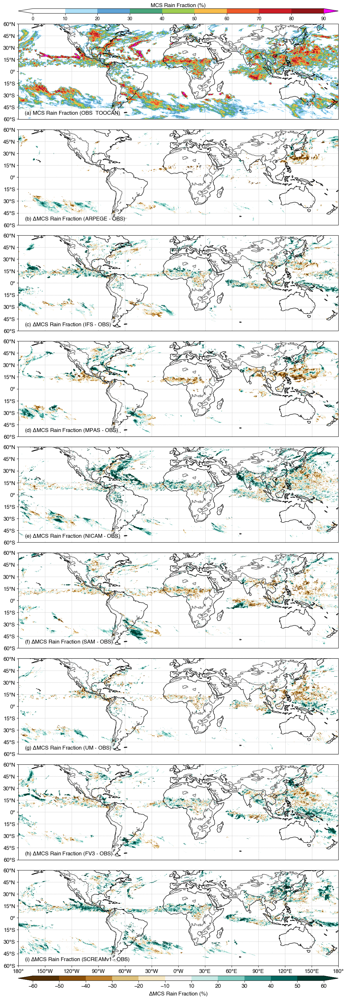

In [174]:
figwidth = 12
height_ratio_per_panel = 0.35 
ratio = height_ratio_per_panel * ds_toocan.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Rain Fraction'
varname2 = '$\Delta$MCS Rain Fraction'
units = '%'

# Combine OBS & model differences
min_mcspcp_thresh = 1.0  # [mm/day]
data_dict = xr.concat([mcspcpfrac_obs_toocan, mcspcpfrac_diff_toocan.where(mcspcp_mod_toocan > min_mcspcp_thresh)], dim='source')
lev1 = np.arange(0, 90.01, 10)
lev2 = np.arange(-60, 60.1, 10)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
cmap1 = generate_NCL_cmap('WhiteBlueGreenYellowRed')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  TOOCAN)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'magenta'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_rainfrac_obs_diff_all_TOOCAN.png'
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )

/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/

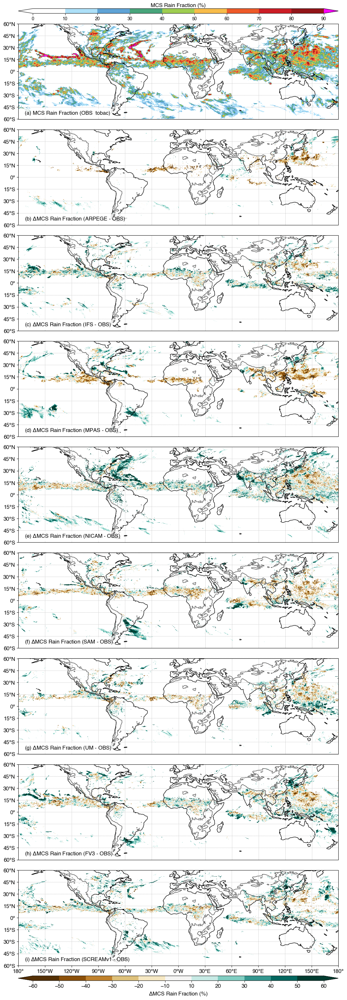

In [175]:
figwidth = 12
height_ratio_per_panel = 0.35 
ratio = height_ratio_per_panel * ds_tobac.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Rain Fraction'
varname2 = '$\Delta$MCS Rain Fraction'
units = '%'

# Combine OBS & model differences
min_mcspcp_thresh = 1.0  # [mm/day]
data_dict = xr.concat([mcspcpfrac_obs_tobac, mcspcpfrac_diff_tobac.where(mcspcp_mod_tobac > min_mcspcp_thresh)], dim='source')
lev1 = np.arange(0, 90.01, 10)
lev2 = np.arange(-60, 60.1, 10)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
cmap1 = generate_NCL_cmap('WhiteBlueGreenYellowRed')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  tobac)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'magenta'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_rainfrac_obs_diff_all_tobac.png'
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )

/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/

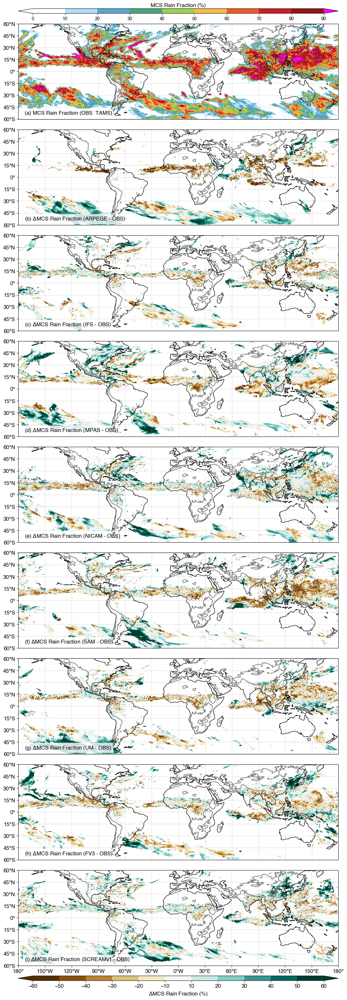

In [176]:
figwidth = 12
height_ratio_per_panel = 0.35 
ratio = height_ratio_per_panel * ds_tams.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Rain Fraction'
varname2 = '$\Delta$MCS Rain Fraction'
units = '%'

# Combine OBS & model differences
min_mcspcp_thresh = 1.0  # [mm/day]
data_dict = xr.concat([mcspcpfrac_obs_tams, mcspcpfrac_diff_tams.where(mcspcp_mod_tams > min_mcspcp_thresh)], dim='source')
lev1 = np.arange(0, 90.01, 10)
lev2 = np.arange(-60, 60.1, 10)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
cmap1 = generate_NCL_cmap('WhiteBlueGreenYellowRed')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  TAMS)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'magenta'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_rainfrac_obs_diff_all_TAMS.png'
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )

/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: divide by zero encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/common/software/m1867/python/py310/lib/python3.10/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/global/

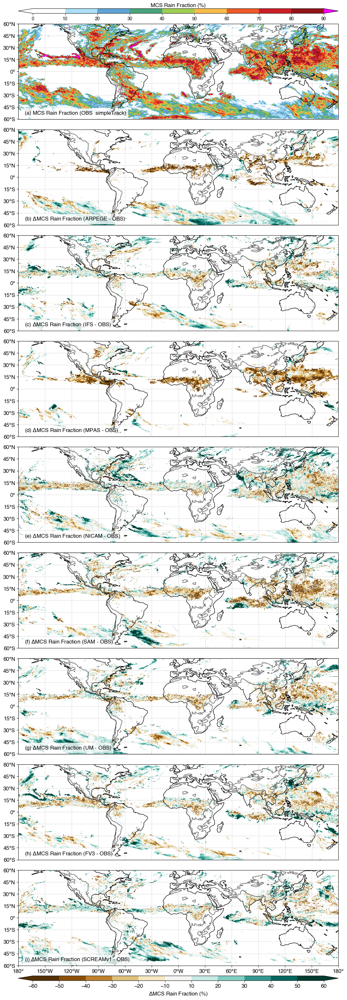

In [177]:
figwidth = 12
height_ratio_per_panel = 0.35 
ratio = height_ratio_per_panel * ds_simtrack.dims['source']
figsize = [figwidth,figwidth*ratio]
fontsize = 12
cb_fontsize = 10
varname1 = 'MCS Rain Fraction'
varname2 = '$\Delta$MCS Rain Fraction'
units = '%'

# Combine OBS & model differences
min_mcspcp_thresh = 1.0  # [mm/day]
data_dict = xr.concat([mcspcpfrac_obs_simtrack, mcspcpfrac_diff_simtrack.where(mcspcp_mod_simtrack > min_mcspcp_thresh)], dim='source')
lev1 = np.arange(0, 90.01, 10)
lev2 = np.arange(-60, 60.1, 10)
lev2 = np.delete(lev2, int((len(lev2)-1)/2))
cmap1 = generate_NCL_cmap('WhiteBlueGreenYellowRed')
cmap2 = 'BrBG'

nrows = len(name_map)
nmodel = nrows-1
titles = []
for ii in range(len(name_map)):
    key = list(name_map.keys())[ii]
    label = '('+chr(ord('a') + ii)+')'
    if key == 'obs': 
        titles.append(f'{label} {varname1} ({name_map[key]}  simpleTrack)')
    else:
        titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

levels = [lev1] + [lev2]*nmodel
cbticks = levels
cmaps = [cmap1] + [cmap2]*nmodel
oob_colors = [{'under':'white', 'over':'magenta'}] + [None]*nmodel
cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

figname = f'{figdir}globalmap_mcs_rainfrac_obs_diff_all_simpleTrack.png'
fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
                     figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, )

## Separate land vs. ocean plots

In [178]:
# Combine region names & model difference values to a dictionary
dict1 = {'obs': list(boxes.keys())}
dict_text_combine = {**dict1, **dict_mcspcp_o_pyflex}
# Make dictionary key with region names
dict_text_val = {}
for key, val in name_map.items():
    boxtext = dict_text_combine[key]
    dict_text_val[key] = dict(zip(boxes.keys(), boxtext))

# Make text type for each source
dict1 = {'obs': 'string'}
dict2 = {key: 'float' for key in dict_mcspcp_o_pyflex}
dict_text_type = {**dict1, **dict2}
# dict_text_type

dict_text_val['obs'] = {'Land': 'Tropics (Ocean)', 'Ocean': 'Tropics (Ocean)'}
print(dict_text_val)

{'obs': {'Land': 'Tropics (Ocean)', 'Ocean': 'Tropics (Ocean)'}, 'm1': {'Land': -52.742122650146484, 'Ocean': -52.742122650146484}, 'm2': {'Land': -13.782278060913086, 'Ocean': -13.782278060913086}, 'm3': {'Land': -49.1584358215332, 'Ocean': -49.1584358215332}, 'm4': {'Land': 15.245434761047363, 'Ocean': 15.245434761047363}, 'm5': {'Land': -7.256970405578613, 'Ocean': -7.256970405578613}, 'm6': {'Land': -10.997685432434082, 'Ocean': -10.997685432434082}, 'm7': {'Land': -9.138422012329102, 'Ocean': -9.138422012329102}, 'm8': {'Land': -8.215712547302246, 'Ocean': -8.215712547302246}}


In [179]:
# figwidth = 12
# height_ratio_per_panel = 0.35
# ratio = height_ratio_per_panel * ds_pyflex.dims['source']
# figsize = [figwidth,figwidth*ratio]
# fontsize = 12
# cb_fontsize = 10
# varname1 = 'MCS Rain'
# varname2 = '$\Delta$MCS Rain'
# units = 'mm day$^{-1}$'

# # Combine OBS & model differences
# data_dict = xr.concat([mcspcp_obs_pyflex.where(landmask >= ocean_thresh), mcspcp_diff_pyflex.where(landmask >= ocean_thresh)], dim='source')
# lev1 = [1,2,3,5,7,10,13,16,20,25]
# lev2 = [-20,-16,-12,-8,-4,4,8,12,16,20]
# cmap1 = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
# cmap2 = 'BrBG'

# nrows = len(name_map)
# nmodel = nrows-1
# titles = []
# for ii in range(len(name_map)):
#     key = list(name_map.keys())[ii]
#     label = '('+chr(ord('a') + ii)+')'
#     if key == 'obs': 
#         titles.append(f'{label} {varname1} ({name_map[key]}  PyFLEXTRKR)')
#     else:
#         titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

# levels = [lev1] + [lev2]*nmodel
# cbticks = levels
# cmaps = [cmap1] + [cmap2]*nmodel
# oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
# cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
# text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

# figname = f'{figdir}globalmap_mcs_rain_obs_diff_all_ocean_PyFLEXTRKR.png'

# # lon_obs.shape, lat_obs.shape, data_dict.sel(source='obs').shape
# fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                      figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                      boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

In [180]:
# # Combine region names & model difference values to a dictionary
# dict1 = {'obs': list(boxes.keys())}
# dict_text_combine = {**dict1, **dict_mcspcp_l_pyflex}
# # Make dictionary key with region names
# dict_text_val = {}
# for key, val in name_map.items():
#     boxtext = dict_text_combine[key]
#     dict_text_val[key] = dict(zip(boxes.keys(), boxtext))

# # Make text type for each source
# dict1 = {'obs': 'string'}
# dict2 = {key: 'float' for key in dict_mcspcp_l_pyflex}
# dict_text_type = {**dict1, **dict2}
# # dict_text_type

# dict_text_val['obs'] = {'Land': 'Tropics (Land)', 'Ocean': 'Tropics (Land)'}
# dict_text_val
# # print(dict_text_val)

In [181]:
# figwidth = 12
# height_ratio_per_panel = 0.35
# ratio = height_ratio_per_panel * ds_pyflex.dims['source']
# figsize = [figwidth,figwidth*ratio]
# fontsize = 12
# cb_fontsize = 10
# varname1 = 'MCS Rain'
# varname2 = '$\Delta$MCS Rain'
# units = 'mm day$^{-1}$'

# # Combine OBS & model differences
# data_dict = xr.concat([mcspcp_obs_pyflex.where(landmask <= land_thresh), mcspcp_diff_pyflex.where(landmask <= land_thresh)], dim='source')
# lev1 = [1,2,3,5,7,10,13,16,20,25]
# lev2 = [-20,-16,-12,-8,-4,4,8,12,16,20]
# cmap1 = generate_NCL_cmap('precip3_16lev', cont_param_ws='sRGB')
# cmap2 = 'BrBG'

# nrows = len(name_map)
# nmodel = nrows-1
# titles = []
# for ii in range(len(name_map)):
#     key = list(name_map.keys())[ii]
#     label = '('+chr(ord('a') + ii)+')'
#     if key == 'obs': 
#         titles.append(f'{label} {varname1} ({name_map[key]}  PyFLEXTRKR)')
#     else:
#         titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

# levels = [lev1] + [lev2]*nmodel
# cbticks = levels
# cmaps = [cmap1] + [cmap2]*nmodel
# oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
# cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
# text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

# figname = f'{figdir}globalmap_mcs_rain_obs_diff_all_land_PyFLEXTRKR.png'

# fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                      figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                      boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

In [182]:
# # Combine region names & model difference values to a dictionary
# dict1 = {'obs': list(boxes.keys())}
# dict_text_combine = {**dict1, **dict_mcspcpfreq_o_pyflex}
# # Make dictionary key with region names
# dict_text_val = {}
# for key, val in name_map.items():
#     boxtext = dict_text_combine[key]
#     dict_text_val[key] = dict(zip(boxes.keys(), boxtext))

# # Make text type for each source
# dict1 = {'obs': 'string'}
# dict2 = {key: 'float' for key in dict_mcspcpfreq_o_pyflex}
# dict_text_type = {**dict1, **dict2}

# dict_text_val['obs'] = {'Land': 'Tropics (Ocean)', 'Ocean': 'Tropics (Ocean)'}
# dict_text_val

In [183]:
# figwidth = 12
# height_ratio_per_panel = 0.35 
# ratio = height_ratio_per_panel * ds_pyflex.dims['source']
# figsize = [figwidth,figwidth*ratio]
# fontsize = 12
# cb_fontsize = 10
# varname1 = 'MCS Rain Freq'
# varname2 = '$\Delta$MCS Rain Freq'
# units = '%'

# # Combine OBS & model differences
# data_dict = xr.concat([mcspcpfreq_obs_pyflex.where(landmask >= ocean_thresh), mcspcpfreq_diff_pyflex.where(landmask >= ocean_thresh)], dim='source')
# lev1 = [0.2,0.5,1,2,2.5,3,5,7,10,13,16,20]
# lev2 = np.arange(-10, 10.1, 2)
# lev2 = np.delete(lev2, int((len(lev2)-1)/2))
# cmap1 = cc.cm.CET_L19
# cmap2 = 'BrBG'

# nrows = len(name_map)
# nmodel = nrows-1
# titles = []
# for ii in range(len(name_map)):
#     key = list(name_map.keys())[ii]
#     label = '('+chr(ord('a') + ii)+')'
#     if key == 'obs': 
#         titles.append(f'{label} {varname1} ({name_map[key]}  PyFLEXTRKR)')
#     else:
#         titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

# levels = [lev1] + [lev2]*nmodel
# cbticks = levels
# cmaps = [cmap1] + [cmap2]*nmodel
# oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
# cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
# text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

# figname = f'{figdir}globalmap_mcs_rainfreq_obs_diff_all_ocean_PyFLEXTRKR.png'
# fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                      figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                      boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

In [184]:
# # Combine region names & model difference values to a dictionary
# dict1 = {'obs': list(boxes.keys())}
# dict_text_combine = {**dict1, **dict_mcspcpfreq_l_pyflex}
# # Make dictionary key with region names
# dict_text_val = {}
# for key, val in name_map.items():
#     boxtext = dict_text_combine[key]
#     dict_text_val[key] = dict(zip(boxes.keys(), boxtext))

# # Make text type for each source
# dict1 = {'obs': 'string'}
# dict2 = {key: 'float' for key in dict_mcspcpfreq_l_pyflex}
# dict_text_type = {**dict1, **dict2}

# dict_text_val['obs'] = {'Land': 'Tropics (Land)', 'Ocean': 'Tropics (Land)'}
# dict_text_val

In [185]:
# figwidth = 12
# height_ratio_per_panel = 0.35 
# ratio = height_ratio_per_panel * ds_pyflex.dims['source']
# figsize = [figwidth,figwidth*ratio]
# fontsize = 12
# cb_fontsize = 10
# varname1 = 'MCS Rain Freq'
# varname2 = '$\Delta$MCS Rain Freq'
# units = '%'

# # Combine OBS & model differences
# data_dict = xr.concat([mcspcpfreq_obs_pyflex.where(landmask <= land_thresh), mcspcpfreq_diff_pyflex.where(landmask <= land_thresh)], dim='source')
# lev1 = [0.2,0.5,1,2,2.5,3,5,7,10,13,16,20]
# lev2 = np.arange(-10, 10.1, 2)
# lev2 = np.delete(lev2, int((len(lev2)-1)/2))
# cmap1 = cc.cm.CET_L19
# cmap2 = 'BrBG'

# nrows = len(name_map)
# nmodel = nrows-1
# titles = []
# for ii in range(len(name_map)):
#     key = list(name_map.keys())[ii]
#     label = '('+chr(ord('a') + ii)+')'
#     if key == 'obs': 
#         titles.append(f'{label} {varname1} ({name_map[key]}  PyFLEXTRKR)')
#     else:
#         titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

# levels = [lev1] + [lev2]*nmodel
# cbticks = levels
# cmaps = [cmap1] + [cmap2]*nmodel
# oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
# cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
# text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

# figname = f'{figdir}globalmap_mcs_rainfreq_obs_diff_all_land_PyFLEXTRKR.png'
# fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                      figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                      boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

In [186]:
# # Combine region names & model difference values to a dictionary
# dict1 = {'obs': list(boxes.keys())}
# dict_text_combine = {**dict1, **dict_mcscloudfreq_o_pyflex}
# # Make dictionary key with region names
# dict_text_val = {}
# for key, val in name_map.items():
#     boxtext = dict_text_combine[key]
#     dict_text_val[key] = dict(zip(boxes.keys(), boxtext))

# # Make text type for each source
# dict1 = {'obs': 'string'}
# dict2 = {key: 'float' for key in dict_mcscloudfreq_o_pyflex}
# dict_text_type = {**dict1, **dict2}

# dict_text_val['obs'] = {'Land': 'Tropics (Ocean)', 'Ocean': 'Tropics (Ocean)'}
# dict_text_val

In [187]:
# figwidth = 12
# height_ratio_per_panel = 0.35 
# ratio = height_ratio_per_panel * ds_pyflex.dims['source']
# figsize = [figwidth,figwidth*ratio]
# fontsize = 12
# cb_fontsize = 10
# varname1 = 'MCS Cloud Freq'
# varname2 = '$\Delta$MCS Cloud Freq'
# units = '%'

# # Combine OBS & model differences
# data_dict = xr.concat([mcscloudfreq_obs_pyflex.where(landmask >= ocean_thresh), mcscloudfreq_diff_pyflex.where(landmask >= ocean_thresh)], dim='source')
# lev1 = [1,2,3,5,7,10,13,16,20,25,30,40]
# lev2 = np.arange(-20, 20.1, 4)
# lev2 = np.delete(lev2, int((len(lev2)-1)/2))
# cmap1 = cc.cm.CET_L19
# cmap2 = 'BrBG'

# nrows = len(name_map)
# nmodel = nrows-1
# titles = []
# for ii in range(len(name_map)):
#     key = list(name_map.keys())[ii]
#     label = '('+chr(ord('a') + ii)+')'
#     if key == 'obs': 
#         titles.append(f'{label} {varname1} ({name_map[key]}  PyFLEXTRKR)')
#     else:
#         titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

# levels = [lev1] + [lev2]*nmodel
# cbticks = levels
# cmaps = [cmap1] + [cmap2]*nmodel
# oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
# cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
# text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

# figname = f'{figdir}globalmap_mcs_cloudfreq_obs_diff_all_ocean_PyFLEXTRKR.png'
# fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                      figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                      boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

In [188]:
# # Combine region names & model difference values to a dictionary
# dict1 = {'obs': list(boxes.keys())}
# dict_text_combine = {**dict1, **dict_mcscloudfreq_l_pyflex}
# # Make dictionary key with region names
# dict_text_val = {}
# for key, val in name_map.items():
#     boxtext = dict_text_combine[key]
#     dict_text_val[key] = dict(zip(boxes.keys(), boxtext))

# # Make text type for each source
# dict1 = {'obs': 'string'}
# dict2 = {key: 'float' for key in dict_mcscloudfreq_l_pyflex}
# dict_text_type = {**dict1, **dict2}

# dict_text_val['obs'] = {'Land': 'Tropics (Land)', 'Ocean': 'Tropics (Land)'}
# dict_text_val

In [189]:
# figwidth = 12
# height_ratio_per_panel = 0.35 
# ratio = height_ratio_per_panel * ds_pyflex.dims['source']
# figsize = [figwidth,figwidth*ratio]
# fontsize = 12
# cb_fontsize = 10
# varname1 = 'MCS Cloud Freq'
# varname2 = '$\Delta$MCS Cloud Freq'
# units = '%'

# # Combine OBS & model differences
# data_dict = xr.concat([mcscloudfreq_obs_pyflex.where(landmask <= land_thresh), mcscloudfreq_diff_pyflex.where(landmask <= land_thresh)], dim='source')
# lev1 = [1,2,3,5,7,10,13,16,20,25,30,40]
# lev2 = np.arange(-20, 20.1, 4)
# lev2 = np.delete(lev2, int((len(lev2)-1)/2))
# cmap1 = cc.cm.CET_L19
# cmap2 = 'BrBG'

# nrows = len(name_map)
# nmodel = nrows-1
# titles = []
# for ii in range(len(name_map)):
#     key = list(name_map.keys())[ii]
#     label = '('+chr(ord('a') + ii)+')'
#     if key == 'obs': 
#         titles.append(f'{label} {varname1} ({name_map[key]}  PyFLEXTRKR)')
#     else:
#         titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

# levels = [lev1] + [lev2]*nmodel
# cbticks = levels
# cmaps = [cmap1] + [cmap2]*nmodel
# oob_colors = [{'under':'white', 'over':'firebrick'}] + [None]*nmodel
# cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
# text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

# figname = f'{figdir}globalmap_mcs_cloudfreq_obs_diff_all_land_PyFLEXTRKR.png'
# fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                      figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                      boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

In [190]:
# # Combine region names & model difference values to a dictionary
# dict1 = {'obs': list(boxes.keys())}
# dict_text_combine = {**dict1, **dict_mcspcpfrac_o_pyflex}
# # Make dictionary key with region names
# dict_text_val = {}
# for key, val in name_map.items():
#     boxtext = dict_text_combine[key]
#     dict_text_val[key] = dict(zip(boxes.keys(), boxtext))

# # Make text type for each source
# dict1 = {'obs': 'string'}
# dict2 = {key: 'float' for key in dict_mcspcpfrac_o_pyflex}
# dict_text_type = {**dict1, **dict2}

# dict_text_val['obs'] = {'Land': 'Tropics (Ocean)', 'Ocean': 'Tropics (Ocean)'}
# dict_text_val

In [191]:
# min_mcspcp_thresh = 1.0
# mcspcpfrac_diff.where(mcspcp_mod > min_mcspcp_thresh).where(landmask >= ocean_thresh)

In [192]:
# figwidth = 12
# height_ratio_per_panel = 0.35 
# ratio = height_ratio_per_panel * ds_pyflex.dims['source']
# figsize = [figwidth,figwidth*ratio]
# fontsize = 12
# cb_fontsize = 10
# varname1 = 'MCS Rain Fraction'
# varname2 = '$\Delta$MCS Rain Fraction'
# units = '%'

# # Combine OBS & model differences
# min_mcspcp_thresh = 1.0  # [mm/day]
# data_dict = xr.concat([mcspcpfrac_obs_pyflex.where(landmask >= ocean_thresh), mcspcpfrac_diff_pyflex.where(mcspcp_mod_pyflex > min_mcspcp_thresh).where(landmask >= ocean_thresh)], dim='source')
# lev1 = np.arange(0, 90.01, 10)
# lev2 = np.arange(-60, 60.1, 10)
# lev2 = np.delete(lev2, int((len(lev2)-1)/2))
# cmap1 = generate_NCL_cmap('WhiteBlueGreenYellowRed')
# cmap2 = 'BrBG'

# nrows = len(name_map)
# nmodel = nrows-1
# titles = []
# for ii in range(len(name_map)):
#     key = list(name_map.keys())[ii]
#     label = '('+chr(ord('a') + ii)+')'
#     if key == 'obs': 
#         titles.append(f'{label} {varname1} ({name_map[key]})')
#     else:
#         titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

# levels = [lev1] + [lev2]*nmodel
# cbticks = levels
# cmaps = [cmap1] + [cmap2]*nmodel
# oob_colors = [{'under':'white', 'over':'magenta'}] + [None]*nmodel
# cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
# text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

# figname = f'{figdir}globalmap_mcs_rainfrac_obs_diff_all_ocean_PyFLEXTRKR.png'
# fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                      figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                      boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)

In [193]:
# # Combine region names & model difference values to a dictionary
# dict1 = {'obs': list(boxes.keys())}
# dict_text_combine = {**dict1, **dict_mcspcpfrac_l_pyflex}
# # Make dictionary key with region names
# dict_text_val = {}
# for key, val in name_map.items():
#     boxtext = dict_text_combine[key]
#     dict_text_val[key] = dict(zip(boxes.keys(), boxtext))

# # Make text type for each source
# dict1 = {'obs': 'string'}
# dict2 = {key: 'float' for key in dict_mcspcpfrac_l_pyflex}
# dict_text_type = {**dict1, **dict2}

# dict_text_val['obs'] = {'Land': 'Tropics (Land)', 'Ocean': 'Tropics (Land)'}
# dict_text_val

In [194]:
# figwidth = 12
# height_ratio_per_panel = 0.35 
# ratio = height_ratio_per_panel * ds_pyflex.dims['source']
# figsize = [figwidth,figwidth*ratio]
# fontsize = 12
# cb_fontsize = 10
# varname1 = 'MCS Rain Fraction'
# varname2 = '$\Delta$MCS Rain Fraction'
# units = '%'

# # Combine OBS & model differences
# min_mcspcp_thresh = 1.0  # [mm/day]
# data_dict = xr.concat([mcspcpfrac_obs_pyflex.where(landmask <= land_thresh), mcspcpfrac_diff_pyflex.where(mcspcp_mod_pyflex > min_mcspcp_thresh).where(landmask <= land_thresh)], dim='source')
# lev1 = np.arange(0, 90.01, 10)
# lev2 = np.arange(-60, 60.1, 10)
# lev2 = np.delete(lev2, int((len(lev2)-1)/2))
# cmap1 = generate_NCL_cmap('WhiteBlueGreenYellowRed')
# cmap2 = 'BrBG'

# nrows = len(name_map)
# nmodel = nrows-1
# titles = []
# for ii in range(len(name_map)):
#     key = list(name_map.keys())[ii]
#     label = '('+chr(ord('a') + ii)+')'
#     if key == 'obs': 
#         titles.append(f'{label} {varname1} ({name_map[key]})')
#     else:
#         titles.append(f'{label} {varname2} ({name_map[key]} - OBS)')

# levels = [lev1] + [lev2]*nmodel
# cbticks = levels
# cmaps = [cmap1] + [cmap2]*nmodel
# oob_colors = [{'under':'white', 'over':'magenta'}] + [None]*nmodel
# cblabels = [f'{varname1} ({units})', f'{varname2} ({units})']
# text_colors = {'pos':'teal', 'neg':'darkgoldenrod'}

# figname = f'{figdir}globalmap_mcs_rainfrac_obs_diff_all_land_PyFLEXTRKR.png'
# fig = plot_maps_nrow(nrows, data_dict, lon_lm, lat_lm, titles, levels, cmaps, cblabels, cbticks, figname, 
#                      figsize=figsize, fontsize=fontsize, cb_fontsize=cb_fontsize, contourf=False, oob_colors=oob_colors, 
#                      boxes=boxes, boxtextloc=text_loc, dict_text_type=dict_text_type, dict_text_val=dict_text_val, text_colors=text_colors)